In [1]:
import numpy as np
import tensorflow as tf
import os
import sys
import cv2
from tensorflow.keras.models import load_model
from glob import glob
import random
from tensorflow.keras.utils import Sequence
from random import randrange
import json
import math
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.metrics import mean_absolute_error as mae
from sklearn.metrics import mean_squared_error as mse

# Get List of Test Images

In [2]:
oModelPath = "D:\\ISS_project\\Model\\best\\Headpose_customARC_ZoomShiftNoise.hdf5"
#input path for full image
oTestFullImgPath = "D:\\ISS_project\\dataset\\prepared_data\\test"
oOutDirPath = "D:\\ISS_project\\dataset\\prepared_data\\display_image\\"
def list_image_files(oInputPath):
    oImageFileNames = glob(oInputPath + "\\*.png")
    return oImageFileNames

oListTestImgFiles =  list_image_files(oTestFullImgPath)

# Load Headpose Model

In [3]:
def load_hp_model(oModelPath):
    oHpModel = load_model(oModelPath)
    oHpModel.summary()
    return oHpModel
load_hp_model(oModelPath)

Model: "model_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_2 (InputLayer)         [(None, 100, 100, 3)]     0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 48, 48, 24)        1824      
_________________________________________________________________
batch_normalization_4 (Batch (None, 48, 48, 24)        96        
_________________________________________________________________
activation_6 (Activation)    (None, 48, 48, 24)        0         
_________________________________________________________________
dropout_5 (Dropout)          (None, 48, 48, 24)        0         
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 23, 23, 48)        10416     
_________________________________________________________________
batch_normalization_5 (Batch (None, 23, 23, 48)        192 

# Headpose Inference Function

In [4]:
def headpose_inference(oModel,oImage):
    oImage = oImage/255.0
    oHpAngles = oModel.predict(oImage)
    #convert radian to degree
    #print(oHpAngles[0].shape)
    oHpAngles = oHpAngles[0] * 180/np.pi
    return oHpAngles

# Test the Model on Test data

In [5]:
oPitchPrediction = []
oPitchGroundtruth = []
oYawPrediction = []
oYawGroundtruth = []
oRollPrediction = []
oRollGroundtruth = []
#load headpose model
oModel = load_hp_model(oModelPath)

for oFileName in oListTestImgFiles:
    #read image and groundtruth
    oImage = cv2.imread(oFileName)
    oImage = cv2.cvtColor(oImage, cv2.COLOR_BGR2RGB)
    oImage = np.reshape(oImage,(-1,100,100,3))
    #getlabel file name
    oImageName = oFileName.split("\\")[-1]
    oImageName = oImageName.split(".png")[0]
    oLabelPath = os.path.join(oTestFullImgPath,oImageName+"_angles.txt")
    oLabel = []
    with open(oLabelPath, 'r') as f:
        oLabel = json.loads(f.read())
    #do inference
    oPredictedAngles = headpose_inference(oModel,oImage)
    #append values to final list
    oPitchPrediction.append(oPredictedAngles[0])
    #inverting pitch angle for biwi
    oPitchGroundtruth.append(oLabel[0])
    oYawPrediction.append(oPredictedAngles[1])
    oYawGroundtruth.append(oLabel[1])
    oRollPrediction.append(oPredictedAngles[2])
    #inverting roll angle for biwi
    oRollGroundtruth.append(oLabel[2])
    
#calculate MSE RMSE AND MAE
#convert to np array
oPitchPrediction = np.array(oPitchPrediction)
oPitchGroundtruth = np.array(oPitchGroundtruth)
oYawPrediction = np.array(oYawPrediction)
oYawGroundtruth = np.array(oYawGroundtruth)
oRollPrediction = np.array(oRollPrediction)
oRollGroundtruth = np.array(oRollGroundtruth)

#Mean Square Error
oPitchMSE =  mse(oPitchGroundtruth,oPitchPrediction)
oYawMSE = mse(oYawGroundtruth,oYawPrediction)
oRollMSE = mse(oRollGroundtruth,oRollPrediction)
print("Mean Square Error Pitch : ",oPitchMSE)
print("Mean Square Error Yaw   : ",oYawMSE)
print("Mean Square Error Roll  : ",oRollMSE)


#Root Mean Square Error
oPitchRMSE = math.sqrt(oPitchMSE)
oYawRMSE = math.sqrt(oYawMSE)
oRollRMSE = math.sqrt(oRollMSE)
print("Root Mean Square Error Pitch : ",oPitchRMSE)
print("Root Mean Square Error Yaw   : ",oYawRMSE)
print("Root Mean Square Error Roll  : ",oRollRMSE)

#Mean Average Error
oPitchMAE = mae(oPitchGroundtruth,oPitchPrediction)
oYawMAE = mae(oYawGroundtruth,oYawPrediction)
oRollMAE = mae(oRollGroundtruth,oRollPrediction)

print("Mean Absolute Error Pitch : ",oPitchMAE)
print("Mean Absolute Error Yaw   : ",oYawMAE)
print("Mean Absolute Error Roll  : ",oRollMAE)

Model: "model_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_2 (InputLayer)         [(None, 100, 100, 3)]     0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 48, 48, 24)        1824      
_________________________________________________________________
batch_normalization_4 (Batch (None, 48, 48, 24)        96        
_________________________________________________________________
activation_6 (Activation)    (None, 48, 48, 24)        0         
_________________________________________________________________
dropout_5 (Dropout)          (None, 48, 48, 24)        0         
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 23, 23, 48)        10416     
_________________________________________________________________
batch_normalization_5 (Batch (None, 23, 23, 48)        192 

# headpose Prediction Display

In [5]:
# Calculates Rotation Matrix given euler angles.
def eulerAnglesToRotationMatrix(theta) :
    R_x = np.identity(3)
    R_y = np.identity(3)
    R_z = np.identity(3)
     
    R_x = np.array([[1,0,0],
                    [0,math.cos(theta[0]), -math.sin(theta[0]) ],
                    [0,math.sin(theta[0]), math.cos(theta[0])]
                    ])
         
         
                     
    R_y = np.array([[math.cos(theta[1]),0,math.sin(theta[1])],
                    [0,1,0],
                    [-math.sin(theta[1]),0,math.cos(theta[1])]
                    ])
                 
    R_z = np.array([[math.cos(theta[2]),-math.sin(theta[2]),0],
                    [math.sin(theta[2]),math.cos(theta[2]),0],
                    [0,0,1]
                    ])
                     
                     
    R = np.dot(R_z, np.dot( R_y, R_x ))
 
    return R

#display headpose
def displayHeadpose(oImgNp, oAnglesNp,oOffset = 0):
    oHeadposeRotationMat = eulerAnglesToRotationMatrix(oAnglesNp)
    oPointsNp = np.array([(30, 0 ,0),
                         (0, 30, 0),
                         (0, 0, 30)])
    oPointsNp = np.dot(oHeadposeRotationMat, oPointsNp)
    oOriginT = (int(oImgNp.shape[1]/2 + oOffset), int(oImgNp.shape[0]/2))
    oLineXT = (int(oOriginT[0] - oPointsNp[0,0]), int(oOriginT[1] - oPointsNp[1,0]))
    oLineYT = (int(oOriginT[0] - oPointsNp[0,1]), int(oOriginT[1] - oPointsNp[1,1]))
    oLineZT = (int(oOriginT[0] - oPointsNp[0,2]), int(oOriginT[1] - oPointsNp[1,2]))
    cv2.line(oImgNp, oOriginT, oLineXT, (0,0,255),3)
    cv2.line(oImgNp, oOriginT, oLineYT, (0,255,0),3)
    cv2.line(oImgNp, oOriginT, oLineZT, (255,0,0),3)
    return oImgNp

Model: "model_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_2 (InputLayer)         [(None, 100, 100, 3)]     0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 48, 48, 24)        1824      
_________________________________________________________________
batch_normalization_4 (Batch (None, 48, 48, 24)        96        
_________________________________________________________________
activation_6 (Activation)    (None, 48, 48, 24)        0         
_________________________________________________________________
dropout_5 (Dropout)          (None, 48, 48, 24)        0         
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 23, 23, 48)        10416     
_________________________________________________________________
batch_normalization_5 (Batch (None, 23, 23, 48)        192 

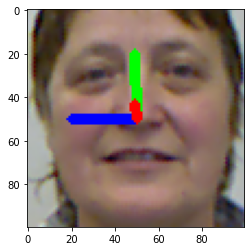

(100, 100, 3)
oPredictedAngles : [-12.3602495   0.5424612  -0.5290907]
oLabel : [-7.57873, 3.37903, -2.40848]


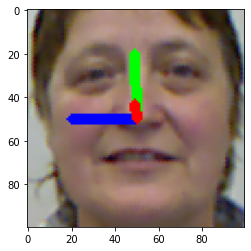

(100, 100, 3)
oPredictedAngles : [-12.399996     0.5329343   -0.54378927]
oLabel : [-7.5918, 3.51511, -2.3776]


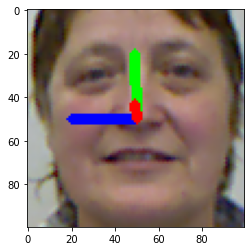

(100, 100, 3)
oPredictedAngles : [-12.55991      0.49823484  -0.52563804]
oLabel : [-7.86329, 3.11347, -2.56942]


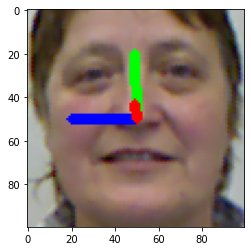

(100, 100, 3)
oPredictedAngles : [-12.044495     0.6242898   -0.49575087]
oLabel : [-7.69931, 3.73332, -2.75829]


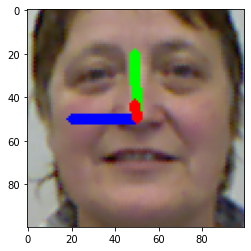

(100, 100, 3)
oPredictedAngles : [-12.275658     0.56605095  -0.5224108 ]
oLabel : [-7.67892, 3.3441, -2.30131]


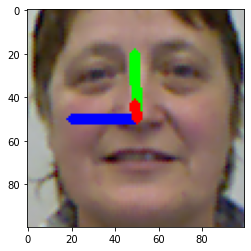

(100, 100, 3)
oPredictedAngles : [-12.256748    0.5659139  -0.5053524]
oLabel : [-7.83259, 3.45799, -2.6665]


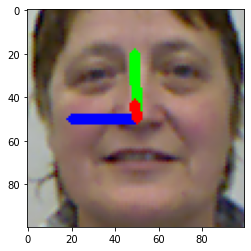

(100, 100, 3)
oPredictedAngles : [-12.588483     0.49118015  -0.5340033 ]
oLabel : [-7.62557, 3.27561, -2.64609]


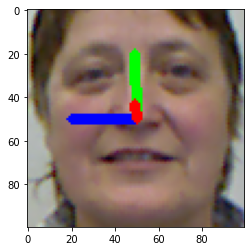

(100, 100, 3)
oPredictedAngles : [-12.27838      0.55724895  -0.5444928 ]
oLabel : [-7.7247, 3.49727, -2.44437]


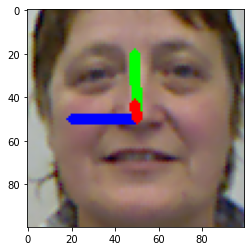

(100, 100, 3)
oPredictedAngles : [-12.09515      0.60919553  -0.5055761 ]
oLabel : [-7.63133, 3.75019, -2.20153]


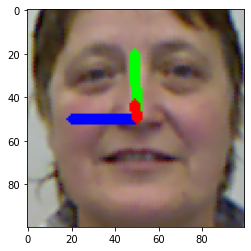

(100, 100, 3)
oPredictedAngles : [-12.28374     0.5714434  -0.5173513]
oLabel : [-7.76471, 3.73713, -2.57619]


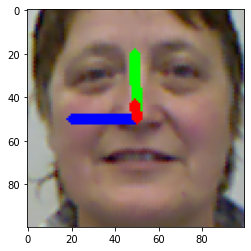

(100, 100, 3)
oPredictedAngles : [-12.367833    0.5687395  -0.5416173]
oLabel : [-7.98672, 3.63462, -2.46785]


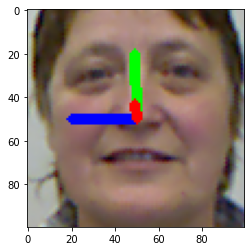

(100, 100, 3)
oPredictedAngles : [-12.175908     0.71767217  -0.5340119 ]
oLabel : [-8.10698, 4.34802, -2.591]


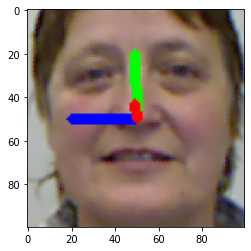

(100, 100, 3)
oPredictedAngles : [-12.5884      0.8909349  -0.6496657]
oLabel : [-8.2925, 5.35579, -2.27166]


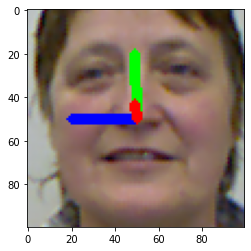

(100, 100, 3)
oPredictedAngles : [-13.282094    4.1473947  -2.293127 ]
oLabel : [-8.5743, 6.75482, -2.25844]


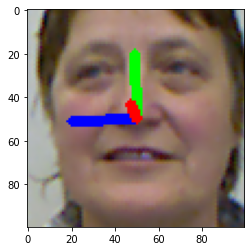

(100, 100, 3)
oPredictedAngles : [-12.352839    4.934089   -2.2768917]
oLabel : [-9.21321, 8.12181, -2.35837]


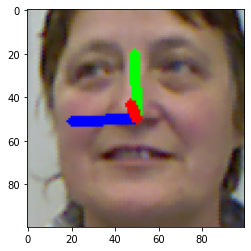

(100, 100, 3)
oPredictedAngles : [-14.107796    5.6307077  -2.4359736]
oLabel : [-9.74562, 9.42532, -1.478]


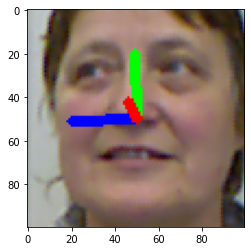

(100, 100, 3)
oPredictedAngles : [-15.557166    6.8552365  -1.944019 ]
oLabel : [-10.5726, 11.9721, -1.17192]


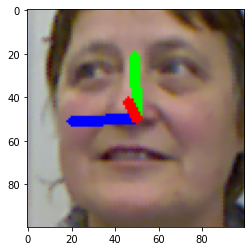

(100, 100, 3)
oPredictedAngles : [-14.063463    5.9045224  -2.4564574]
oLabel : [-12.2491, 14.1744, -1.3101]


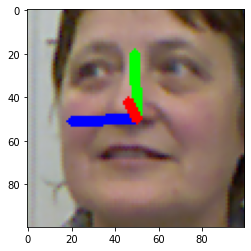

(100, 100, 3)
oPredictedAngles : [-13.10298     8.3029     -1.3506907]
oLabel : [-14.8615, 18.2766, -1.18328]


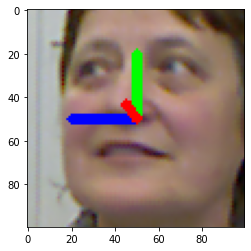

(100, 100, 3)
oPredictedAngles : [-16.23979     8.022799   -1.4406699]
oLabel : [-17.2984, 24.8009, 0.0266631]


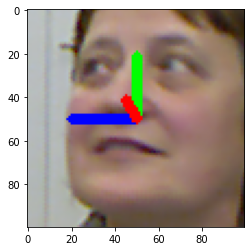

(100, 100, 3)
oPredictedAngles : [-20.057627   15.659514   -1.6670189]
oLabel : [-18.7442, 32.5936, 0.199069]


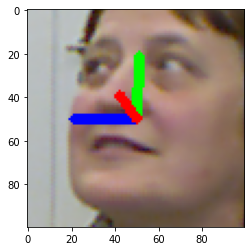

(100, 100, 3)
oPredictedAngles : [-15.376252    17.301615    -0.89375454]
oLabel : [-20.0388, 39.7344, -0.761631]


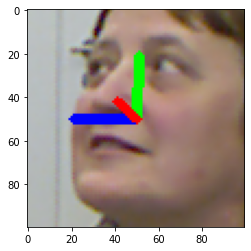

(100, 100, 3)
oPredictedAngles : [-15.503524    17.427372    -0.13911936]
oLabel : [-20.9114, 44.699, -1.80841]


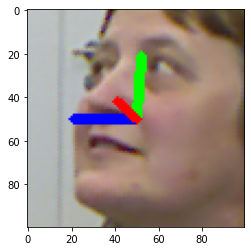

(100, 100, 3)
oPredictedAngles : [-19.416704   25.158508   -0.5072973]
oLabel : [-22.1452, 48.0562, -2.95376]


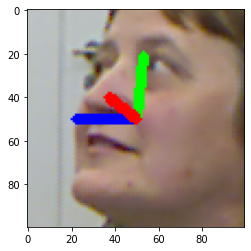

(100, 100, 3)
oPredictedAngles : [-19.76351     26.233334    -0.45472193]
oLabel : [-23.0723, 48.8705, -3.54565]


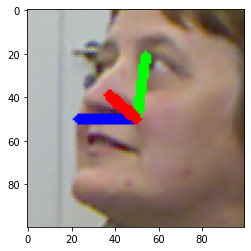

(100, 100, 3)
oPredictedAngles : [-19.883621    26.255217    -0.49337053]
oLabel : [-22.7848, 48.9663, -2.46098]


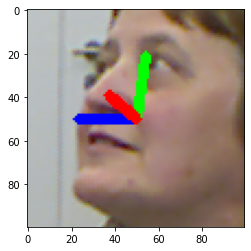

(100, 100, 3)
oPredictedAngles : [-19.666262   25.369478   -0.5757426]
oLabel : [-23.4246, 47.5623, -2.49976]


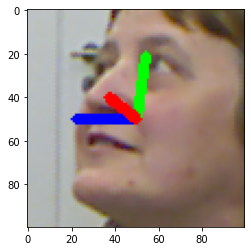

(100, 100, 3)
oPredictedAngles : [-18.92666    21.848175   -0.7839472]
oLabel : [-25.1071, 46.077, -4.28079]


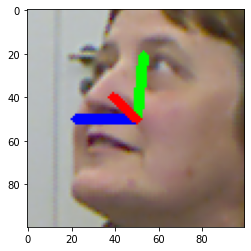

(100, 100, 3)
oPredictedAngles : [-19.378082    23.434       -0.69631934]
oLabel : [-26.0913, 44.7849, -3.97419]


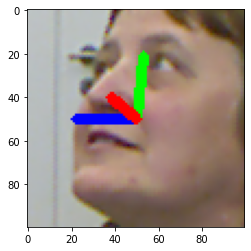

(100, 100, 3)
oPredictedAngles : [-18.874722    21.169815    -0.48597687]
oLabel : [-27.3633, 44.6352, -4.58165]


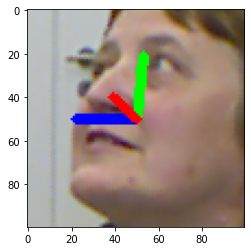

(100, 100, 3)
oPredictedAngles : [-18.805193   20.547712   -0.7038377]
oLabel : [-28.0125, 45.7347, -3.0561]


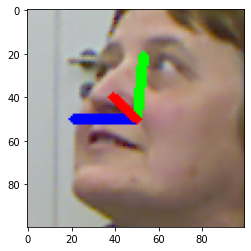

(100, 100, 3)
oPredictedAngles : [-19.879679    23.625618     0.21523596]
oLabel : [-29.405, 46.1371, -4.19131]


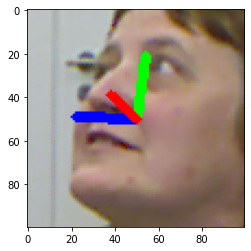

(100, 100, 3)
oPredictedAngles : [-19.950682   25.461123   -0.1292412]
oLabel : [-30.2255, 45.9166, -5.66057]


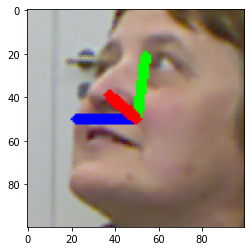

(100, 100, 3)
oPredictedAngles : [-20.1263      24.926504     0.17828465]
oLabel : [-30.9484, 46.96, -5.56538]


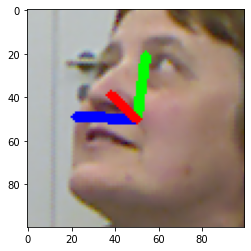

(100, 100, 3)
oPredictedAngles : [-20.088314   25.824064   -0.0448969]
oLabel : [-31.2819, 46.7866, -5.56612]


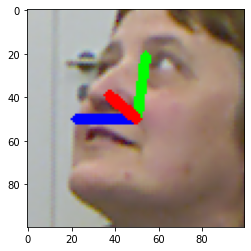

(100, 100, 3)
oPredictedAngles : [-20.045143    25.781006    -0.29992422]
oLabel : [-31.5976, 45.889, -6.16243]


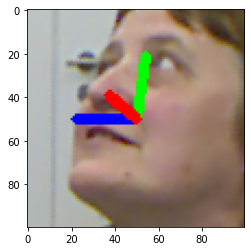

(100, 100, 3)
oPredictedAngles : [-20.250586    25.662779     0.02889134]
oLabel : [-31.9803, 46.2643, -5.03281]


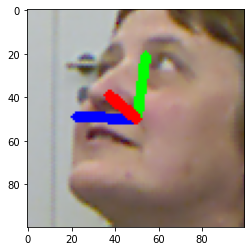

(100, 100, 3)
oPredictedAngles : [-20.484571    25.680058     0.04964828]
oLabel : [-33.0816, 45.9461, -5.18546]


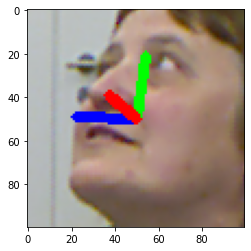

(100, 100, 3)
oPredictedAngles : [-20.236067    25.197346    -0.12100399]
oLabel : [-33.9525, 45.0508, -6.01137]


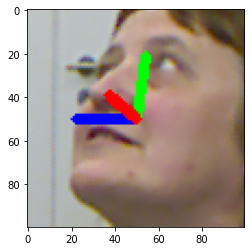

(100, 100, 3)
oPredictedAngles : [-20.603487    25.810371    -0.29614028]
oLabel : [-34.2393, 43.782, -6.28854]


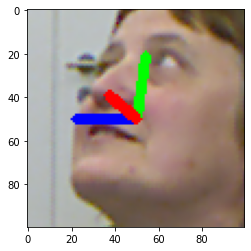

(100, 100, 3)
oPredictedAngles : [-20.047903  20.680328  -0.790453]
oLabel : [-35.679, 42.6412, -7.27523]


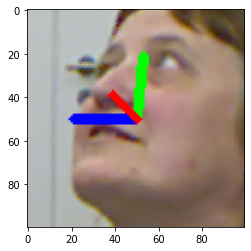

(100, 100, 3)
oPredictedAngles : [-21.991295    25.068514     0.29628637]
oLabel : [-35.6583, 41.4551, -7.96614]


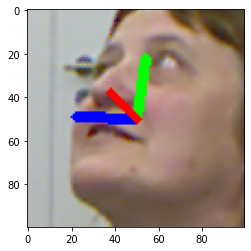

(100, 100, 3)
oPredictedAngles : [-25.461544   23.716799    0.1268021]
oLabel : [-36.0696, 40.9572, -7.28993]


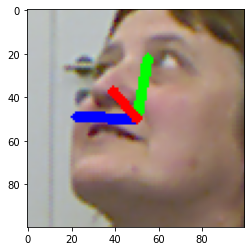

(100, 100, 3)
oPredictedAngles : [-24.64218   17.721645  -0.714894]
oLabel : [-35.6492, 40.0576, -6.74364]


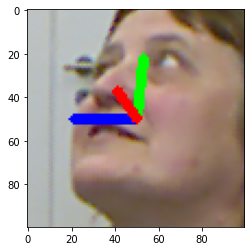

(100, 100, 3)
oPredictedAngles : [-23.511332   15.035454   -0.6150794]
oLabel : [-35.5299, 39.5576, -6.45139]


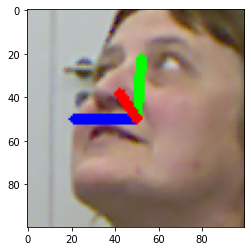

(100, 100, 3)
oPredictedAngles : [-23.423136   15.276385   -1.2993976]
oLabel : [-35.7108, 38.9771, -6.33392]


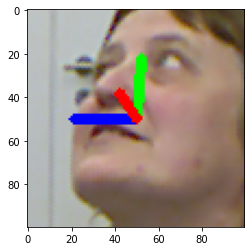

(100, 100, 3)
oPredictedAngles : [-22.746479   15.376311   -1.4037356]
oLabel : [-35.6928, 37.6631, -7.05586]


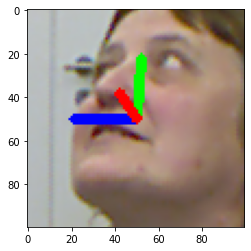

(100, 100, 3)
oPredictedAngles : [-23.48768     14.832061    -0.09224036]
oLabel : [-35.4787, 37.591, -6.33892]


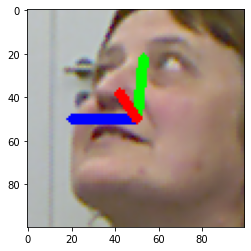

(100, 100, 3)
oPredictedAngles : [-24.053442    14.766949    -0.09363542]
oLabel : [-35.3949, 37.4799, -6.02445]


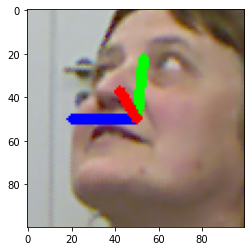

(100, 100, 3)
oPredictedAngles : [-23.97002    15.080464   -0.9411611]
oLabel : [-35.9052, 36.0723, -7.50007]


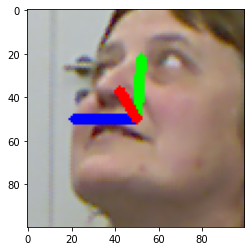

(100, 100, 3)
oPredictedAngles : [-25.992464   14.247956    0.7964782]
oLabel : [-35.5746, 35.9092, -6.42938]


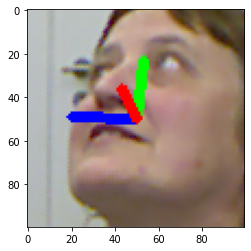

(100, 100, 3)
oPredictedAngles : [-25.304413   14.299715    0.8386649]
oLabel : [-35.1138, 35.3358, -6.35422]


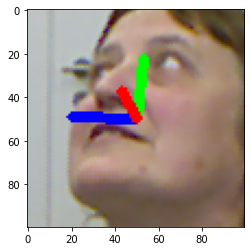

(100, 100, 3)
oPredictedAngles : [-24.519526    14.689215     0.02818954]
oLabel : [-35.6068, 34.9422, -6.3025]


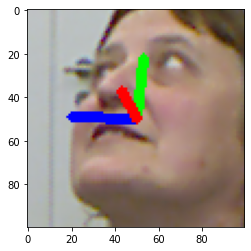

(100, 100, 3)
oPredictedAngles : [-23.9888      14.579378     0.45518562]
oLabel : [-34.9857, 34.5147, -5.21671]


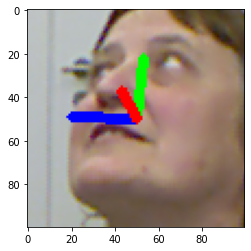

(100, 100, 3)
oPredictedAngles : [-23.771387    14.632006     0.42506108]
oLabel : [-34.8476, 33.2155, -5.27077]


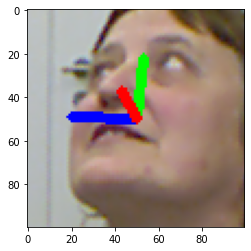

(100, 100, 3)
oPredictedAngles : [-24.51307    14.372671    0.9180044]
oLabel : [-34.5515, 31.1492, -5.54692]


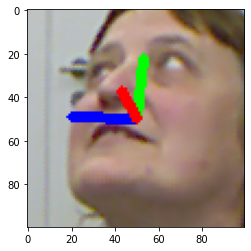

(100, 100, 3)
oPredictedAngles : [-24.986721   14.276023    1.0092847]
oLabel : [-33.5355, 29.5318, -4.91553]


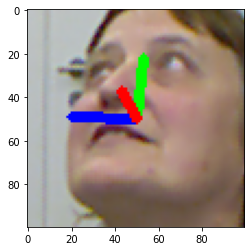

(100, 100, 3)
oPredictedAngles : [-25.702133   14.089273    1.3042431]
oLabel : [-32.8564, 26.8025, -4.17132]


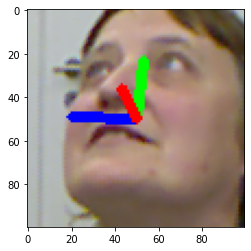

(100, 100, 3)
oPredictedAngles : [-23.784399   14.272665    0.7484774]
oLabel : [-32.4823, 24.7274, -3.94252]


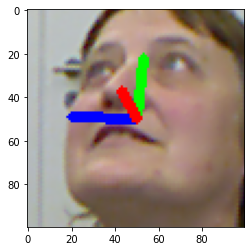

(100, 100, 3)
oPredictedAngles : [-23.918951   14.262653    0.7667379]
oLabel : [-31.9844, 23.1655, -4.21782]


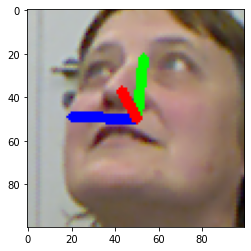

(100, 100, 3)
oPredictedAngles : [-24.273142    13.477397     0.82920164]
oLabel : [-31.9806, 22.9471, -3.79978]


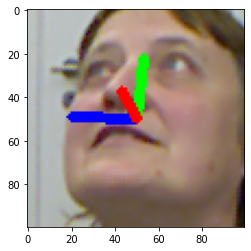

(100, 100, 3)
oPredictedAngles : [-24.366581  12.974399   0.90369 ]
oLabel : [-31.7326, 22.5467, -3.54729]


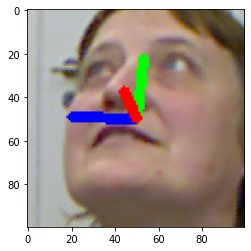

(100, 100, 3)
oPredictedAngles : [-25.909016   12.843103    1.0200081]
oLabel : [-31.9174, 22.462, -3.32416]


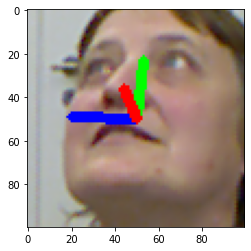

(100, 100, 3)
oPredictedAngles : [-25.720304   13.787069    0.9219915]
oLabel : [-31.9282, 23.1109, -3.74268]


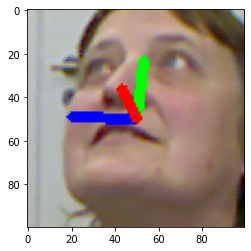

(100, 100, 3)
oPredictedAngles : [-24.270378  13.512851   0.866935]
oLabel : [-32.2388, 23.2158, -3.54963]


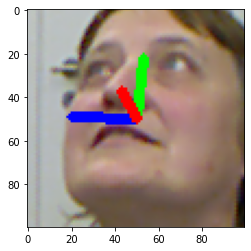

(100, 100, 3)
oPredictedAngles : [-28.584818   13.28059     1.0501531]
oLabel : [-32.3137, 22.4641, -3.91345]


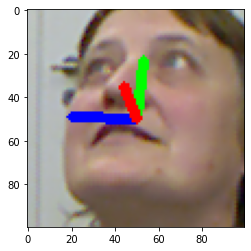

(100, 100, 3)
oPredictedAngles : [-24.636425   14.35121     0.7496351]
oLabel : [-32.0045, 22.3146, -3.52072]


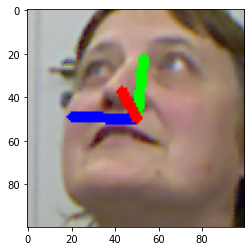

(100, 100, 3)
oPredictedAngles : [-24.391762   13.273904    0.8796785]
oLabel : [-31.5226, 21.6868, -3.05605]


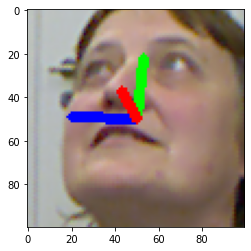

(100, 100, 3)
oPredictedAngles : [-26.933899   11.8409605   1.1098764]
oLabel : [-32.0405, 21.7858, -3.3582]


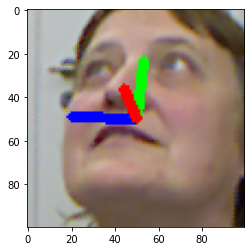

(100, 100, 3)
oPredictedAngles : [-30.450108    8.804269    1.5328665]
oLabel : [-31.3441, 21.1292, -2.6408]


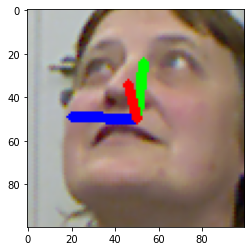

(100, 100, 3)
oPredictedAngles : [-29.95709     8.638004    1.5232308]
oLabel : [-31.2941, 20.914, -2.6332]


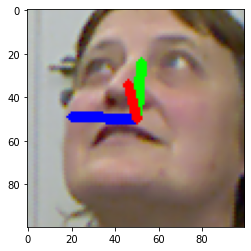

(100, 100, 3)
oPredictedAngles : [-29.035362   11.860356    0.9546723]
oLabel : [-31.4847, 20.8688, -3.07551]


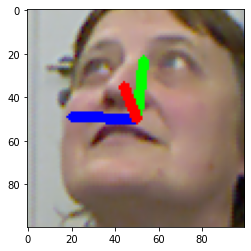

(100, 100, 3)
oPredictedAngles : [-27.472565   11.365698    1.1492302]
oLabel : [-31.2893, 20.4199, -3.27873]


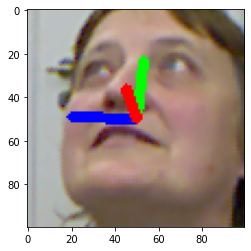

(100, 100, 3)
oPredictedAngles : [-29.29775     8.625143    1.4636033]
oLabel : [-31.3703, 19.7358, -2.71037]


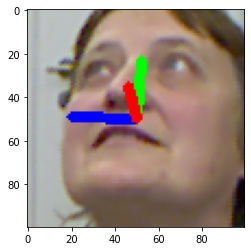

(100, 100, 3)
oPredictedAngles : [-29.846651    7.8032603   1.5384707]
oLabel : [-31.0226, 19.0802, -2.28036]


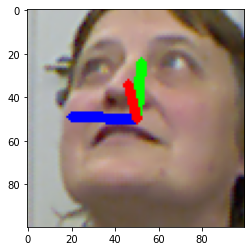

(100, 100, 3)
oPredictedAngles : [-30.398134    7.311203    1.0771649]
oLabel : [-30.9598, 17.9263, -2.59895]


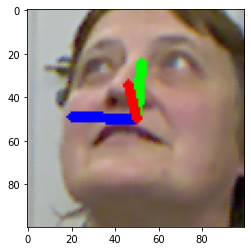

(100, 100, 3)
oPredictedAngles : [-30.349062    7.388453    1.3791206]
oLabel : [-30.6497, 17.6324, -1.50985]


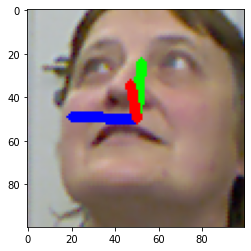

(100, 100, 3)
oPredictedAngles : [-30.553236   7.408145   1.525647]
oLabel : [-30.961, 16.5406, -1.5077]


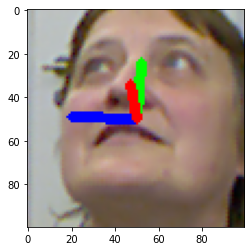

(100, 100, 3)
oPredictedAngles : [-29.33792     7.456011    1.6491778]
oLabel : [-30.4586, 15.5655, -2.37423]


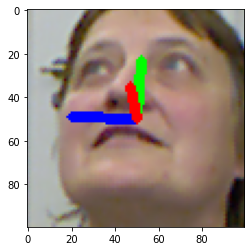

(100, 100, 3)
oPredictedAngles : [-29.566908    7.4560723   1.6625701]
oLabel : [-30.1855, 15.0658, -2.47365]


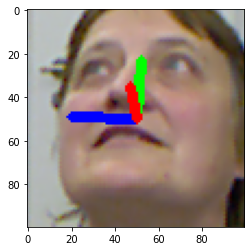

(100, 100, 3)
oPredictedAngles : [-30.426815    7.4335456   1.5955166]
oLabel : [-30.2642, 15.0761, -1.87826]


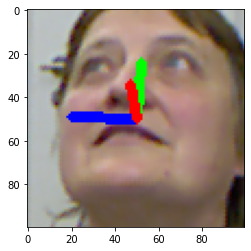

(100, 100, 3)
oPredictedAngles : [-30.087442    7.4198766   1.556873 ]
oLabel : [-30.0539, 14.5533, -1.60433]


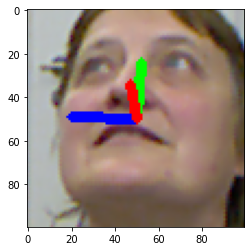

(100, 100, 3)
oPredictedAngles : [-30.013071    7.3996706   1.4999417]
oLabel : [-29.9028, 13.7408, -2.10694]


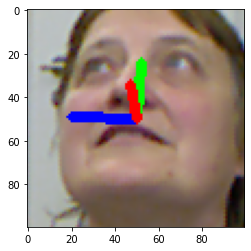

(100, 100, 3)
oPredictedAngles : [-29.642101    7.400856    1.5035634]
oLabel : [-29.9698, 12.7019, -2.12045]


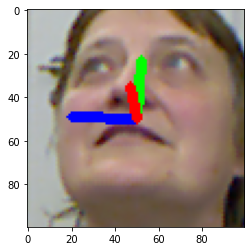

(100, 100, 3)
oPredictedAngles : [-28.67271     7.4491816   1.6530727]
oLabel : [-29.9692, 11.7464, -2.69577]


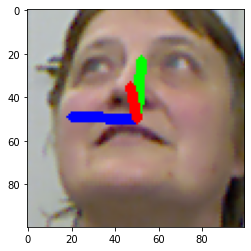

(100, 100, 3)
oPredictedAngles : [-29.327202    7.4408073   1.6168027]
oLabel : [-30.0495, 11.1377, -1.75371]


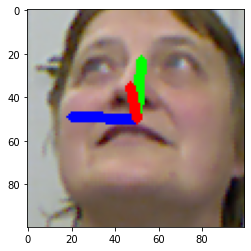

(100, 100, 3)
oPredictedAngles : [-27.61955     7.4430184   1.617081 ]
oLabel : [-29.8705, 10.3292, -1.08619]


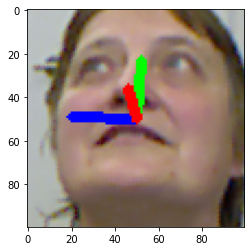

(100, 100, 3)
oPredictedAngles : [-28.549044   7.447981   1.630412]
oLabel : [-29.68, 9.94722, -1.25836]


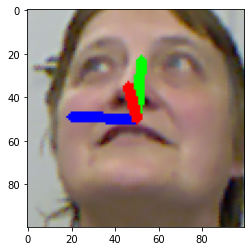

(100, 100, 3)
oPredictedAngles : [-29.09368     7.4551573   1.656855 ]
oLabel : [-29.9532, 9.6769, -1.3643]


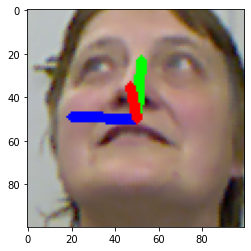

(100, 100, 3)
oPredictedAngles : [-28.894722   7.46387    1.674914]
oLabel : [-29.5574, 9.19076, -1.27923]


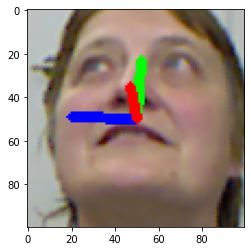

(100, 100, 3)
oPredictedAngles : [-28.878626    7.460483    1.6788088]
oLabel : [-29.7626, 8.35836, -1.1257]


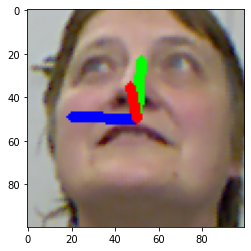

(100, 100, 3)
oPredictedAngles : [-28.241838    7.4465585   1.6692722]
oLabel : [-29.7418, 8.32448, -1.27046]


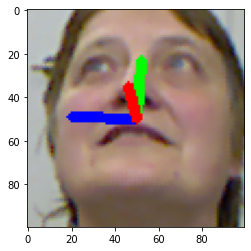

(100, 100, 3)
oPredictedAngles : [-28.635578    7.439046    1.6742891]
oLabel : [-29.6764, 7.58079, -1.04928]


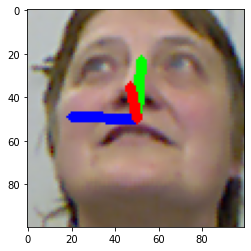

(100, 100, 3)
oPredictedAngles : [-27.891556   7.422705   1.673676]
oLabel : [-29.3164, 7.47664, -0.689498]


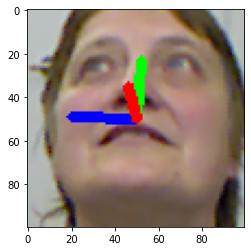

(100, 100, 3)
oPredictedAngles : [-27.615091    7.4391727   1.6546369]
oLabel : [-28.9867, 7.0121, -0.878867]


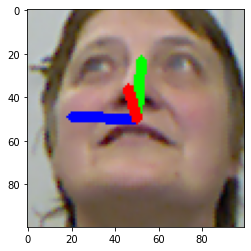

(100, 100, 3)
oPredictedAngles : [-26.982075    7.417895    1.6404744]
oLabel : [-29.3318, 6.91484, -0.500592]


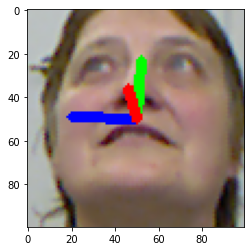

(100, 100, 3)
oPredictedAngles : [-25.40126     7.415212    1.5741088]
oLabel : [-29.2346, 6.23819, -0.418913]


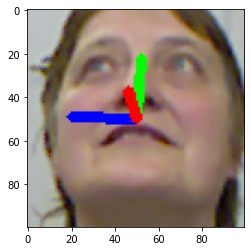

(100, 100, 3)
oPredictedAngles : [-25.66174     7.4286137   1.6041294]
oLabel : [-29.7242, 5.91034, -0.565432]


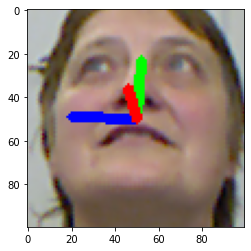

(100, 100, 3)
oPredictedAngles : [-25.24895     7.4003854   1.5851191]
oLabel : [-29.4544, 5.39719, -0.300895]


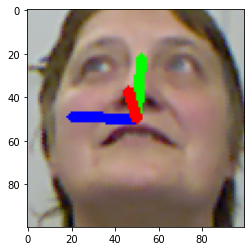

(100, 100, 3)
oPredictedAngles : [-26.086494    7.371691    1.6449089]
oLabel : [-29.1865, 4.09275, -0.889535]


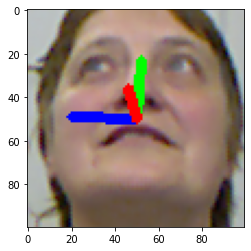

(100, 100, 3)
oPredictedAngles : [-27.09308     7.434904    1.6309054]
oLabel : [-29.0898, 2.97548, -0.317063]


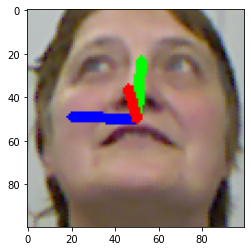

(100, 100, 3)
oPredictedAngles : [-25.962362    7.322068    1.6715757]
oLabel : [-28.6271, 2.22787, 0.11332]


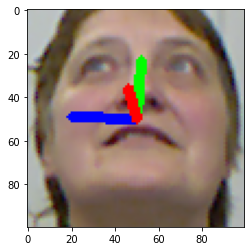

(100, 100, 3)
oPredictedAngles : [-24.956985    7.372584    1.6122811]
oLabel : [-28.2255, 0.564476, 0.84574]


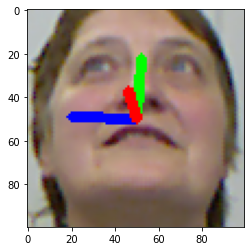

(100, 100, 3)
oPredictedAngles : [-25.359182    7.0930877   1.7594444]
oLabel : [-28.8172, -0.948959, 1.06757]


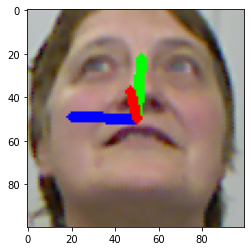

(100, 100, 3)
oPredictedAngles : [-24.517855    7.0680904   1.7310889]
oLabel : [-28.6281, -2.23669, 0.896774]


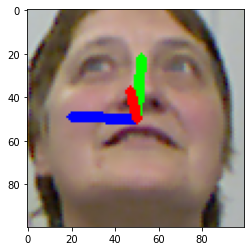

(100, 100, 3)
oPredictedAngles : [-26.06285     5.5982723   2.50067  ]
oLabel : [-28.4311, -3.24084, 0.515044]


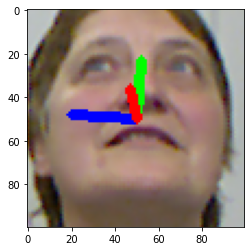

(100, 100, 3)
oPredictedAngles : [-25.921335    4.61123     2.9559653]
oLabel : [-28.3406, -4.03588, 0.246462]


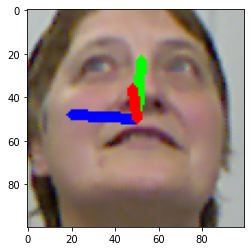

(100, 100, 3)
oPredictedAngles : [-26.946665    2.8162751   3.814807 ]
oLabel : [-28.2019, -5.08336, 0.910911]


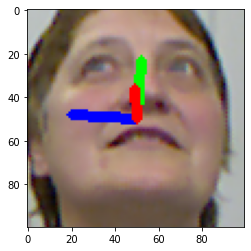

(100, 100, 3)
oPredictedAngles : [-22.3342      2.808797    3.7127502]
oLabel : [-28.1775, -5.57732, 2.0762]


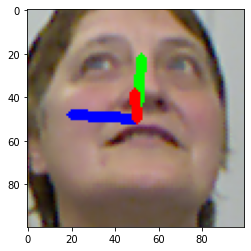

(100, 100, 3)
oPredictedAngles : [-22.0835      2.8664422   3.5812008]
oLabel : [-28.0491, -6.75852, 0.883787]


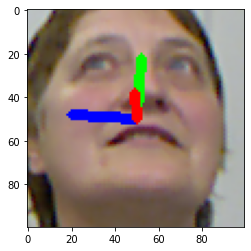

(100, 100, 3)
oPredictedAngles : [-22.029602    2.7022247   3.7402692]
oLabel : [-28.1675, -8.43759, 1.42083]


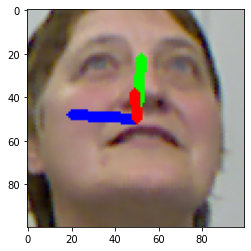

(100, 100, 3)
oPredictedAngles : [-21.93187     2.6214364   3.7793071]
oLabel : [-27.8591, -9.67551, 1.47061]


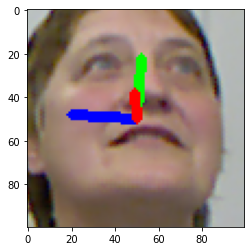

(100, 100, 3)
oPredictedAngles : [-21.351402    1.8633426   2.908289 ]
oLabel : [-27.8489, -11.2535, 1.32083]


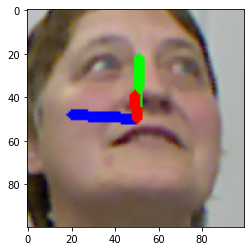

(100, 100, 3)
oPredictedAngles : [-18.52358     -0.41547367   1.0896351 ]
oLabel : [-28.0367, -12.9058, 2.16657]


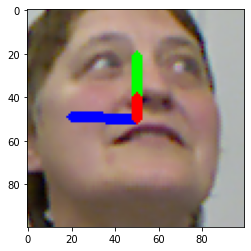

(100, 100, 3)
oPredictedAngles : [-18.531137   -1.4012774  -0.748572 ]
oLabel : [-27.3132, -15.009, 1.72568]


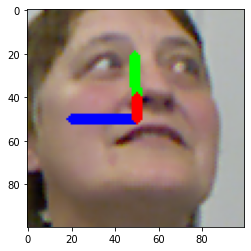

(100, 100, 3)
oPredictedAngles : [-18.561356   -1.5256915  -0.8212845]
oLabel : [-27.609, -16.4124, 3.47504]


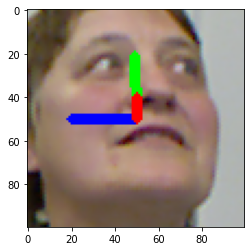

(100, 100, 3)
oPredictedAngles : [-18.7256      -1.9344047   -0.92275375]
oLabel : [-27.2974, -18.0468, 3.11959]


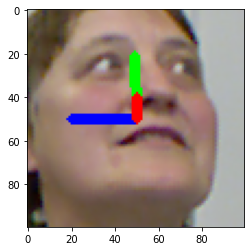

(100, 100, 3)
oPredictedAngles : [-19.836603   -4.926538   -1.4748276]
oLabel : [-26.7308, -19.2682, 2.08516]


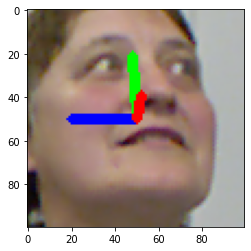

(100, 100, 3)
oPredictedAngles : [-20.471863   -6.0732436  -1.6949373]
oLabel : [-26.5056, -20.2101, 2.02351]


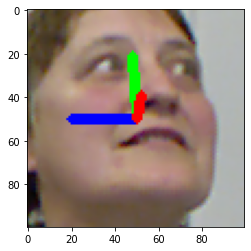

(100, 100, 3)
oPredictedAngles : [-21.357092   -8.004404   -1.6565278]
oLabel : [-26.4085, -21.4216, 1.79907]


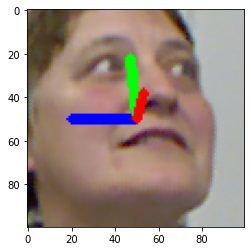

(100, 100, 3)
oPredictedAngles : [-20.345356   -11.570879    -0.88359463]
oLabel : [-26.3308, -21.6424, 3.29769]


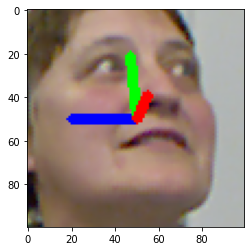

(100, 100, 3)
oPredictedAngles : [-19.481743   -13.1018715    0.09387375]
oLabel : [-26.2461, -22.2963, 3.38138]


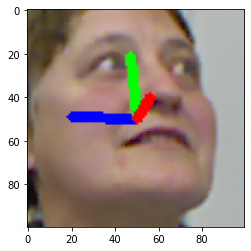

(100, 100, 3)
oPredictedAngles : [-19.817627  -15.181035    0.3712648]
oLabel : [-25.8682, -23.8061, 3.08936]


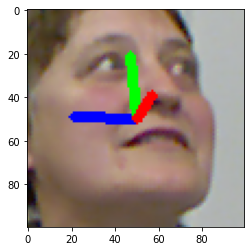

(100, 100, 3)
oPredictedAngles : [-19.594837  -14.99438     0.5335979]
oLabel : [-25.8234, -25.3072, 1.9555]


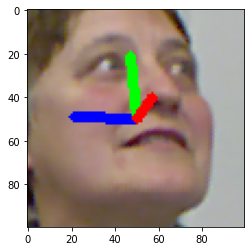

(100, 100, 3)
oPredictedAngles : [-20.053688  -16.092497    0.3664512]
oLabel : [-25.4232, -25.1826, 2.56989]


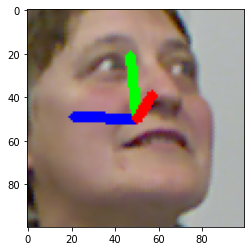

(100, 100, 3)
oPredictedAngles : [-20.230469   -16.327274     0.29741678]
oLabel : [-25.3824, -25.6533, 3.22989]


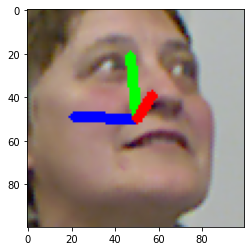

(100, 100, 3)
oPredictedAngles : [-20.137083   -16.319544     0.29741165]
oLabel : [-24.8564, -25.7154, 2.58291]


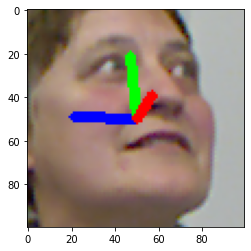

(100, 100, 3)
oPredictedAngles : [-20.001442   -16.174532     0.34204525]
oLabel : [-23.7069, -25.9426, 2.84425]


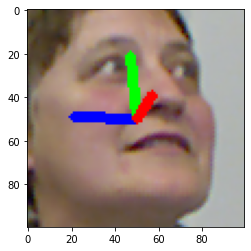

(100, 100, 3)
oPredictedAngles : [-19.729395   -15.643927     0.51052207]
oLabel : [-23.3807, -26.0835, 2.90177]


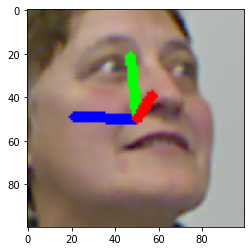

(100, 100, 3)
oPredictedAngles : [-18.759083  -13.776188    1.0971637]
oLabel : [-22.7068, -26.4621, 2.90122]


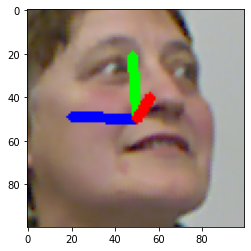

(100, 100, 3)
oPredictedAngles : [-18.370913  -13.020034    1.3346902]
oLabel : [-21.2147, -26.9469, 1.35667]


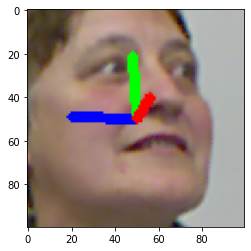

(100, 100, 3)
oPredictedAngles : [-18.610353  -13.488658    1.1867194]
oLabel : [-20.1893, -26.6059, 1.97229]


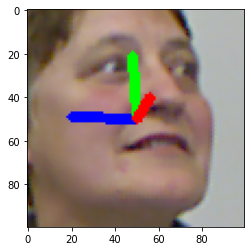

(100, 100, 3)
oPredictedAngles : [-18.120651  -12.573534    1.4745675]
oLabel : [-20.0158, -26.9679, 2.31699]


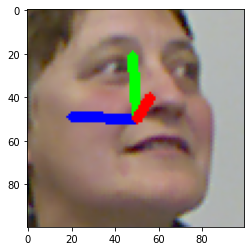

(100, 100, 3)
oPredictedAngles : [-17.841824  -12.529743    1.4660826]
oLabel : [-19.4536, -26.8357, 2.73088]


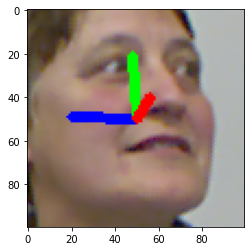

(100, 100, 3)
oPredictedAngles : [-17.035744  -12.578856    1.3902265]
oLabel : [-18.639, -27.8459, 2.18808]


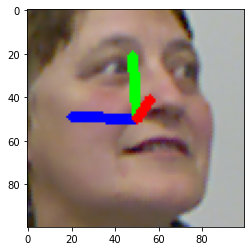

(100, 100, 3)
oPredictedAngles : [-15.849208  -12.722851    1.2342814]
oLabel : [-17.2714, -27.4688, 1.82113]


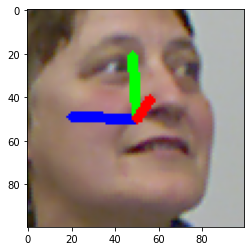

(100, 100, 3)
oPredictedAngles : [-13.568836  -12.967769    0.9858162]
oLabel : [-16.589, -27.9568, 1.98296]


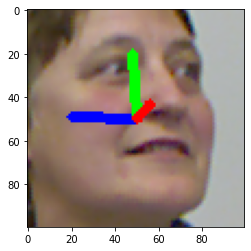

(100, 100, 3)
oPredictedAngles : [-13.095659  -12.838112    0.9184962]
oLabel : [-15.8325, -27.9153, 0.682716]


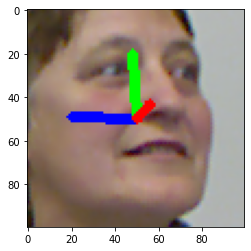

(100, 100, 3)
oPredictedAngles : [-13.089537  -12.9027815   1.0229075]
oLabel : [-15.3803, -27.4605, 1.40158]


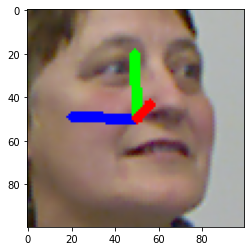

(100, 100, 3)
oPredictedAngles : [-13.037339  -12.462604    0.9427126]
oLabel : [-14.7743, -26.6406, 1.33597]


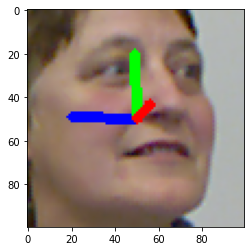

(100, 100, 3)
oPredictedAngles : [-13.028721  -12.717523    1.2282658]
oLabel : [-14.1248, -25.7073, 0.698926]


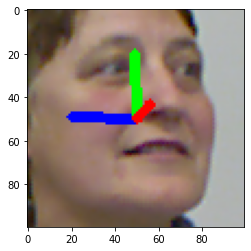

(100, 100, 3)
oPredictedAngles : [-12.374958   -6.206694    1.7012205]
oLabel : [-13.4598, -24.7511, 0.591154]


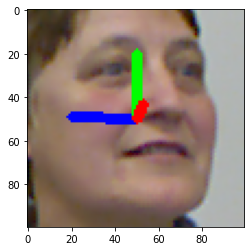

(100, 100, 3)
oPredictedAngles : [-12.372624   -5.584193    1.6661167]
oLabel : [-13.0721, -23.4603, 0.44118]


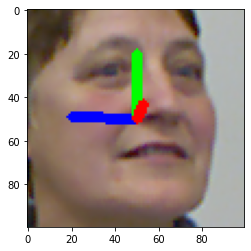

(100, 100, 3)
oPredictedAngles : [-12.3816395  -5.0280657   2.6194522]
oLabel : [-12.7539, -21.5762, 0.203495]


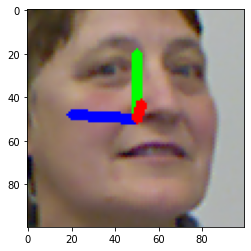

(100, 100, 3)
oPredictedAngles : [-12.571664   -4.4583826   1.8008575]
oLabel : [-11.8872, -19.4835, 0.232243]


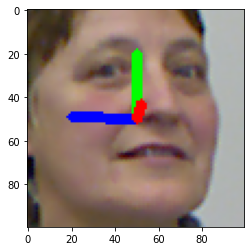

(100, 100, 3)
oPredictedAngles : [-13.259839   -1.5927826   1.1923492]
oLabel : [-11.1192, -18.34, 0.110386]


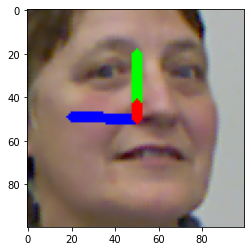

(100, 100, 3)
oPredictedAngles : [-12.21946    -3.593764    3.1914103]
oLabel : [-11.047, -17.7158, -0.0197105]


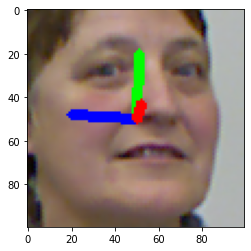

(100, 100, 3)
oPredictedAngles : [-12.939166   -1.4509469   2.4683788]
oLabel : [-10.7792, -16.7263, 0.122704]


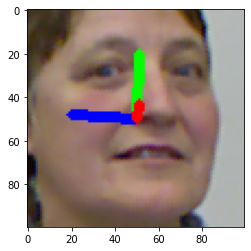

(100, 100, 3)
oPredictedAngles : [-13.364201    -0.81371087   1.7798803 ]
oLabel : [-10.468, -15.7622, -0.442786]


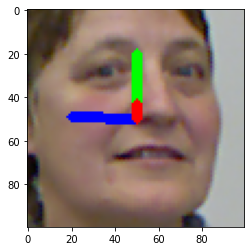

(100, 100, 3)
oPredictedAngles : [-13.403418   -0.6374902   1.5431255]
oLabel : [-10.2625, -15.4284, 0.139503]


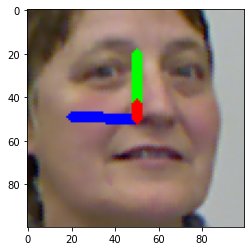

(100, 100, 3)
oPredictedAngles : [-13.412721    -0.73180145   1.3228587 ]
oLabel : [-9.92049, -14.7958, -0.0487421]


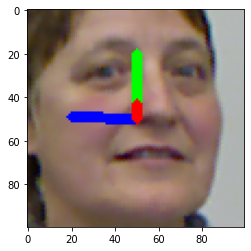

(100, 100, 3)
oPredictedAngles : [-12.911941    -0.38348448   2.0506117 ]
oLabel : [-10.2355, -14.236, -0.156766]


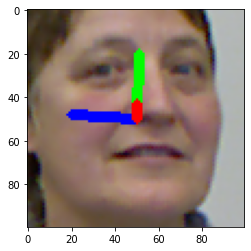

(100, 100, 3)
oPredictedAngles : [-13.338716    -0.8043577    0.45054278]
oLabel : [-10.1506, -13.1815, -0.492232]


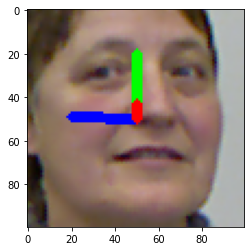

(100, 100, 3)
oPredictedAngles : [-13.296512    -0.42393073   1.0133247 ]
oLabel : [-10.0184, -12.6052, -0.564084]


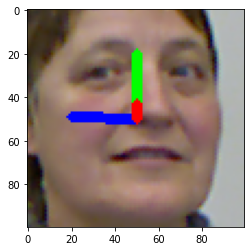

(100, 100, 3)
oPredictedAngles : [-13.297979    -0.41284278   1.0440675 ]
oLabel : [-9.76943, -11.1568, -0.287693]


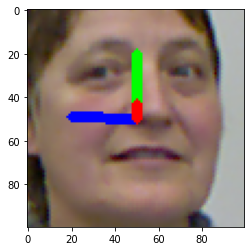

(100, 100, 3)
oPredictedAngles : [-13.170243    -0.15590301   0.91558135]
oLabel : [-9.87299, -9.41069, -0.503593]


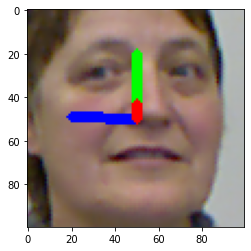

(100, 100, 3)
oPredictedAngles : [-13.380337    -0.37974796   1.5467933 ]
oLabel : [-10.1212, -7.82732, -0.961522]


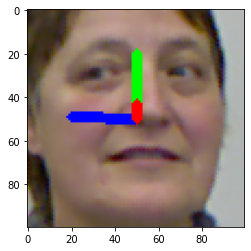

(100, 100, 3)
oPredictedAngles : [-13.179104    -0.17003083   0.91152084]
oLabel : [-10.1887, -6.03788, -0.977055]


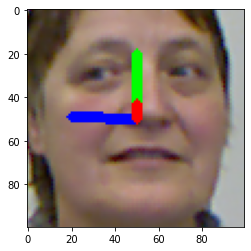

(100, 100, 3)
oPredictedAngles : [-12.893006     0.17293131   0.10926729]
oLabel : [-9.84055, -4.76542, -1.18631]


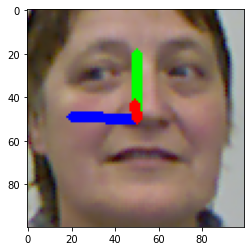

(100, 100, 3)
oPredictedAngles : [-12.711478     0.38960883  -0.40934044]
oLabel : [-9.86654, -3.0193, -0.895478]


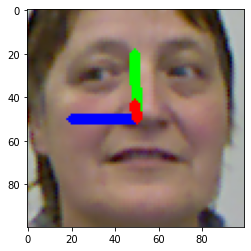

(100, 100, 3)
oPredictedAngles : [-12.668433     0.38871747  -0.62687343]
oLabel : [-9.5532, -2.63409, -1.13586]


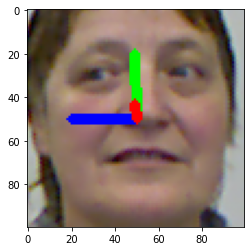

(100, 100, 3)
oPredictedAngles : [-12.713066     0.3948988   -0.38604096]
oLabel : [-9.60097, -1.43669, -1.31678]


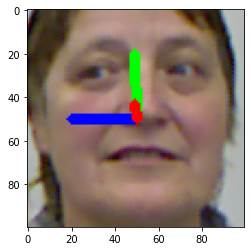

(100, 100, 3)
oPredictedAngles : [-12.779993     0.33853737  -0.20784813]
oLabel : [-9.82465, -1.61128, -1.11047]


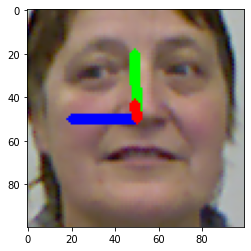

(100, 100, 3)
oPredictedAngles : [-12.795029     0.33348686  -0.17829902]
oLabel : [-9.67505, -1.5075, -1.29894]


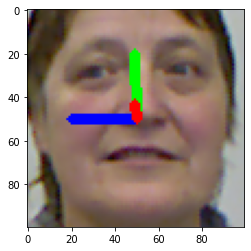

(100, 100, 3)
oPredictedAngles : [-12.672731     0.443108    -0.52502507]
oLabel : [-9.51111, -0.995765, -0.890604]


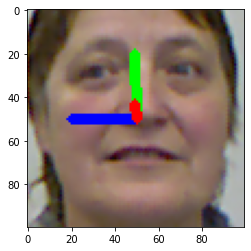

(100, 100, 3)
oPredictedAngles : [-12.732075     0.44873518  -0.4207383 ]
oLabel : [-9.69248, 0.00214911, -1.45923]


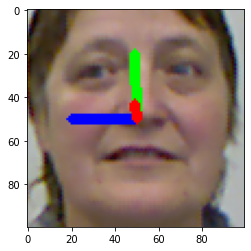

(100, 100, 3)
oPredictedAngles : [-12.667299     0.46575007  -0.5396314 ]
oLabel : [-9.97207, 0.481378, -0.840612]


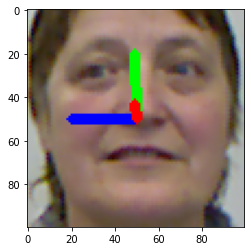

(100, 100, 3)
oPredictedAngles : [-12.803044     0.57472825  -0.47954282]
oLabel : [-10.0988, 1.75491, -0.815528]


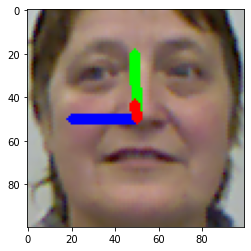

(100, 100, 3)
oPredictedAngles : [-12.670767     0.52737504  -0.5185808 ]
oLabel : [-10.1981, 3.72406, -0.621528]


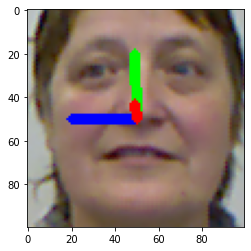

(100, 100, 3)
oPredictedAngles : [-12.758593     0.71088684  -0.47672537]
oLabel : [-10.1728, 5.00857, -0.250349]


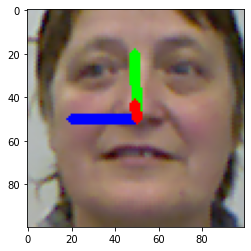

(100, 100, 3)
oPredictedAngles : [-13.630358    4.1554556  -1.5206788]
oLabel : [-10.2624, 6.61931, -0.784747]


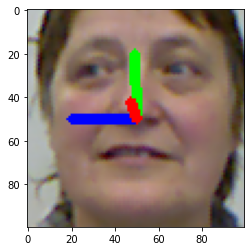

(100, 100, 3)
oPredictedAngles : [-16.425209    7.2807403  -1.6240569]
oLabel : [-10.4183, 7.92646, -0.954244]


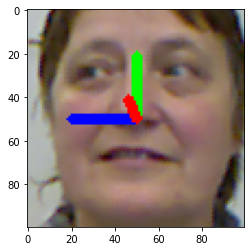

(100, 100, 3)
oPredictedAngles : [-16.641937    7.572637   -1.5848484]
oLabel : [-10.3611, 8.91772, -0.456015]


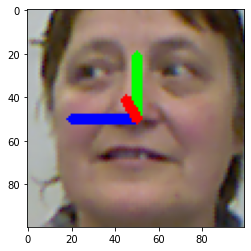

(100, 100, 3)
oPredictedAngles : [-12.464831    8.218883   -1.1949538]
oLabel : [-10.0941, 10.2978, -0.00428758]


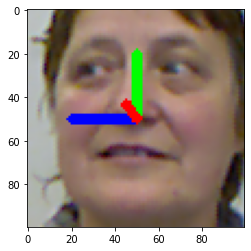

(100, 100, 3)
oPredictedAngles : [-16.683401   7.635822  -1.607265]
oLabel : [-10.4479, 11.5359, -0.00270956]


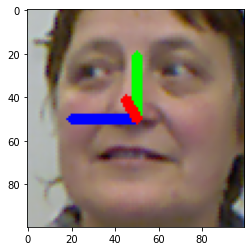

(100, 100, 3)
oPredictedAngles : [-11.5854225   9.010684   -0.7489374]
oLabel : [-10.2775, 12.1913, -0.422698]


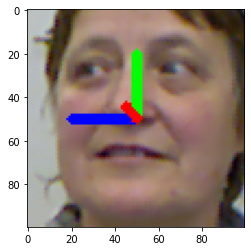

(100, 100, 3)
oPredictedAngles : [-16.905434    7.7868714  -1.5544814]
oLabel : [-10.3401, 12.6724, -0.59717]


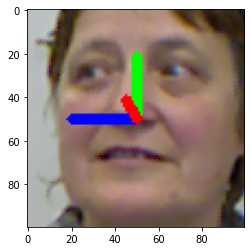

(100, 100, 3)
oPredictedAngles : [-14.499883    8.005475   -1.4211116]
oLabel : [-10.1177, 13.3395, 0.290771]


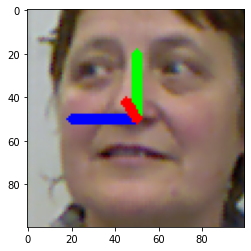

(100, 100, 3)
oPredictedAngles : [-14.919407   8.269369  -1.271802]
oLabel : [-10.2108, 13.5313, -0.361139]


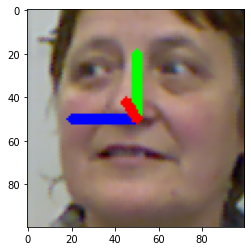

(100, 100, 3)
oPredictedAngles : [-13.149134     8.702597    -0.96188897]
oLabel : [-9.91606, 14.232, 0.411319]


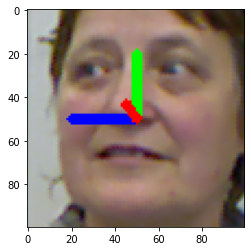

(100, 100, 3)
oPredictedAngles : [-12.961598    8.47019    -1.1726363]
oLabel : [-9.98888, 15.4213, 0.130211]


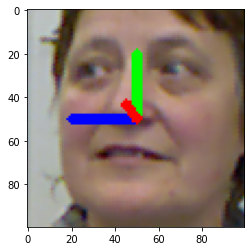

(100, 100, 3)
oPredictedAngles : [-12.398756    8.746877   -1.0004761]
oLabel : [-9.91472, 16.6187, 0.368404]


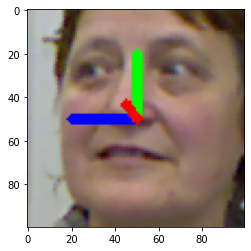

(100, 100, 3)
oPredictedAngles : [-12.117467    8.985715   -0.7650669]
oLabel : [-9.80879, 18.0876, 0.477056]


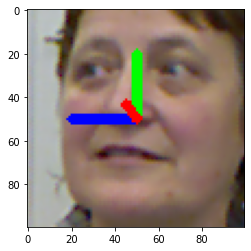

(100, 100, 3)
oPredictedAngles : [-15.005855    8.3398285  -1.1406965]
oLabel : [-9.83648, 19.8101, 1.02064]


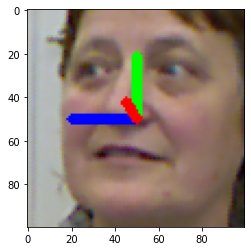

(100, 100, 3)
oPredictedAngles : [-16.268045    7.962353   -1.4306961]
oLabel : [-9.63284, 22.5763, 1.55197]


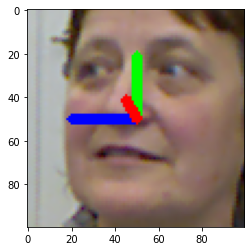

(100, 100, 3)
oPredictedAngles : [-13.821299     8.724879    -0.76027554]
oLabel : [-9.70439, 25.0014, 1.37548]


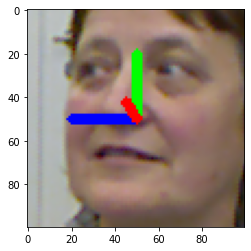

(100, 100, 3)
oPredictedAngles : [-11.209663    9.515664   -0.4933654]
oLabel : [-9.40014, 26.4538, 1.7605]


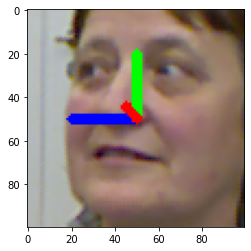

(100, 100, 3)
oPredictedAngles : [-10.163058     9.835134    -0.17000888]
oLabel : [-9.44899, 27.774, 2.07634]


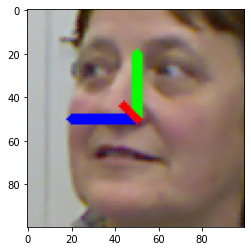

(100, 100, 3)
oPredictedAngles : [-6.253156   11.790406   -0.02909184]
oLabel : [-9.4279, 29.3832, 1.60513]


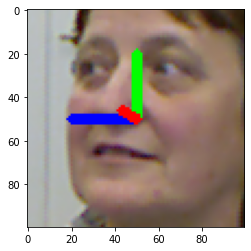

(100, 100, 3)
oPredictedAngles : [-6.578531 13.849477 -0.411299]
oLabel : [-9.25097, 30.6002, 1.29535]


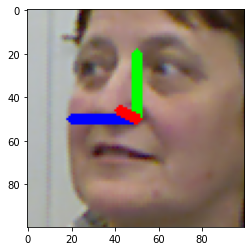

(100, 100, 3)
oPredictedAngles : [-6.551777   15.59334    -0.56982255]
oLabel : [-9.10038, 31.8399, 1.38968]


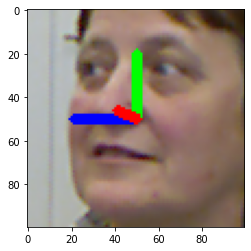

(100, 100, 3)
oPredictedAngles : [-6.611621   15.369301   -0.60178787]
oLabel : [-9.13303, 33.2226, 1.43474]


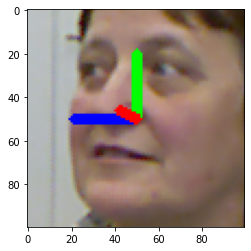

(100, 100, 3)
oPredictedAngles : [-6.9512095 17.949984  -1.159459 ]
oLabel : [-9.38401, 34.1581, 0.862822]


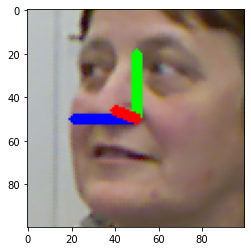

(100, 100, 3)
oPredictedAngles : [-7.6337743 18.034275  -1.6227474]
oLabel : [-9.26797, 35.9303, 0.24918]


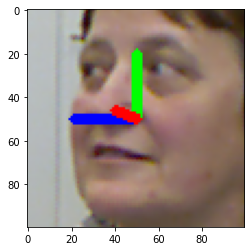

(100, 100, 3)
oPredictedAngles : [-6.7283535 18.388     -1.0639969]
oLabel : [-9.67955, 37.7782, -0.241498]


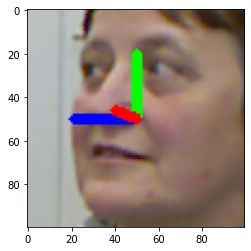

(100, 100, 3)
oPredictedAngles : [-8.326402 17.859238 -2.007627]
oLabel : [-9.50412, 39.3741, -0.200208]


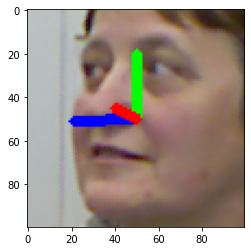

(100, 100, 3)
oPredictedAngles : [-6.659226  18.435299  -1.1830113]
oLabel : [-9.23242, 40.9573, 0.00673832]


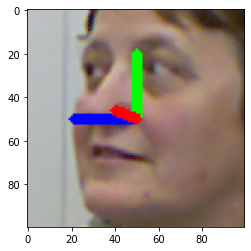

(100, 100, 3)
oPredictedAngles : [-2.8593342  19.888947   -0.20553099]
oLabel : [-8.89786, 42.1249, -0.496258]


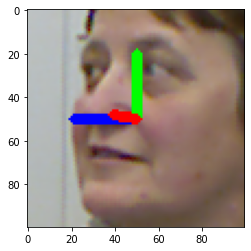

(100, 100, 3)
oPredictedAngles : [-3.5641036  19.61418    -0.33427495]
oLabel : [-8.79518, 43.5173, -0.248261]


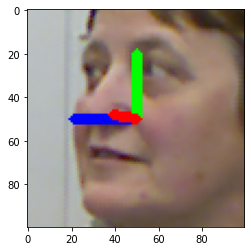

(100, 100, 3)
oPredictedAngles : [-2.2427492e+00  2.0116411e+01  1.7558347e-02]
oLabel : [-8.25382, 43.6966, 0.183067]


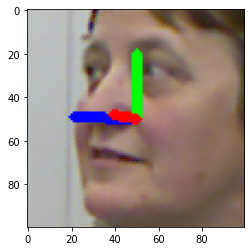

(100, 100, 3)
oPredictedAngles : [-3.5017986  19.655478   -0.45839316]
oLabel : [-8.66455, 43.8383, -1.15817]


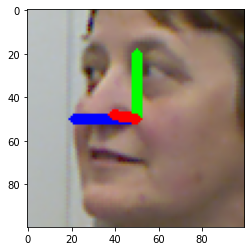

(100, 100, 3)
oPredictedAngles : [-2.0684035 20.193901  -0.0377474]
oLabel : [-8.40135, 44.4723, -0.897214]


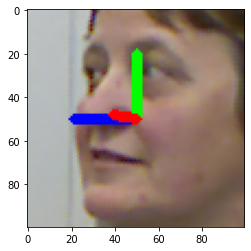

(100, 100, 3)
oPredictedAngles : [-2.4615183  20.034378   -0.05598913]
oLabel : [-8.24999, 44.7762, -0.881817]


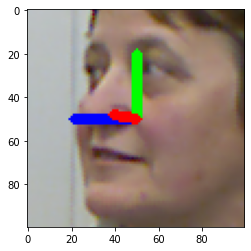

(100, 100, 3)
oPredictedAngles : [-3.581251   19.603895   -0.31979153]
oLabel : [-8.15999, 45.2505, -1.19075]


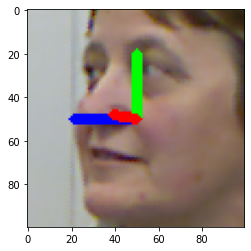

(100, 100, 3)
oPredictedAngles : [-2.0346880e+00  2.0203726e+01  7.2550080e-03]
oLabel : [-8.31762, 45.4811, -1.59825]


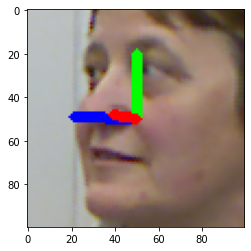

(100, 100, 3)
oPredictedAngles : [-2.0607774  20.198608   -0.03810086]
oLabel : [-8.25501, 45.6721, -2.10357]


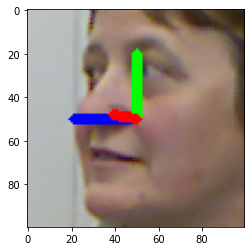

(100, 100, 3)
oPredictedAngles : [-2.9110627  19.87983    -0.29722458]
oLabel : [-8.0476, 45.5103, -2.04747]


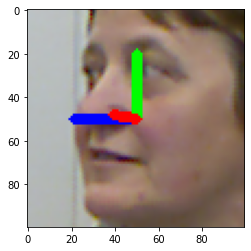

(100, 100, 3)
oPredictedAngles : [-1.6189052  20.371088    0.04086295]
oLabel : [-8.40549, 45.4084, -2.1013]


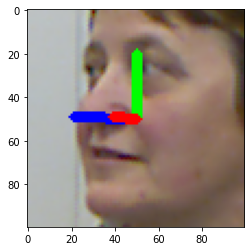

(100, 100, 3)
oPredictedAngles : [-1.9622707  20.281828   -0.20455599]
oLabel : [-8.22898, 45.478, -2.51824]


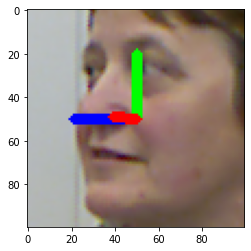

(100, 100, 3)
oPredictedAngles : [-1.7182913e+00  2.0329021e+01 -4.1018887e-03]
oLabel : [-8.16921, 45.6876, -2.41867]


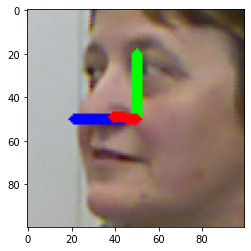

(100, 100, 3)
oPredictedAngles : [-1.6533772  20.356144   -0.05362418]
oLabel : [-7.46676, 46.1334, -2.73551]


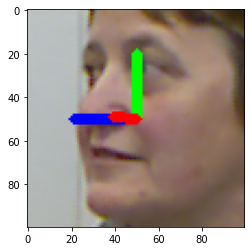

(100, 100, 3)
oPredictedAngles : [-1.9926599  20.222511   -0.09104165]
oLabel : [-7.32073, 46.4173, -1.97565]


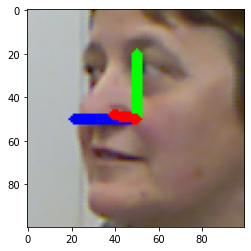

(100, 100, 3)
oPredictedAngles : [-1.4020212  20.373241   -0.07439648]
oLabel : [-7.02338, 46.8141, -2.01817]


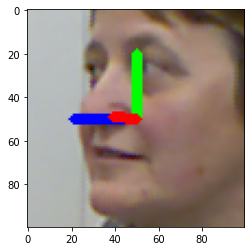

(100, 100, 3)
oPredictedAngles : [-1.2737143  20.376225    0.04479543]
oLabel : [-6.90663, 47.7796, -2.72467]


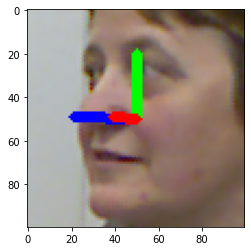

(100, 100, 3)
oPredictedAngles : [-1.6995561 20.006247  -0.9358216]
oLabel : [-6.12488, 47.2666, -2.86473]


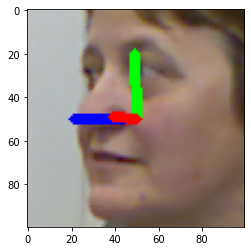

(100, 100, 3)
oPredictedAngles : [-1.5346941  20.329407   -0.12166823]
oLabel : [-6.67786, 48.129, -3.52429]


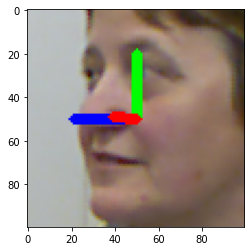

(100, 100, 3)
oPredictedAngles : [-1.1773643  20.321493   -0.02642295]
oLabel : [-5.65677, 48.4089, -3.11498]


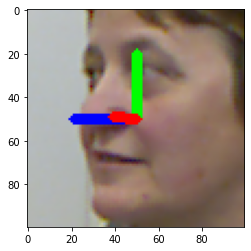

(100, 100, 3)
oPredictedAngles : [-0.29250476 19.468493   -0.9822532 ]
oLabel : [-5.34103, 48.3438, -3.48831]


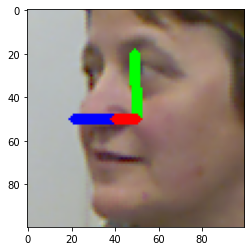

(100, 100, 3)
oPredictedAngles : [-1.1874678 20.209059  -0.4371837]
oLabel : [-4.8134, 48.6281, -3.46101]


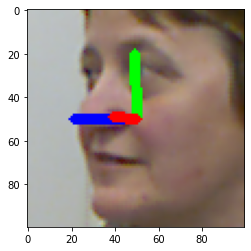

(100, 100, 3)
oPredictedAngles : [ 1.1985443 18.474165  -1.3087465]
oLabel : [-4.20088, 49.163, -3.89182]


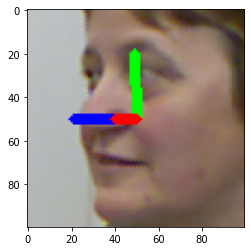

(100, 100, 3)
oPredictedAngles : [ 1.2264371 18.381     -1.6277692]
oLabel : [-3.08951, 48.882, -2.88836]


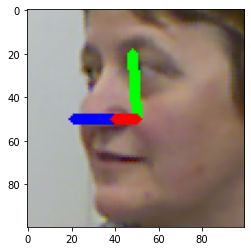

(100, 100, 3)
oPredictedAngles : [ 0.1455904 19.157127  -1.3612895]
oLabel : [-3.5422, 48.5637, -5.09723]


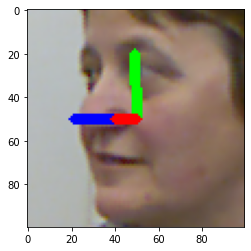

(100, 100, 3)
oPredictedAngles : [ 1.7199404 17.761255  -2.5237758]
oLabel : [-2.79103, 47.8817, -4.49915]


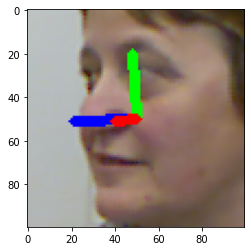

(100, 100, 3)
oPredictedAngles : [ 1.0071163 18.592812  -1.3449482]
oLabel : [-2.36862, 47.9932, -3.83]


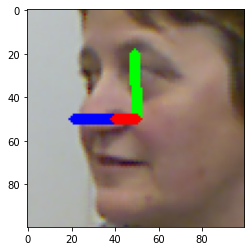

(100, 100, 3)
oPredictedAngles : [ 1.5177993 18.337532  -1.1609907]
oLabel : [-2.01383, 48.4896, -3.84724]


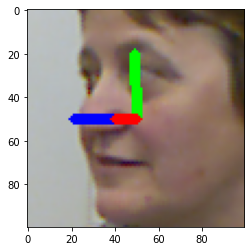

(100, 100, 3)
oPredictedAngles : [ 1.8006681 17.741203  -2.517212 ]
oLabel : [-1.84343, 47.9269, -3.53553]


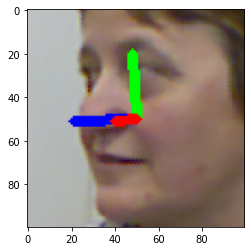

(100, 100, 3)
oPredictedAngles : [-0.33312562 19.747763   -0.37362367]
oLabel : [-2.38036, 47.8885, -5.6732]


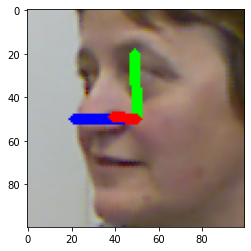

(100, 100, 3)
oPredictedAngles : [ 2.201614  17.33059   -2.9949255]
oLabel : [-2.18726, 48.2242, -4.86908]


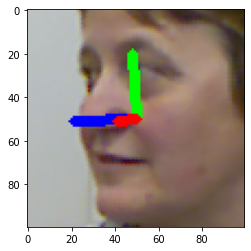

(100, 100, 3)
oPredictedAngles : [ 2.323871  17.323318  -2.8178291]
oLabel : [-2.00965, 47.7398, -3.61718]


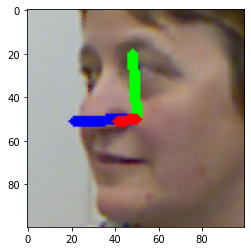

(100, 100, 3)
oPredictedAngles : [ 1.0770335 18.397099  -1.7954966]
oLabel : [-1.57833, 47.3625, -3.94904]


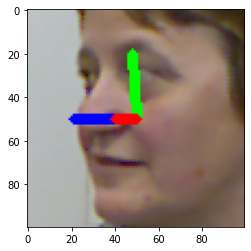

(100, 100, 3)
oPredictedAngles : [ 1.9736904 17.576338  -2.5833864]
oLabel : [-1.91954, 47.3961, -3.55648]


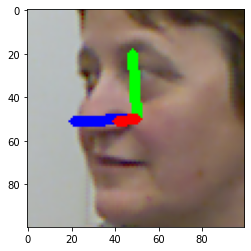

(100, 100, 3)
oPredictedAngles : [ 0.53787374 18.613865   -2.1325321 ]
oLabel : [-1.48178, 45.7709, -3.21731]


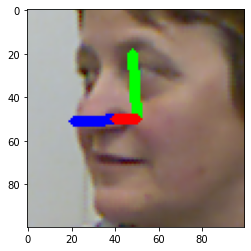

(100, 100, 3)
oPredictedAngles : [-0.7429779  19.992344   -0.36270392]
oLabel : [-1.55639, 44.6259, -3.58449]


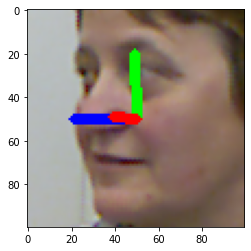

(100, 100, 3)
oPredictedAngles : [ 1.5715357 18.26677   -1.2061502]
oLabel : [-0.981445, 43.456, -3.39413]


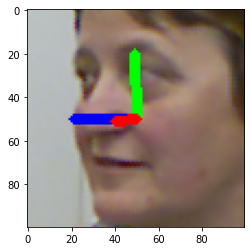

(100, 100, 3)
oPredictedAngles : [ 2.3273082 17.466158  -2.2125838]
oLabel : [-0.18174, 41.3502, -2.48087]


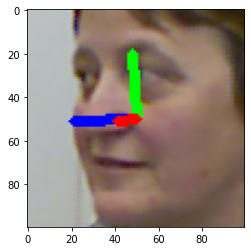

(100, 100, 3)
oPredictedAngles : [ 1.6970491 17.71419   -1.3733362]
oLabel : [0.036947, 39.7799, -3.00165]


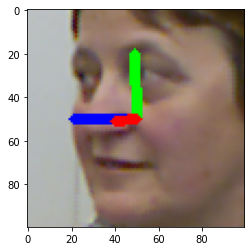

(100, 100, 3)
oPredictedAngles : [ 1.1702417 17.352634  -1.4892632]
oLabel : [-0.200123, 38.679, -3.39337]


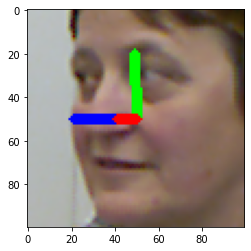

(100, 100, 3)
oPredictedAngles : [-2.0842767 16.199215  -1.9233339]
oLabel : [0.532923, 36.9047, -2.52548]


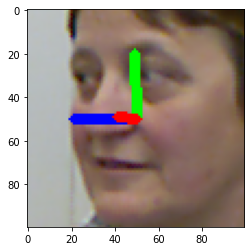

(100, 100, 3)
oPredictedAngles : [-2.4734762 15.998872  -2.0335884]
oLabel : [0.524732, 36.8456, -2.46976]


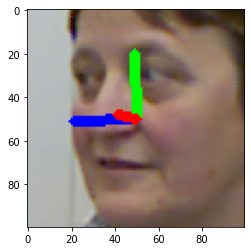

(100, 100, 3)
oPredictedAngles : [-2.665874 15.929613 -2.054786]
oLabel : [1.02976, 36.1443, -2.25363]


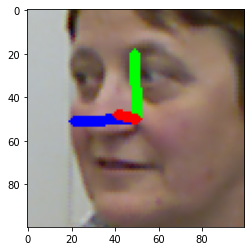

(100, 100, 3)
oPredictedAngles : [-2.3863897 15.898222  -1.9998934]
oLabel : [0.694049, 35.8325, -1.90064]


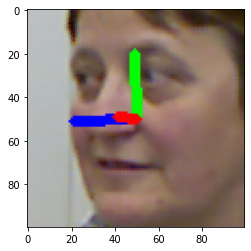

(100, 100, 3)
oPredictedAngles : [-2.7641504 16.04838   -1.9953172]
oLabel : [0.873768, 34.9022, -2.06857]


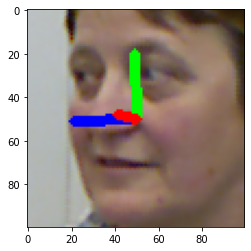

(100, 100, 3)
oPredictedAngles : [-2.5101578 14.401203  -1.8812326]
oLabel : [0.919978, 34.482, -2.34964]


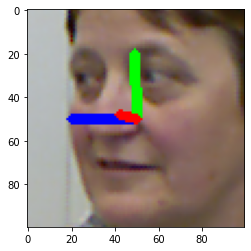

(100, 100, 3)
oPredictedAngles : [-2.7716515 15.816125  -2.0836709]
oLabel : [1.34516, 33.1973, -1.98041]


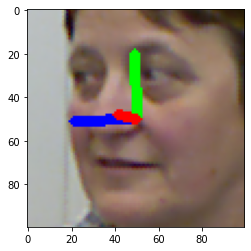

(100, 100, 3)
oPredictedAngles : [-2.5903223 13.894318  -1.8793321]
oLabel : [1.47756, 31.6012, -2.52546]


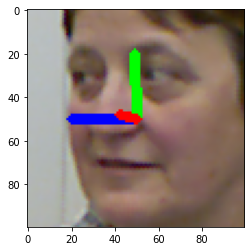

(100, 100, 3)
oPredictedAngles : [-2.603431  11.4943075 -1.7074604]
oLabel : [1.70136, 30.2962, -2.13407]


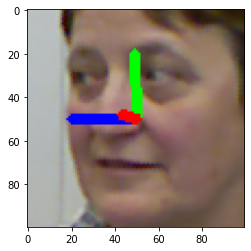

(100, 100, 3)
oPredictedAngles : [-2.5937457  8.797063  -1.4460863]
oLabel : [2.11842, 27.6742, -2.04908]


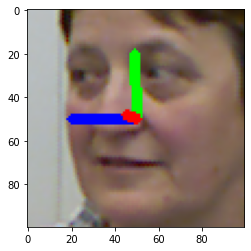

(100, 100, 3)
oPredictedAngles : [-2.4662294  8.718923  -1.325711 ]
oLabel : [2.07557, 25.3983, -1.77254]


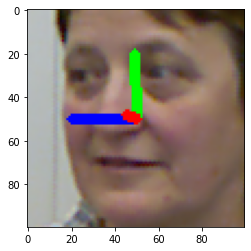

(100, 100, 3)
oPredictedAngles : [-2.4091768  8.701933  -1.2842141]
oLabel : [2.08565, 23.6667, -1.47758]


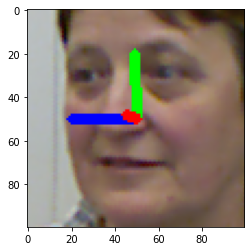

(100, 100, 3)
oPredictedAngles : [-2.2722726  8.743271  -1.187065 ]
oLabel : [2.17605, 21.7424, -1.20633]


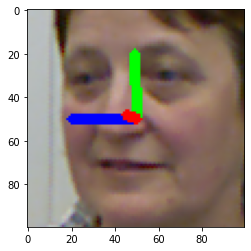

(100, 100, 3)
oPredictedAngles : [-2.356878   8.708968  -1.1884378]
oLabel : [2.17175, 19.4804, -1.83127]


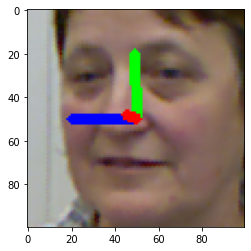

(100, 100, 3)
oPredictedAngles : [-2.3577645  8.704512  -1.1770706]
oLabel : [1.78154, 18.8387, -1.71795]


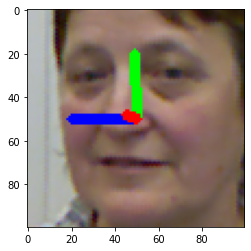

(100, 100, 3)
oPredictedAngles : [-2.2655876  8.252114  -0.9301491]
oLabel : [1.76433, 17.5191, -1.53664]


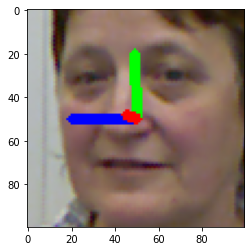

(100, 100, 3)
oPredictedAngles : [-2.3035343  8.722748  -1.1749517]
oLabel : [1.68875, 16.9273, -1.27482]


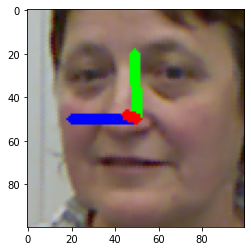

(100, 100, 3)
oPredictedAngles : [-2.1142187   6.504181   -0.03198443]
oLabel : [1.87763, 15.8833, -0.893457]


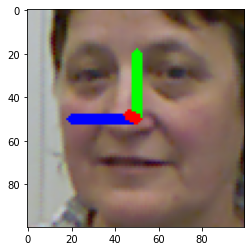

(100, 100, 3)
oPredictedAngles : [-1.8465059   6.1380205   0.13698079]
oLabel : [1.79361, 15.1025, -1.16959]


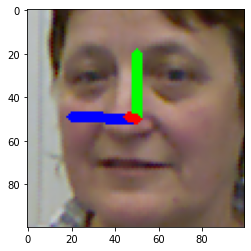

(100, 100, 3)
oPredictedAngles : [-1.7344583   5.1659884   0.63413316]
oLabel : [1.86276, 13.916, -1.33878]


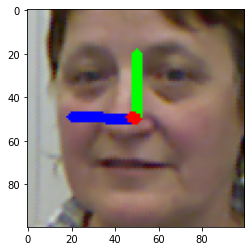

(100, 100, 3)
oPredictedAngles : [-1.6977051   4.959745    0.73843014]
oLabel : [1.88498, 13.2191, -1.73167]


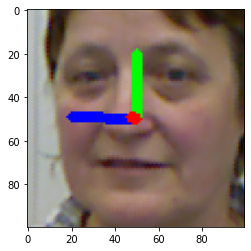

(100, 100, 3)
oPredictedAngles : [-1.8301954  4.0117326  1.2427372]
oLabel : [2.21189, 11.3434, -0.67572]


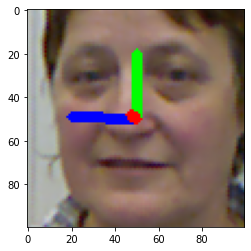

(100, 100, 3)
oPredictedAngles : [-2.1102777  3.850143   1.3558042]
oLabel : [2.1294, 9.21369, -1.18599]


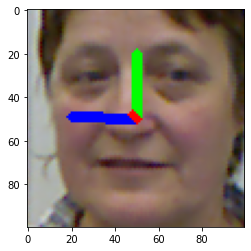

(100, 100, 3)
oPredictedAngles : [-2.9997337  3.4552767  1.6495005]
oLabel : [2.50142, 6.51227, -0.832465]


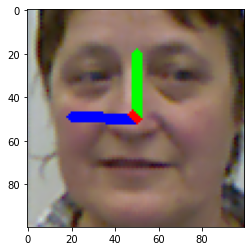

(100, 100, 3)
oPredictedAngles : [-4.446123   2.8544219  2.1046693]
oLabel : [2.7437, 4.51517, -1.61812]


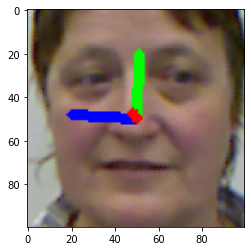

(100, 100, 3)
oPredictedAngles : [-4.6484694  2.7740908  2.1299512]
oLabel : [2.68848, 2.7354, -1.88062]


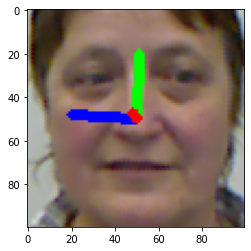

(100, 100, 3)
oPredictedAngles : [-4.6436577  2.774782   2.1273336]
oLabel : [2.35466, 1.18627, -1.74223]


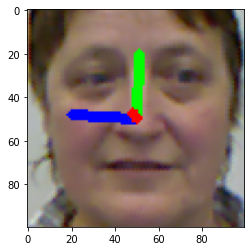

(100, 100, 3)
oPredictedAngles : [-4.65378    2.7703686  2.1328046]
oLabel : [2.29796, -0.238355, -1.9867]


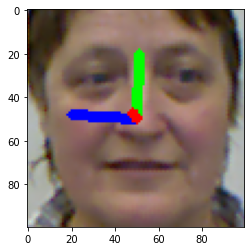

(100, 100, 3)
oPredictedAngles : [-4.6393037  2.7750573  2.1106083]
oLabel : [2.12972, -1.72424, -1.3392]


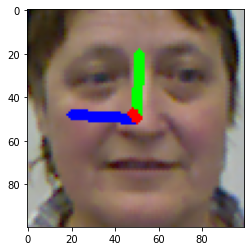

(100, 100, 3)
oPredictedAngles : [-4.8878403  2.6932437  1.9815825]
oLabel : [1.76497, -3.15992, -1.44309]


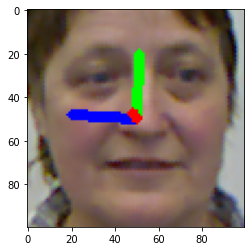

(100, 100, 3)
oPredictedAngles : [-4.615731   2.788289   2.1040342]
oLabel : [1.89845, -5.04086, -1.51537]


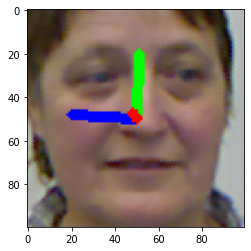

(100, 100, 3)
oPredictedAngles : [-4.5169015  2.7869985  2.099755 ]
oLabel : [2.0088, -7.32434, -1.98872]


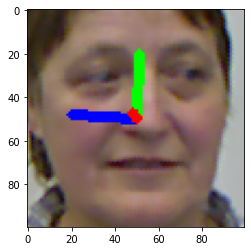

(100, 100, 3)
oPredictedAngles : [-4.167278   2.8281522  1.9798135]
oLabel : [1.85998, -9.50235, -1.73176]


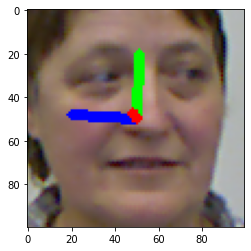

(100, 100, 3)
oPredictedAngles : [-2.5855665  2.1715608  1.2941618]
oLabel : [1.57351, -12.3522, -1.98984]


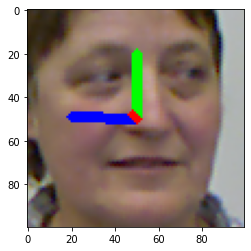

(100, 100, 3)
oPredictedAngles : [-1.0804713 -1.5683361  2.7476666]
oLabel : [1.22128, -15.4002, -2.20255]


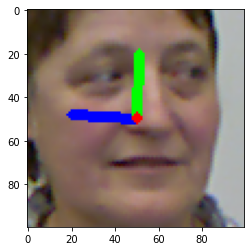

(100, 100, 3)
oPredictedAngles : [-0.14890344 -2.0453317   2.7448375 ]
oLabel : [1.76183, -18.2164, -2.51076]


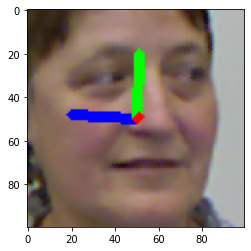

(100, 100, 3)
oPredictedAngles : [-1.8575913 -2.1148784  3.9044547]
oLabel : [2.17169, -20.6424, -3.49302]


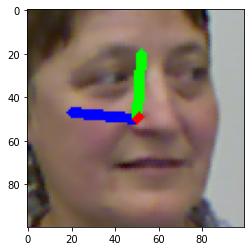

(100, 100, 3)
oPredictedAngles : [-3.3670819 -2.4928334  4.1284237]
oLabel : [2.28234, -22.9104, -3.05542]


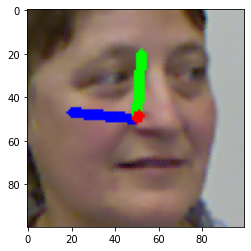

(100, 100, 3)
oPredictedAngles : [-4.906697  -3.307523   1.4990759]
oLabel : [2.56373, -26.129, -3.1883]


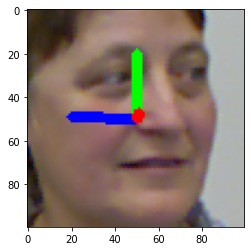

(100, 100, 3)
oPredictedAngles : [-6.237593  -3.7598915  0.7732043]
oLabel : [2.32525, -27.8943, -3.66126]


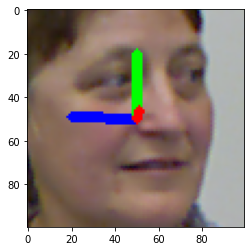

(100, 100, 3)
oPredictedAngles : [-6.7367654 -4.6427107  1.8515648]
oLabel : [2.60413, -29.7634, -4.3814]


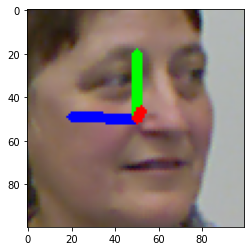

(100, 100, 3)
oPredictedAngles : [-6.9132752 -9.526454   1.9709735]
oLabel : [2.67071, -31.2273, -4.31453]


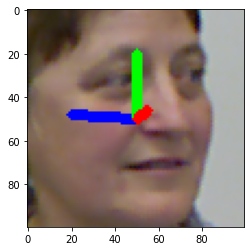

(100, 100, 3)
oPredictedAngles : [ -9.722408   -13.033217     0.68241066]
oLabel : [2.43336, -33.0762, -3.99735]


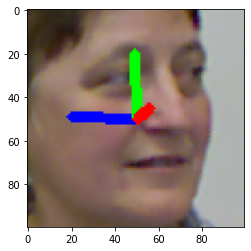

(100, 100, 3)
oPredictedAngles : [ -6.4771876 -12.992784    0.2647309]
oLabel : [2.48663, -34.1144, -4.03528]


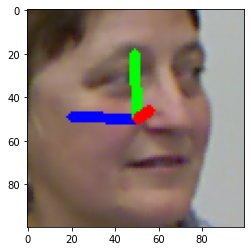

(100, 100, 3)
oPredictedAngles : [ -7.210378   -12.992374     0.37155336]
oLabel : [2.58226, -35.597, -3.34019]


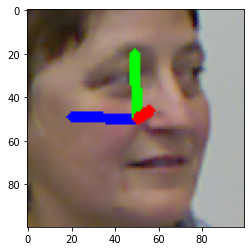

(100, 100, 3)
oPredictedAngles : [ -7.558128   -13.666694    -0.32394087]
oLabel : [3.33379, -36.9818, -4.87842]


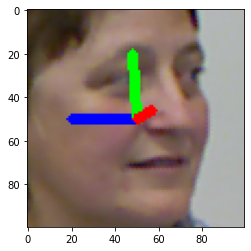

(100, 100, 3)
oPredictedAngles : [ -3.7652218  -12.8737       0.38113612]
oLabel : [3.40593, -37.4957, -3.9833]


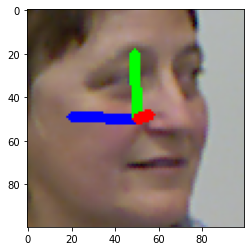

(100, 100, 3)
oPredictedAngles : [ -4.439452   -13.433835    -0.16027929]
oLabel : [4.26926, -38.3493, -4.86618]


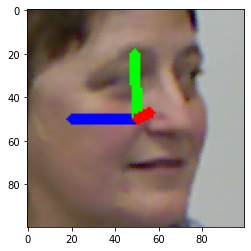

(100, 100, 3)
oPredictedAngles : [ -1.7135819  -12.560607    -0.34206477]
oLabel : [4.15899, -39.1684, -3.59045]


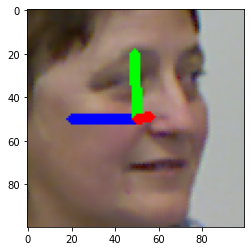

(100, 100, 3)
oPredictedAngles : [ -2.834175  -13.120758    0.4777389]
oLabel : [5.22027, -39.6443, -5.03011]


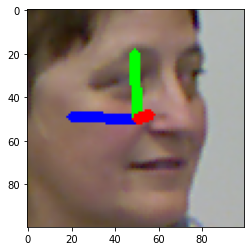

(100, 100, 3)
oPredictedAngles : [-3.8294752e+00 -1.2861972e+01 -8.1214551e-03]
oLabel : [6.33902, -40.0618, -5.00404]


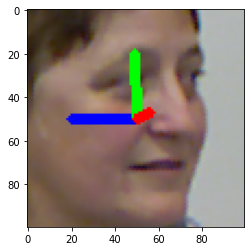

(100, 100, 3)
oPredictedAngles : [  0.5282227  -11.386344     0.37041444]
oLabel : [6.87005, -40.6834, -5.6338]


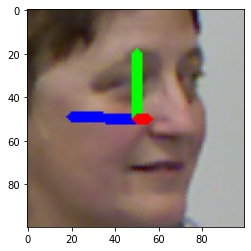

(100, 100, 3)
oPredictedAngles : [  0.68491745 -11.246344     0.6243694 ]
oLabel : [8.00065, -41.526, -6.42284]


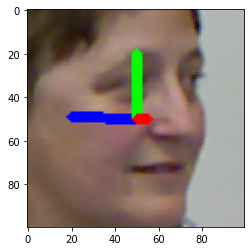

(100, 100, 3)
oPredictedAngles : [  3.3857262 -12.384722    1.177748 ]
oLabel : [8.03835, -42.393, -5.13553]


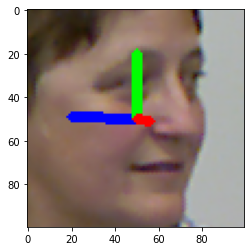

(100, 100, 3)
oPredictedAngles : [  4.4296455 -12.645525    1.1375403]
oLabel : [8.23967, -43.2343, -5.70069]


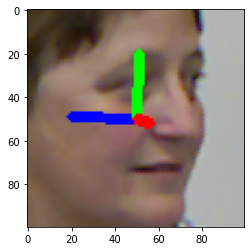

(100, 100, 3)
oPredictedAngles : [  5.0589433 -13.047324    1.2843946]
oLabel : [9.17292, -44.7781, -5.6185]


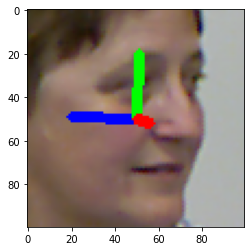

(100, 100, 3)
oPredictedAngles : [  4.1219387 -12.812337    1.2863156]
oLabel : [9.80202, -45.7368, -5.97166]


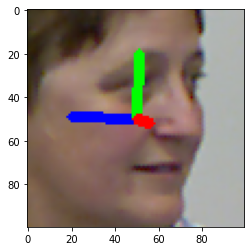

(100, 100, 3)
oPredictedAngles : [  5.422219 -13.200458   1.279861]
oLabel : [9.98304, -46.5441, -5.40409]


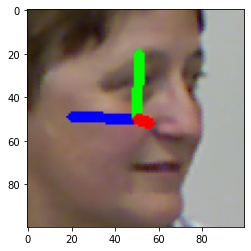

(100, 100, 3)
oPredictedAngles : [  5.5591164 -13.1491995   1.2751397]
oLabel : [10.8506, -47.2304, -5.07417]


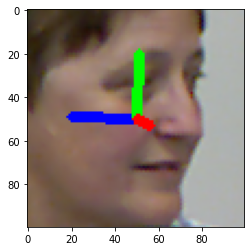

(100, 100, 3)
oPredictedAngles : [  5.49524   -13.17673     1.2710996]
oLabel : [12.2035, -48.8178, -6.16531]


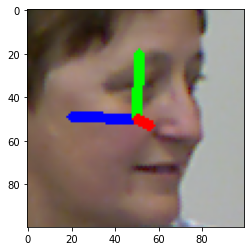

(100, 100, 3)
oPredictedAngles : [  5.0497346 -13.315407    1.1947876]
oLabel : [11.9118, -50.1249, -3.79994]


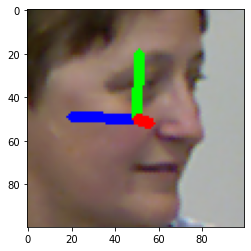

(100, 100, 3)
oPredictedAngles : [  5.346877  -13.234853    1.2123394]
oLabel : [12.9789, -51.8701, -4.05084]


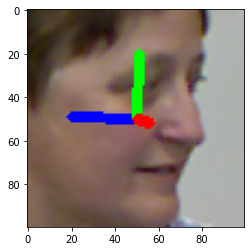

(100, 100, 3)
oPredictedAngles : [  5.521144  -13.276402    1.1967239]
oLabel : [14.0452, -52.6658, -5.44929]


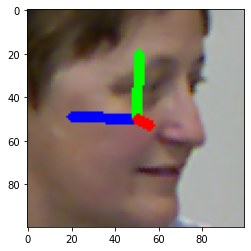

(100, 100, 3)
oPredictedAngles : [  5.053662  -13.634269    1.1861012]
oLabel : [15.2157, -53.6475, -7.93917]


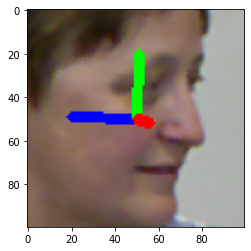

(100, 100, 3)
oPredictedAngles : [  5.126465  -14.170312    1.1794982]
oLabel : [13.7934, -56.3325, -4.04795]


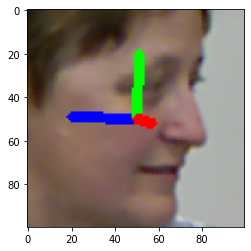

(100, 100, 3)
oPredictedAngles : [  4.2502694 -18.269852    1.0718732]
oLabel : [15.3423, -57.6683, -6.38111]


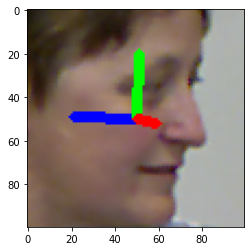

(100, 100, 3)
oPredictedAngles : [  4.09875   -24.573048    1.0146123]
oLabel : [14.8347, -59.6734, -4.61826]


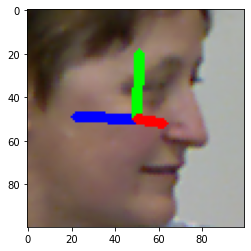

(100, 100, 3)
oPredictedAngles : [  7.295649  -29.663809    3.1325684]
oLabel : [14.7783, -61.5774, -4.27335]


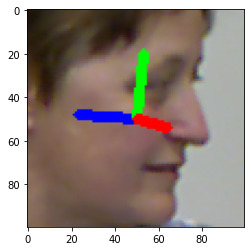

(100, 100, 3)
oPredictedAngles : [  7.379403  -27.926062    3.3712082]
oLabel : [14.8433, -62.7784, -4.58967]


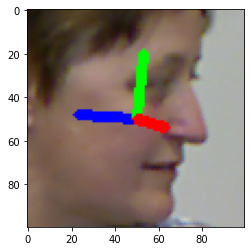

(100, 100, 3)
oPredictedAngles : [  7.766367 -32.778038   8.037032]
oLabel : [16.2274, -63.1354, -5.76904]


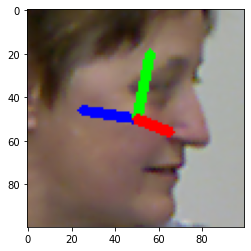

(100, 100, 3)
oPredictedAngles : [  7.0150123 -33.955055    8.470042 ]
oLabel : [15.4505, -64.4827, -4.27382]


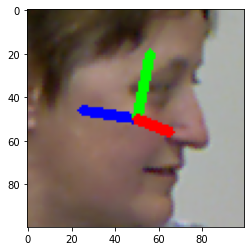

(100, 100, 3)
oPredictedAngles : [  7.6468563 -31.757893    8.040097 ]
oLabel : [17.1454, -64.0472, -6.22959]


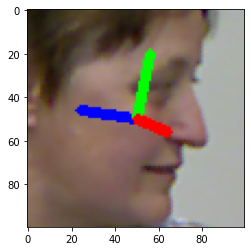

(100, 100, 3)
oPredictedAngles : [  7.470388 -33.452938  10.716239]
oLabel : [17.3603, -65.0052, -5.92411]


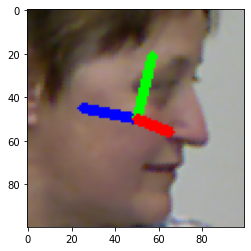

(100, 100, 3)
oPredictedAngles : [ 10.309488 -33.655758  10.036078]
oLabel : [20.8463, -66.1033, -9.49524]


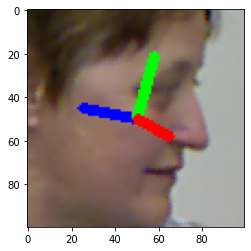

(100, 100, 3)
oPredictedAngles : [ 11.930592 -34.472195  11.089969]
oLabel : [17.1873, -66.563, -3.15071]


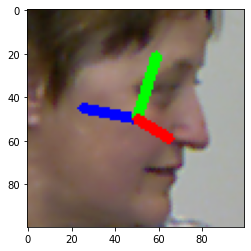

(100, 100, 3)
oPredictedAngles : [ 16.943857 -36.21619   12.167398]
oLabel : [17.9393, -66.3626, -3.77575]


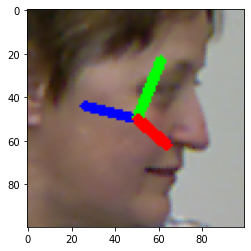

(100, 100, 3)
oPredictedAngles : [ 18.118889 -37.85438   11.651063]
oLabel : [19.267, -66.4374, -4.88554]


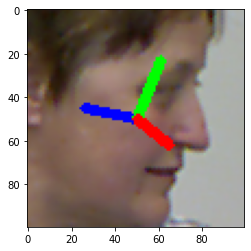

(100, 100, 3)
oPredictedAngles : [ 20.89675  -38.618     14.449423]
oLabel : [18.7618, -66.8007, -4.03319]


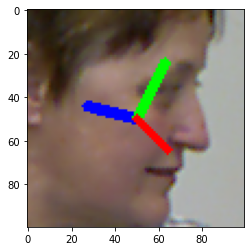

(100, 100, 3)
oPredictedAngles : [ 14.042204 -28.640938   9.845439]
oLabel : [16.2255, -66.9504, -1.20918]


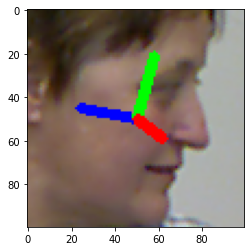

(100, 100, 3)
oPredictedAngles : [ 21.836212 -38.598156  14.856062]
oLabel : [17.9546, -66.5234, -1.67932]


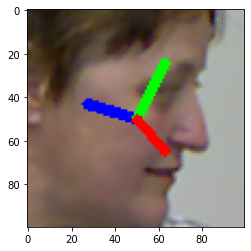

(100, 100, 3)
oPredictedAngles : [ 21.876581 -38.43992   14.09293 ]
oLabel : [19.0885, -66.1775, -4.26445]


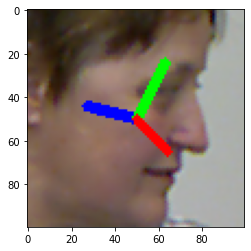

(100, 100, 3)
oPredictedAngles : [ 17.258938 -36.643272  13.673251]
oLabel : [17.7105, -64.6947, -0.648899]


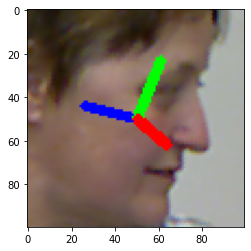

(100, 100, 3)
oPredictedAngles : [ 18.72433  -38.82434   15.243783]
oLabel : [19.7491, -64.0583, -3.23039]


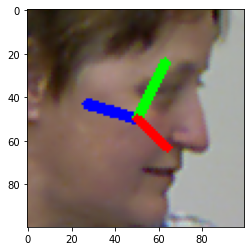

(100, 100, 3)
oPredictedAngles : [ 22.485888 -33.52033   15.75116 ]
oLabel : [21.4182, -62.7853, -3.64561]


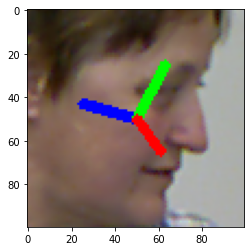

(100, 100, 3)
oPredictedAngles : [ 25.263666 -33.20237   12.148644]
oLabel : [22.9769, -62.9377, -3.92086]


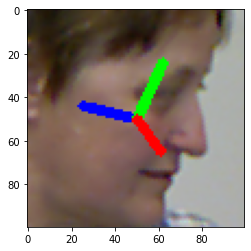

(100, 100, 3)
oPredictedAngles : [ 26.315304 -34.97238   17.783283]
oLabel : [25.5776, -60.8023, -6.21616]


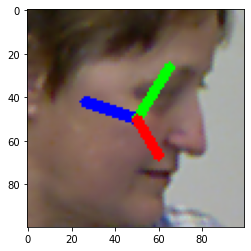

(100, 100, 3)
oPredictedAngles : [ 25.60726  -36.88218   19.507961]
oLabel : [26.2749, -60.6541, -5.76827]


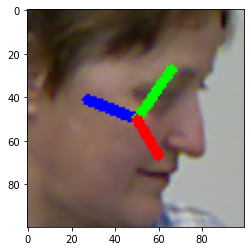

(100, 100, 3)
oPredictedAngles : [ 28.328924 -35.263527  20.047228]
oLabel : [26.824, -60.22, -5.10677]


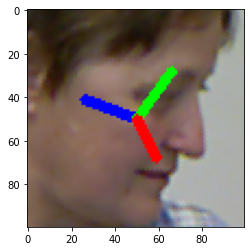

(100, 100, 3)
oPredictedAngles : [ 27.229342 -33.94766   18.663166]
oLabel : [27.0798, -60.0692, -3.71794]


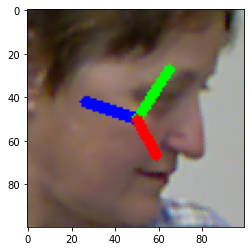

(100, 100, 3)
oPredictedAngles : [ 29.211351 -31.437809  17.096228]
oLabel : [28.6662, -58.7411, -5.16965]


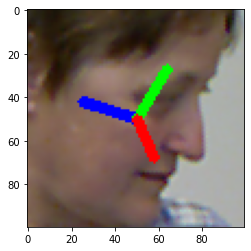

(100, 100, 3)
oPredictedAngles : [ 27.862822 -36.176018  17.498108]
oLabel : [29.6272, -59.2561, -5.41517]


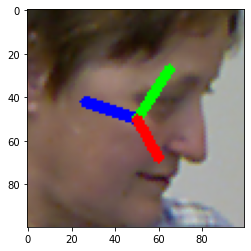

(100, 100, 3)
oPredictedAngles : [ 31.662067 -28.349686  15.192485]
oLabel : [30.7398, -58.8817, -6.85353]


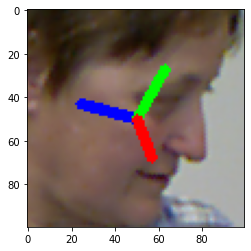

(100, 100, 3)
oPredictedAngles : [ 30.763004 -31.913532  15.945632]
oLabel : [31.4271, -58.1417, -7.21177]


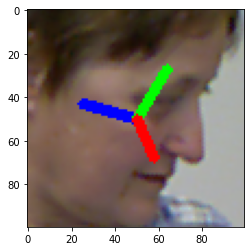

(100, 100, 3)
oPredictedAngles : [ 31.49165  -28.157297  14.790796]
oLabel : [31.6385, -58.1676, -7.15355]


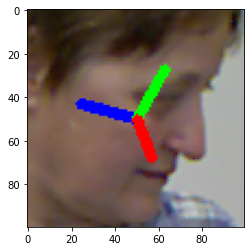

(100, 100, 3)
oPredictedAngles : [ 31.877     -28.189014   14.8112335]
oLabel : [34.0789, -57.5981, -9.82534]


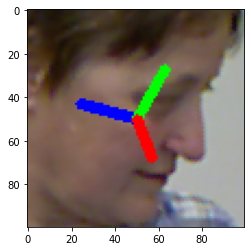

(100, 100, 3)
oPredictedAngles : [ 30.822859 -31.41539   15.087199]
oLabel : [33.521, -56.5822, -7.92928]


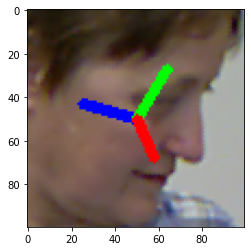

(100, 100, 3)
oPredictedAngles : [ 30.52602  -30.809107  12.226996]
oLabel : [34.8589, -55.625, -8.58187]


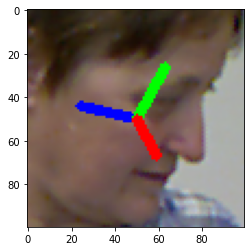

(100, 100, 3)
oPredictedAngles : [ 31.0148   -27.755379   8.651679]
oLabel : [34.3918, -53.815, -7.55821]


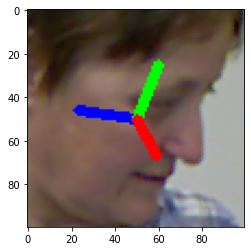

(100, 100, 3)
oPredictedAngles : [ 29.788961 -31.597454  10.788353]
oLabel : [36.1976, -53.0942, -8.13754]


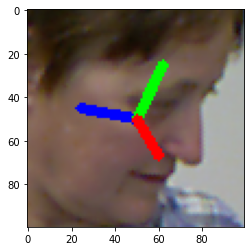

(100, 100, 3)
oPredictedAngles : [ 28.789099 -34.056313  11.023604]
oLabel : [37.1553, -51.4772, -8.30481]


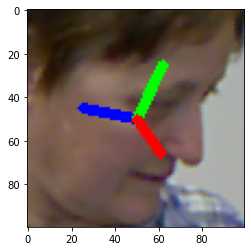

(100, 100, 3)
oPredictedAngles : [ 30.486233  -29.115173    9.5542345]
oLabel : [37.2579, -50.4729, -8.07771]


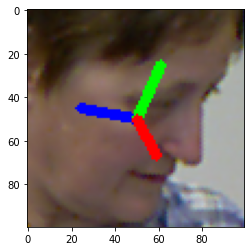

(100, 100, 3)
oPredictedAngles : [ 32.227642 -23.029129   9.065295]
oLabel : [37.5632, -49.0902, -9.104]


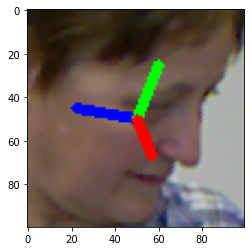

(100, 100, 3)
oPredictedAngles : [ 32.412323 -22.356422   9.312548]
oLabel : [38.368, -48.0105, -9.35137]


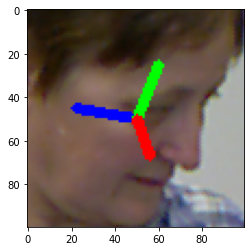

(100, 100, 3)
oPredictedAngles : [ 32.381363  -22.063055    7.6211247]
oLabel : [38.1816, -46.8993, -10.2485]


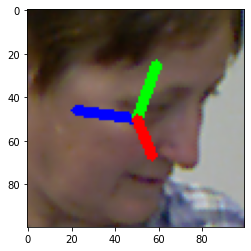

(100, 100, 3)
oPredictedAngles : [ 32.928    -20.000872   8.041103]
oLabel : [38.5337, -46.5327, -9.99835]


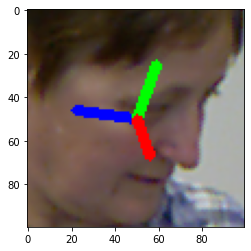

(100, 100, 3)
oPredictedAngles : [ 32.960026 -19.775984   8.547089]
oLabel : [38.7036, -46.8777, -10.0649]


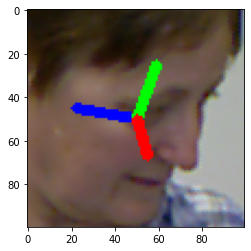

(100, 100, 3)
oPredictedAngles : [ 33.04726  -19.36609    4.684213]
oLabel : [37.0341, -41.7583, -9.29726]


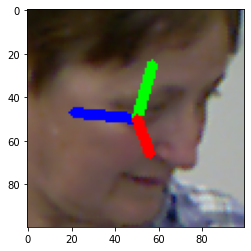

(100, 100, 3)
oPredictedAngles : [ 33.273273  -17.945913    1.7031687]
oLabel : [36.7135, -38.4953, -7.7963]


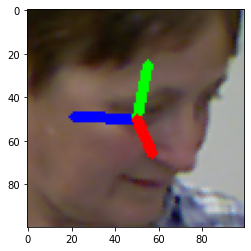

(100, 100, 3)
oPredictedAngles : [ 32.969     -18.728048    1.6505046]
oLabel : [37.1227, -35.6032, -8.14075]


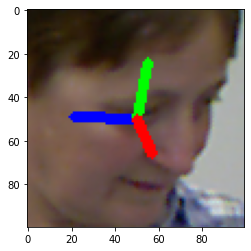

(100, 100, 3)
oPredictedAngles : [ 27.632238  -11.407059    2.0732982]
oLabel : [35.2118, -33.4087, -6.15528]


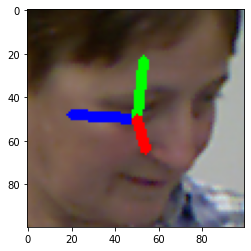

(100, 100, 3)
oPredictedAngles : [ 27.623304  -11.319458    2.2963774]
oLabel : [35.3741, -29.7133, -6.2148]


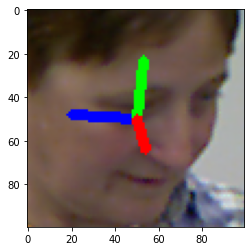

(100, 100, 3)
oPredictedAngles : [ 27.049467  -11.456033    2.1677375]
oLabel : [35.8048, -27.8323, -6.64253]


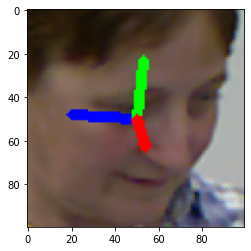

(100, 100, 3)
oPredictedAngles : [ 27.308733  -11.55683     1.7849381]
oLabel : [35.4923, -25.3445, -6.64618]


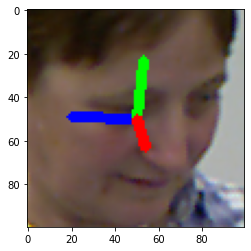

(100, 100, 3)
oPredictedAngles : [ 25.261889  -11.943655    0.5739933]
oLabel : [35.9029, -22.9157, -6.75469]


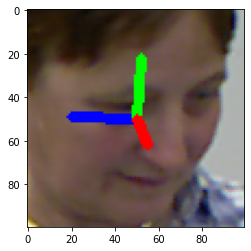

(100, 100, 3)
oPredictedAngles : [16.301723  -1.8483615  1.2499772]
oLabel : [35.0265, -20.6543, -5.78859]


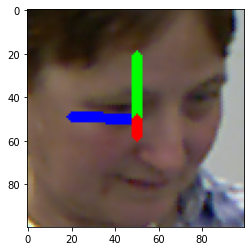

(100, 100, 3)
oPredictedAngles : [14.000247  -1.9228412  1.659172 ]
oLabel : [35.3742, -18.5291, -5.88824]


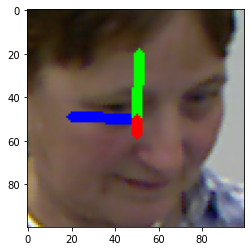

(100, 100, 3)
oPredictedAngles : [15.363319   -2.1194654   0.53300196]
oLabel : [35.0295, -16.1499, -5.97646]


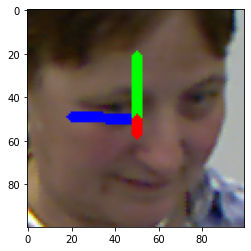

(100, 100, 3)
oPredictedAngles : [12.229727   -2.8077476  -0.03030591]
oLabel : [34.2063, -13.4196, -4.84686]


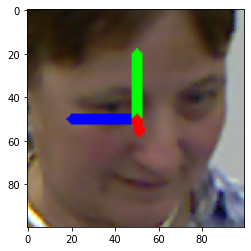

(100, 100, 3)
oPredictedAngles : [12.094723   -2.850942   -0.12128744]
oLabel : [33.3184, -10.4492, -4.05014]


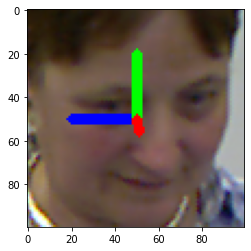

(100, 100, 3)
oPredictedAngles : [11.910846  -1.9979604  1.4071586]
oLabel : [32.9735, -7.17129, -3.89761]


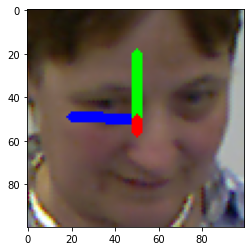

(100, 100, 3)
oPredictedAngles : [11.99221    1.0415038 -2.262579 ]
oLabel : [32.0447, -4.71244, -2.29604]


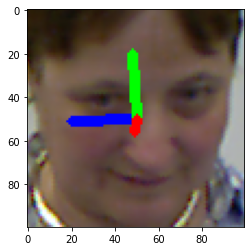

(100, 100, 3)
oPredictedAngles : [12.997376   1.4715834 -2.2989037]
oLabel : [31.548, -2.25615, -1.96476]


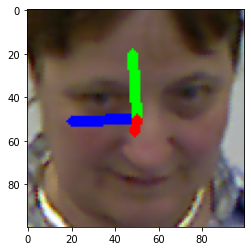

(100, 100, 3)
oPredictedAngles : [10.896902   1.5483278 -2.1146817]
oLabel : [31.3873, -1.23817, -1.23464]


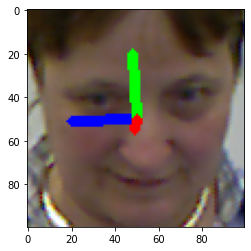

(100, 100, 3)
oPredictedAngles : [10.718396   1.7652165 -2.023794 ]
oLabel : [31.0662, 0.455216, -1.68977]


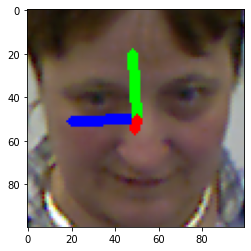

(100, 100, 3)
oPredictedAngles : [ 9.627482   2.0139093 -2.7441826]
oLabel : [31.1565, 1.70561, -2.02856]


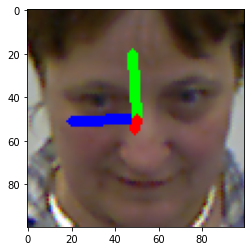

(100, 100, 3)
oPredictedAngles : [ 8.058244   2.9162164 -2.897877 ]
oLabel : [30.8918, 2.43029, -1.72499]


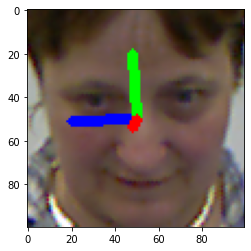

(100, 100, 3)
oPredictedAngles : [ 7.4935746  3.2668438 -2.9266887]
oLabel : [30.8743, 3.30412, -1.74708]


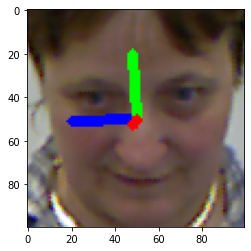

(100, 100, 3)
oPredictedAngles : [ 7.058591   3.4117918 -2.9989572]
oLabel : [30.7671, 4.36397, -1.24904]


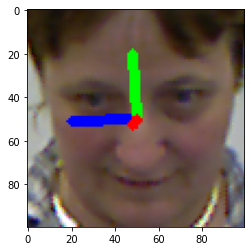

(100, 100, 3)
oPredictedAngles : [ 7.138355   3.6326573 -3.1273577]
oLabel : [30.7286, 6.32004, -1.62282]


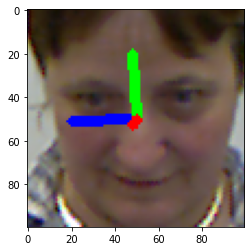

(100, 100, 3)
oPredictedAngles : [ 6.673427   6.422686  -4.5223436]
oLabel : [30.335, 7.73873, -0.760092]


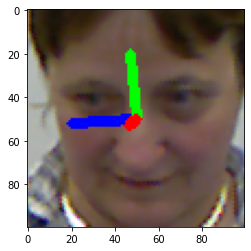

(100, 100, 3)
oPredictedAngles : [ 6.9952374  7.177782  -4.92964  ]
oLabel : [30.2975, 9.84597, 0.288831]


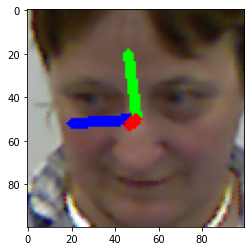

(100, 100, 3)
oPredictedAngles : [11.175701   3.984651  -3.9626644]
oLabel : [30.2554, 11.8919, 0.7414]


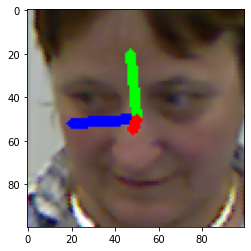

(100, 100, 3)
oPredictedAngles : [17.509687   5.8335347 -4.4357967]
oLabel : [29.7852, 14.4148, -0.16687]


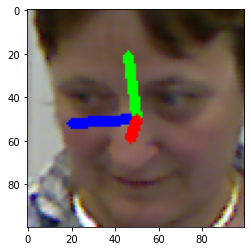

(100, 100, 3)
oPredictedAngles : [14.877574   6.0280514 -4.900403 ]
oLabel : [29.8099, 16.2094, 0.793313]


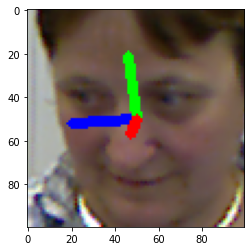

(100, 100, 3)
oPredictedAngles : [ 7.6099873  4.8248496 -5.0375805]
oLabel : [29.52, 18.0575, 1.45163]


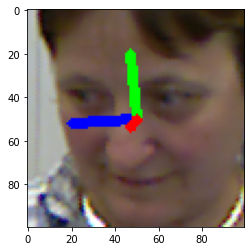

(100, 100, 3)
oPredictedAngles : [ 3.0766823  5.2454906 -5.594354 ]
oLabel : [28.9979, 19.8986, 1.0037]


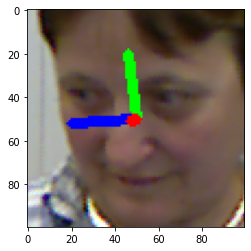

(100, 100, 3)
oPredictedAngles : [ 7.0070643  5.5932655 -5.359153 ]
oLabel : [29.0314, 22.1217, 1.9836]


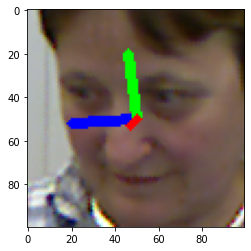

(100, 100, 3)
oPredictedAngles : [ 1.499245   6.156115  -6.2552705]
oLabel : [28.558, 24.1145, 2.13516]


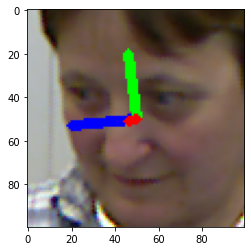

(100, 100, 3)
oPredictedAngles : [ 2.0064993  6.652277  -6.1313434]
oLabel : [28.5622, 26.4031, 2.663]


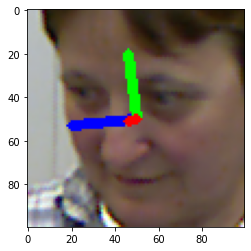

(100, 100, 3)
oPredictedAngles : [ 2.7304125  6.9997497 -5.938988 ]
oLabel : [28.4136, 27.9457, 3.79564]


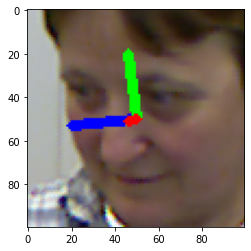

(100, 100, 3)
oPredictedAngles : [ 5.707939 14.797874 -6.098391]
oLabel : [28.5887, 30.3754, 4.37778]


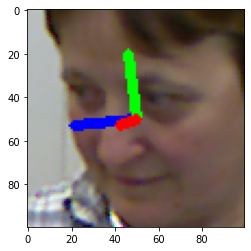

(100, 100, 3)
oPredictedAngles : [ 6.184553  15.45195   -6.1617055]
oLabel : [28.6083, 32.5547, 5.54461]


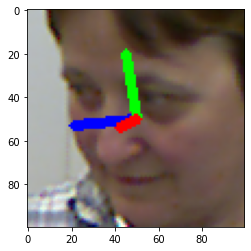

(100, 100, 3)
oPredictedAngles : [11.694749 17.045605 -6.062073]
oLabel : [28.8053, 34.9663, 5.53709]


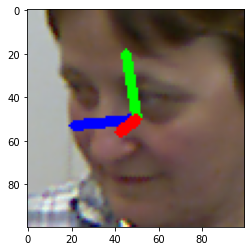

(100, 100, 3)
oPredictedAngles : [15.886952 19.380089 -6.301497]
oLabel : [28.3345, 37.567, 5.61733]


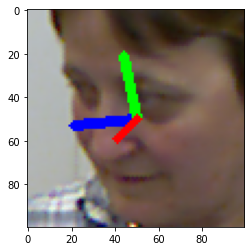

(100, 100, 3)
oPredictedAngles : [16.276703  19.803802  -5.7962008]
oLabel : [28.7229, 40.2987, 6.19578]


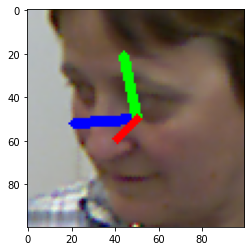

(100, 100, 3)
oPredictedAngles : [16.335274 19.64067  -6.216731]
oLabel : [29.2448, 41.7018, 7.55254]


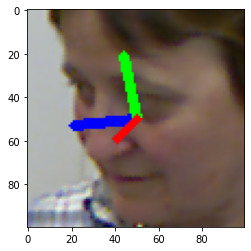

(100, 100, 3)
oPredictedAngles : [16.395252  19.749434  -6.0736094]
oLabel : [28.8784, 43.5054, 6.95321]


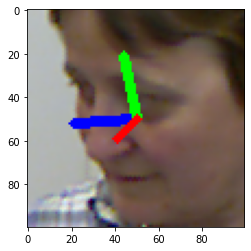

(100, 100, 3)
oPredictedAngles : [17.729258 19.848238 -6.367786]
oLabel : [28.3092, 44.4651, 6.00408]


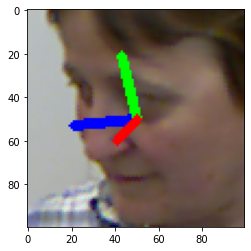

(100, 100, 3)
oPredictedAngles : [18.046211  19.782139  -6.3819494]
oLabel : [28.3301, 47.1115, 5.52954]


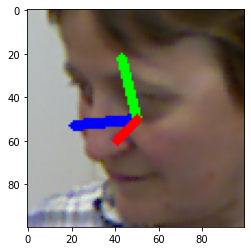

(100, 100, 3)
oPredictedAngles : [18.130579  19.81682   -6.3924255]
oLabel : [28.7382, 47.7745, 6.94844]


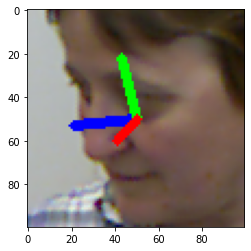

(100, 100, 3)
oPredictedAngles : [19.946178 20.005976 -6.443276]
oLabel : [28.4276, 49.1796, 6.85629]


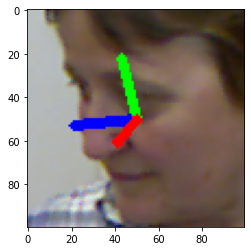

(100, 100, 3)
oPredictedAngles : [19.063696  19.87734   -6.4134984]
oLabel : [27.3078, 49.7937, 5.72358]


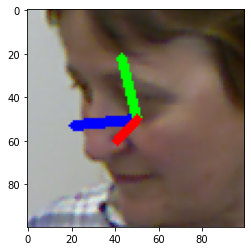

(100, 100, 3)
oPredictedAngles : [20.887676  20.122427  -6.4579444]
oLabel : [27.6624, 50.5713, 6.59091]


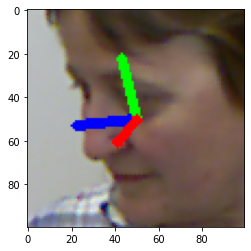

(100, 100, 3)
oPredictedAngles : [19.890608  20.00586   -6.5881033]
oLabel : [27.8749, 52.0066, 6.85697]


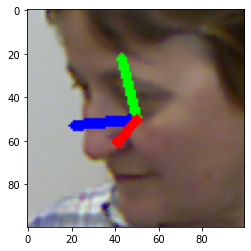

(100, 100, 3)
oPredictedAngles : [18.347696 19.96525  -6.275906]
oLabel : [27.3392, 53.8747, 5.72474]


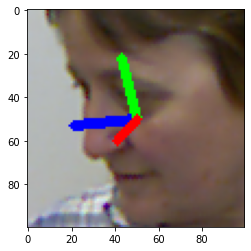

(100, 100, 3)
oPredictedAngles : [14.453412 20.861664 -5.200947]
oLabel : [26.6813, 53.3402, 5.32277]


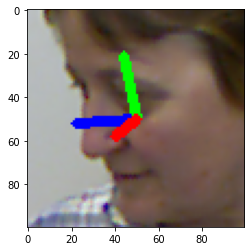

(100, 100, 3)
oPredictedAngles : [19.174284  20.80713   -6.3162417]
oLabel : [26.0346, 54.8768, 4.21686]


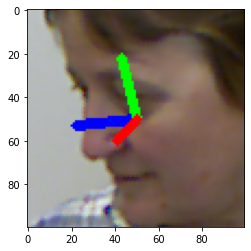

(100, 100, 3)
oPredictedAngles : [10.032571  29.255495  -3.7561963]
oLabel : [25.3811, 53.8823, 2.63626]


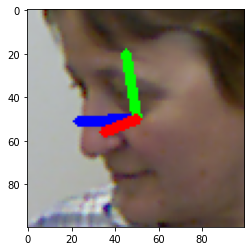

(100, 100, 3)
oPredictedAngles : [ 8.610494  30.06818   -3.2884068]
oLabel : [25.3672, 54.0897, 3.07781]


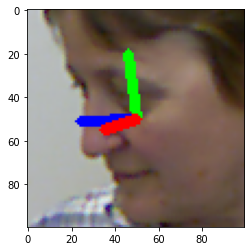

(100, 100, 3)
oPredictedAngles : [15.242685 25.961514 -5.515875]
oLabel : [26.0428, 56.231, 4.19255]


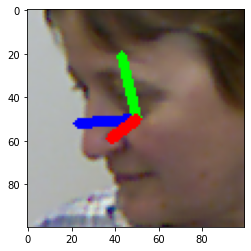

(100, 100, 3)
oPredictedAngles : [17.280903  30.816887  -6.0615354]
oLabel : [25.6671, 56.4559, 4.00543]


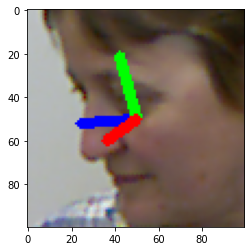

(100, 100, 3)
oPredictedAngles : [16.478212  31.223404  -5.8784637]
oLabel : [24.7806, 56.4929, 2.86451]


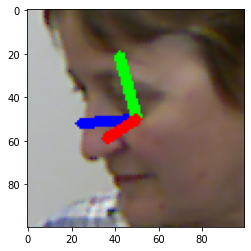

(100, 100, 3)
oPredictedAngles : [10.111905  30.90609   -3.8625815]
oLabel : [24.5469, 56.1271, 3.08048]


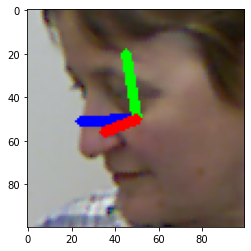

(100, 100, 3)
oPredictedAngles : [ 9.502266 31.162863 -3.60661 ]
oLabel : [23.1367, 56.9491, 1.65875]


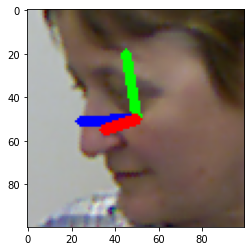

(100, 100, 3)
oPredictedAngles : [10.566367  31.95978   -4.3238225]
oLabel : [23.1504, 58.3148, 1.8612]


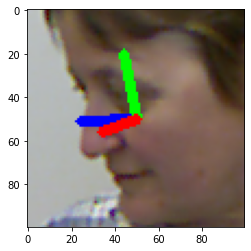

(100, 100, 3)
oPredictedAngles : [14.435618 31.061087 -5.53316 ]
oLabel : [23.4602, 59.1457, 1.76368]


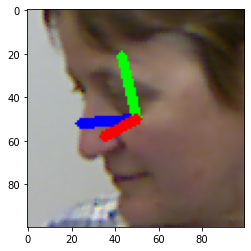

(100, 100, 3)
oPredictedAngles : [10.247885  30.548811  -3.8968964]
oLabel : [22.814, 59.8853, 0.660331]


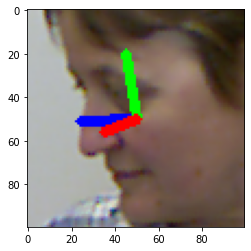

(100, 100, 3)
oPredictedAngles : [10.666174 31.205406 -4.669681]
oLabel : [22.5432, 60.8737, 1.19296]


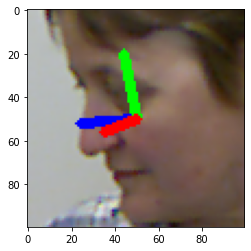

(100, 100, 3)
oPredictedAngles : [10.41748  30.422804 -3.930588]
oLabel : [21.3964, 61.8523, 0.417158]


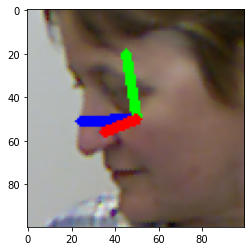

(100, 100, 3)
oPredictedAngles : [10.8772   31.464392 -5.65559 ]
oLabel : [22.7669, 62.3171, 2.03581]


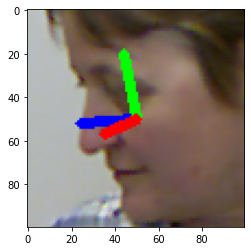

(100, 100, 3)
oPredictedAngles : [10.489861 30.592112 -4.067366]
oLabel : [22.5181, 64.1, 2.06607]


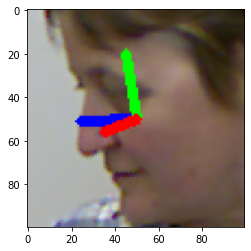

(100, 100, 3)
oPredictedAngles : [10.495474 30.531988 -4.225531]
oLabel : [21.7333, 64.5531, 1.24215]


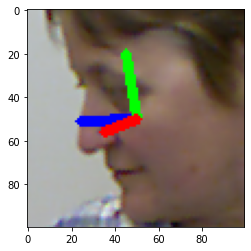

(100, 100, 3)
oPredictedAngles : [10.6405325 31.102537  -4.6808076]
oLabel : [20.5558, 65.1905, -0.623351]


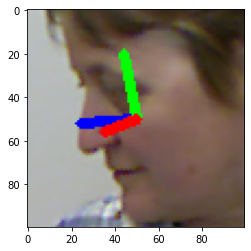

(100, 100, 3)
oPredictedAngles : [10.400965 30.479572 -4.143608]
oLabel : [20.5148, 66.1226, -0.631985]


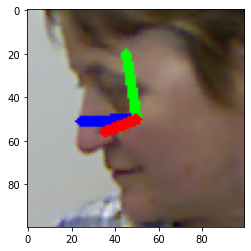

(100, 100, 3)
oPredictedAngles : [10.926118  31.388842  -6.4108567]
oLabel : [20.672, 65.9227, 0.711992]


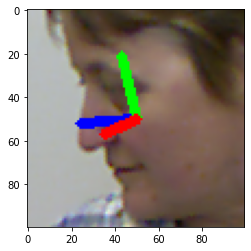

(100, 100, 3)
oPredictedAngles : [10.408333 30.449429 -4.097149]
oLabel : [20.5063, 66.5391, -0.550737]


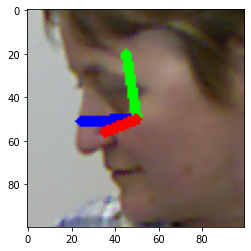

(100, 100, 3)
oPredictedAngles : [10.422965 30.441587 -4.230519]
oLabel : [21.3365, 65.5641, 0.429631]


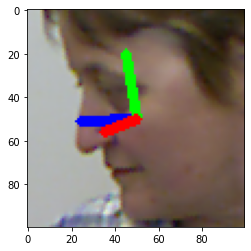

(100, 100, 3)
oPredictedAngles : [ 11.455571  32.058666 -11.094657]
oLabel : [22.1214, 64.9602, 1.2797]


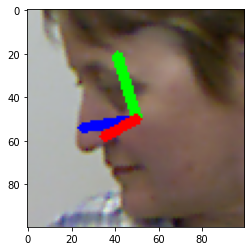

(100, 100, 3)
oPredictedAngles : [10.531774 30.751293 -4.274543]
oLabel : [23.2017, 63.9931, 1.90724]


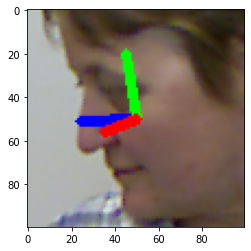

(100, 100, 3)
oPredictedAngles : [12.370207  34.9426    -6.4510183]
oLabel : [26.0399, 63.5638, 3.89412]


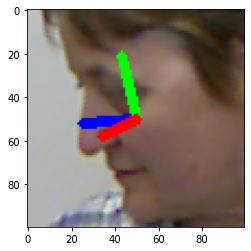

(100, 100, 3)
oPredictedAngles : [13.258549 32.186443 -4.717139]
oLabel : [26.8479, 63.1182, 1.86243]


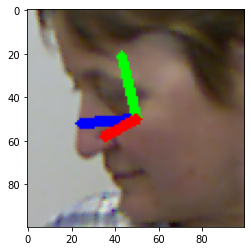

(100, 100, 3)
oPredictedAngles : [19.024435 35.338905 -6.312975]
oLabel : [29.1286, 60.8475, 2.76604]


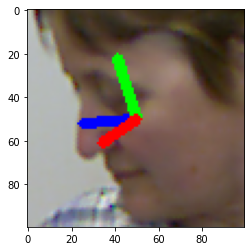

(100, 100, 3)
oPredictedAngles : [26.453138 39.36629  -8.675744]
oLabel : [31.4544, 59.1391, 2.65052]


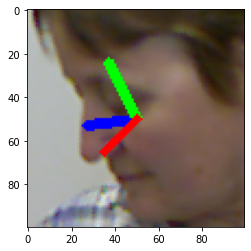

(100, 100, 3)
oPredictedAngles : [ 26.817223  40.11359  -13.218829]
oLabel : [33.9608, 56.5647, 1.77829]


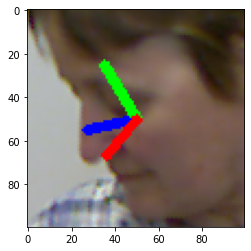

(100, 100, 3)
oPredictedAngles : [ 30.3714     53.167557  -13.0890665]
oLabel : [38.3141, 53.3492, 3.42392]


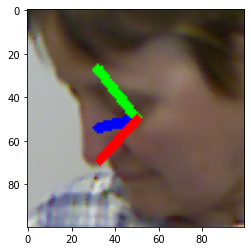

(100, 100, 3)
oPredictedAngles : [ 34.171482  54.303894 -13.542382]
oLabel : [40.9222, 49.208, 3.63777]


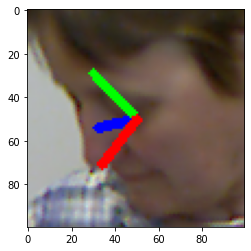

(100, 100, 3)
oPredictedAngles : [ 35.123123  50.918762 -18.552572]
oLabel : [44.3908, 45.4676, 5.49609]


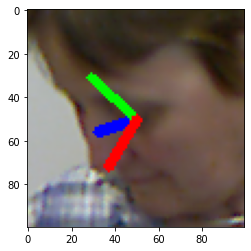

(100, 100, 3)
oPredictedAngles : [ 36.265312  35.922188 -20.435143]
oLabel : [45.733, 42.632, 4.92965]


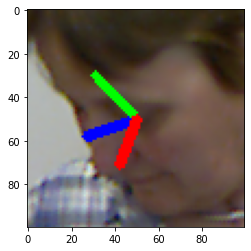

(100, 100, 3)
oPredictedAngles : [ 36.69543   34.099983 -20.759464]
oLabel : [47.0109, 40.7357, 5.32361]


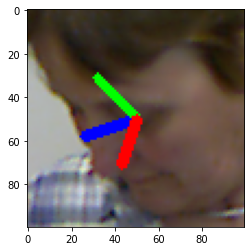

(100, 100, 3)
oPredictedAngles : [ 42.1759    32.929897 -15.543787]
oLabel : [48.6079, 38.7358, 5.18732]


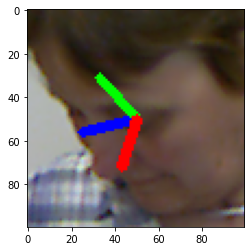

(100, 100, 3)
oPredictedAngles : [ 37.052494  31.340319 -20.217674]
oLabel : [49.1558, 37.346, 5.23018]


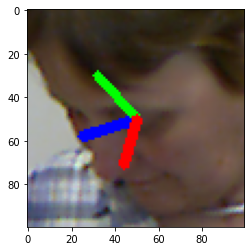

(100, 100, 3)
oPredictedAngles : [ 36.4467    32.45861  -21.142479]
oLabel : [49.9636, 35.4323, 5.46731]


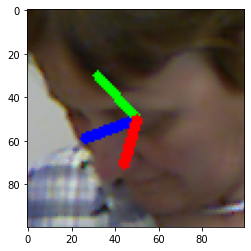

(100, 100, 3)
oPredictedAngles : [ 36.919777  22.969147 -21.091576]
oLabel : [50.5515, 35.2484, 5.74023]


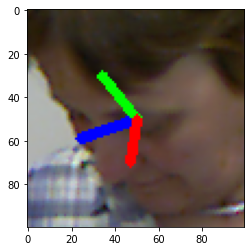

(100, 100, 3)
oPredictedAngles : [ 36.91588   18.980694 -20.4662  ]
oLabel : [50.7684, 33.389, 5.12283]


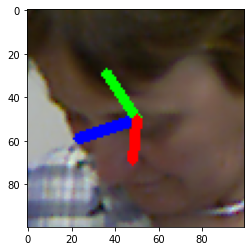

(100, 100, 3)
oPredictedAngles : [ 36.80532   17.909916 -20.545689]
oLabel : [51.1664, 31.7282, 4.61238]


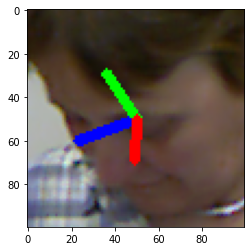

(100, 100, 3)
oPredictedAngles : [ 36.96882   17.662098 -20.554495]
oLabel : [50.212, 27.2752, 3.71054]


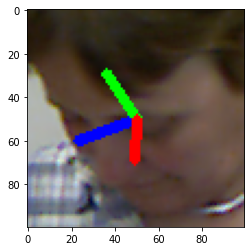

(100, 100, 3)
oPredictedAngles : [ 36.97278   17.64894  -20.567787]
oLabel : [50.8485, 25.8507, 3.63645]


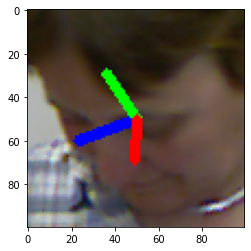

(100, 100, 3)
oPredictedAngles : [ 36.977966  17.657711 -20.51622 ]
oLabel : [51.4365, 23.0659, 3.85277]


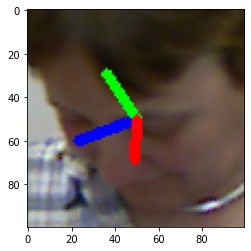

(100, 100, 3)
oPredictedAngles : [ 36.98187   17.629168 -20.514994]
oLabel : [51.4164, 20.1268, 3.27135]


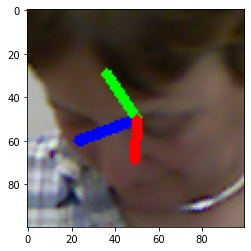

(100, 100, 3)
oPredictedAngles : [ 36.881504  16.945461 -18.428925]
oLabel : [51.6707, 17.2091, 1.54616]


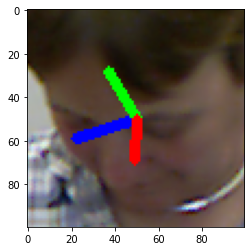

(100, 100, 3)
oPredictedAngles : [ 35.86658    9.14941  -13.925293]
oLabel : [51.5537, 13.9519, 1.72469]


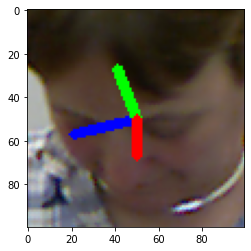

(100, 100, 3)
oPredictedAngles : [ 36.47537   10.265605 -12.819691]
oLabel : [51.435, 12.4455, 1.20833]


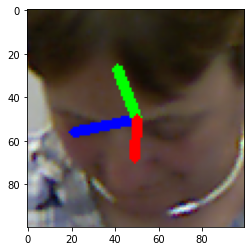

(100, 100, 3)
oPredictedAngles : [ 37.17844   10.591607 -17.216211]
oLabel : [50.6746, 9.37062, 1.17558]


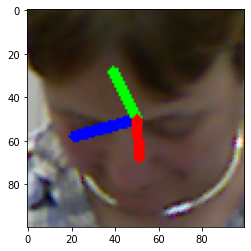

(100, 100, 3)
oPredictedAngles : [ 37.35159    9.841386 -17.695074]
oLabel : [50.2679, 7.57426, 0.199406]


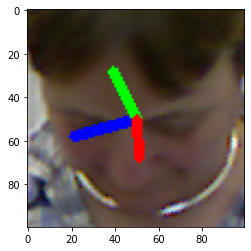

(100, 100, 3)
oPredictedAngles : [ 37.411713   9.933159 -13.116808]
oLabel : [49.4397, 4.6359, -0.647081]


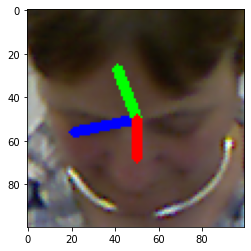

(100, 100, 3)
oPredictedAngles : [ 37.843655   8.342983 -16.856747]
oLabel : [48.9724, 1.48974, -1.45659]


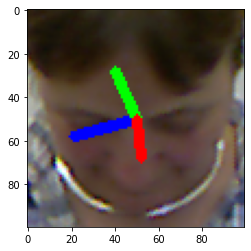

(100, 100, 3)
oPredictedAngles : [ 35.508804   4.050393 -16.375937]
oLabel : [49.2969, -0.73607, -2.54612]


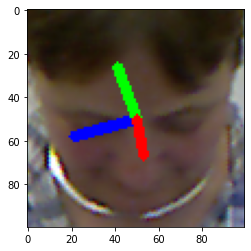

(100, 100, 3)
oPredictedAngles : [30.942562   1.1530062 -9.678202 ]
oLabel : [49.1702, -3.97102, -3.34133]


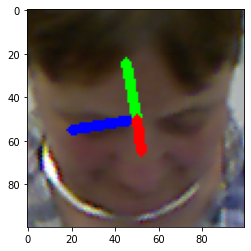

(100, 100, 3)
oPredictedAngles : [27.89527    -0.90440553 -9.008388  ]
oLabel : [49.8178, -6.46533, -4.66136]


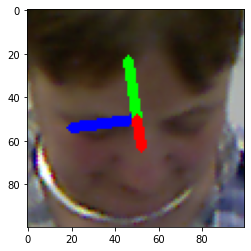

(100, 100, 3)
oPredictedAngles : [31.698397  2.889622 -1.76884 ]
oLabel : [49.0487, -8.98373, -4.96319]


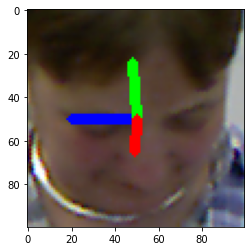

(100, 100, 3)
oPredictedAngles : [31.9711      3.326363   -0.10590415]
oLabel : [49.406, -11.2502, -5.92465]


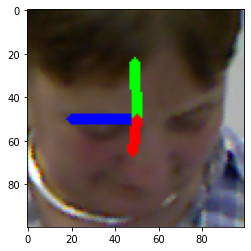

(100, 100, 3)
oPredictedAngles : [32.31127    3.1202803  1.75599  ]
oLabel : [49.5486, -13.1907, -6.82702]


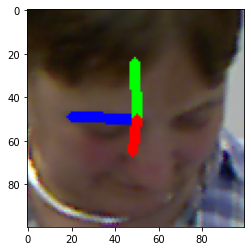

(100, 100, 3)
oPredictedAngles : [33.02141    1.8067869  2.3259232]
oLabel : [49.5992, -15.8757, -7.31321]


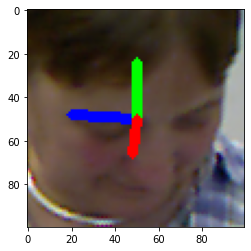

(100, 100, 3)
oPredictedAngles : [37.015522   -0.97695833  3.8352923 ]
oLabel : [49.2533, -17.6055, -9.1286]


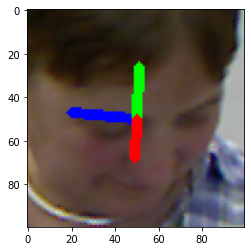

(100, 100, 3)
oPredictedAngles : [34.005962  -3.6928685  2.2566888]
oLabel : [49.7161, -20.5644, -9.71665]


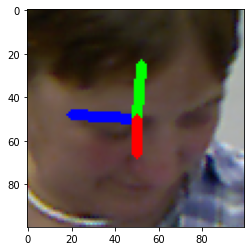

(100, 100, 3)
oPredictedAngles : [30.887354  -4.991312   2.2039769]
oLabel : [50.2336, -23.2615, -10.7181]


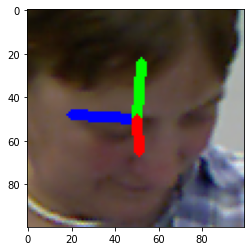

(100, 100, 3)
oPredictedAngles : [29.886356  -3.7396595  2.4394374]
oLabel : [49.9383, -24.7045, -12.1775]


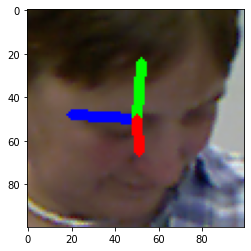

(100, 100, 3)
oPredictedAngles : [41.791252  -5.256694   2.4352078]
oLabel : [48.2701, -26.8201, -11.7746]


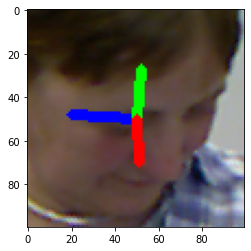

(100, 100, 3)
oPredictedAngles : [ 32.02308   -16.360489    2.3604224]
oLabel : [48.6637, -29.6298, -11.4874]


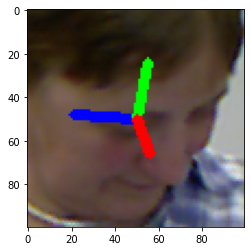

(100, 100, 3)
oPredictedAngles : [ 33.50581   -17.03005     3.2761135]
oLabel : [49.8988, -30.3318, -13.3441]


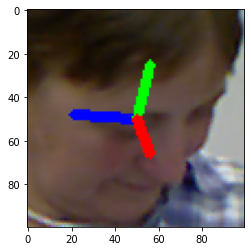

(100, 100, 3)
oPredictedAngles : [ 32.573402  -21.191528    6.5468125]
oLabel : [50.204, -32.4902, -13.643]


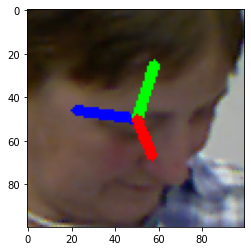

(100, 100, 3)
oPredictedAngles : [ 34.016476 -17.821266   7.376999]
oLabel : [50.4685, -33.6527, -14.0583]


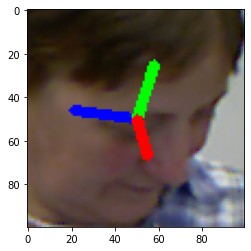

(100, 100, 3)
oPredictedAngles : [ 32.210655 -22.57255    8.540996]
oLabel : [50.1963, -33.9289, -15.8103]


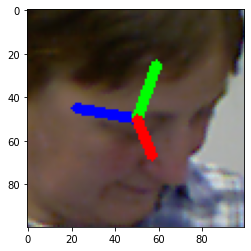

(100, 100, 3)
oPredictedAngles : [ 33.854107 -18.06929    7.516936]
oLabel : [49.4713, -36.1063, -15.1178]


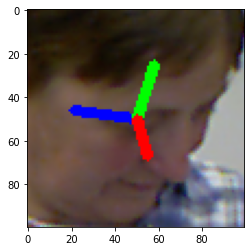

(100, 100, 3)
oPredictedAngles : [ 33.450413  -19.27579     7.5751424]
oLabel : [48.351, -38.0789, -13.7761]


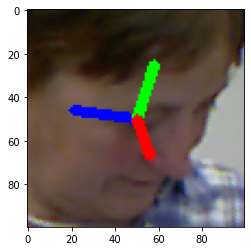

(100, 100, 3)
oPredictedAngles : [ 33.810413 -17.754694   7.68775 ]
oLabel : [49.888, -39.416, -14.4091]


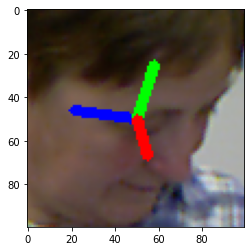

(100, 100, 3)
oPredictedAngles : [ 33.401882  -19.291157    7.2745166]
oLabel : [48.7759, -40.0995, -15.863]


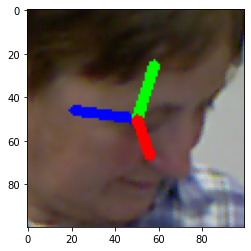

(100, 100, 3)
oPredictedAngles : [ 30.434795 -28.669804   8.688746]
oLabel : [47.6032, -41.8133, -14.0997]


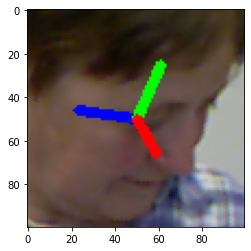

(100, 100, 3)
oPredictedAngles : [ 31.164415 -25.241371   9.035536]
oLabel : [48.5763, -43.1316, -15.4855]


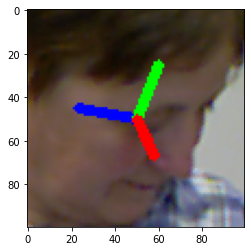

(100, 100, 3)
oPredictedAngles : [ 31.042248 -25.719648   8.835145]
oLabel : [48.4041, -44.3847, -15.9931]


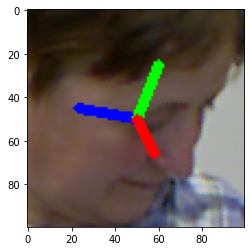

(100, 100, 3)
oPredictedAngles : [ 30.737665 -27.066574   8.817322]
oLabel : [48.5357, -44.8489, -16.3743]


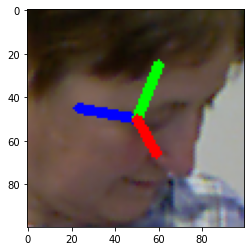

(100, 100, 3)
oPredictedAngles : [ 30.168804 -29.742191   8.931017]
oLabel : [47.7747, -46.3305, -15.063]


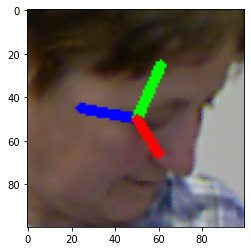

(100, 100, 3)
oPredictedAngles : [ 32.734577 -21.05567    8.081959]
oLabel : [48.2484, -47.3292, -14.8948]


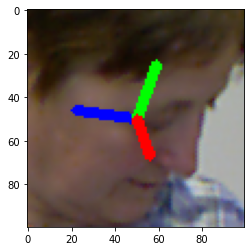

(100, 100, 3)
oPredictedAngles : [ 28.93469  -33.240532  10.716743]
oLabel : [48.3278, -47.8547, -15.7519]


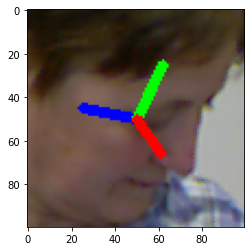

(100, 100, 3)
oPredictedAngles : [ 28.73455  -33.97968   10.867668]
oLabel : [47.9835, -48.4424, -16.1815]


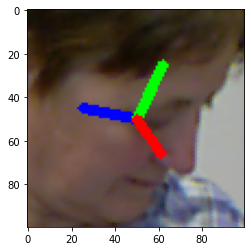

(100, 100, 3)
oPredictedAngles : [ 28.69819  -34.108955  10.942582]
oLabel : [46.9045, -49.8172, -14.4313]


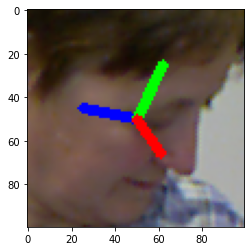

(100, 100, 3)
oPredictedAngles : [ 28.607925 -34.240055  11.139934]
oLabel : [46.083, -50.2456, -15.0864]


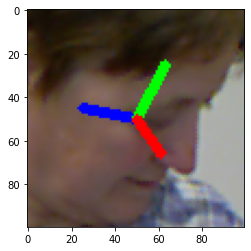

(100, 100, 3)
oPredictedAngles : [ 28.665112 -34.42304   11.141715]
oLabel : [46.0072, -53.2165, -13.3216]


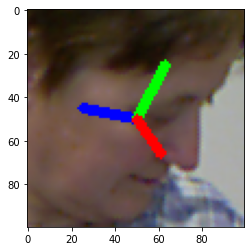

(100, 100, 3)
oPredictedAngles : [ 28.590673 -34.251698  11.135456]
oLabel : [46.8029, -53.8054, -14.8628]


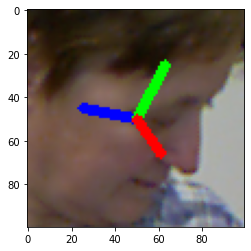

(100, 100, 3)
oPredictedAngles : [ 28.603285 -34.29725   11.202463]
oLabel : [47.2722, -55.9619, -15.0288]


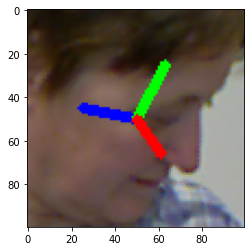

(100, 100, 3)
oPredictedAngles : [ 28.61132  -34.334347  11.318872]
oLabel : [46.1349, -56.8262, -15.299]


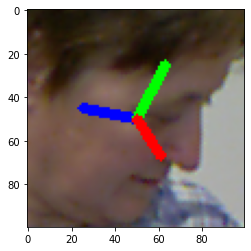

(100, 100, 3)
oPredictedAngles : [ 28.607182 -34.324688  11.319022]
oLabel : [45.6951, -56.5546, -15.8082]


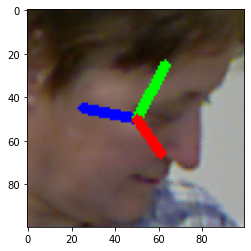

(100, 100, 3)
oPredictedAngles : [ 28.734793 -34.57543   12.150427]
oLabel : [43.1439, -58.3568, -12.9475]


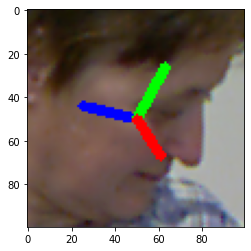

(100, 100, 3)
oPredictedAngles : [ 29.014439 -34.968006  14.148914]
oLabel : [42.8092, -60.1409, -12.6267]


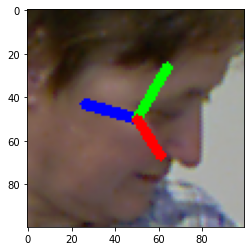

(100, 100, 3)
oPredictedAngles : [ 29.046478 -35.089256  14.142767]
oLabel : [44.5661, -60.4438, -14.3061]


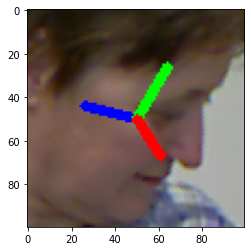

(100, 100, 3)
oPredictedAngles : [ 29.39994  -35.523346  16.482239]
oLabel : [43.7422, -61.008, -13.6878]


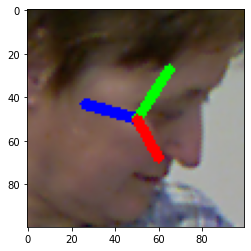

(100, 100, 3)
oPredictedAngles : [ 28.809082  -34.634834   12.7883835]
oLabel : [43.0495, -62.3647, -12.0967]


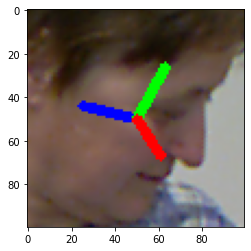

(100, 100, 3)
oPredictedAngles : [ 29.32799  -35.375256  15.770626]
oLabel : [44.5404, -61.099, -14.2667]


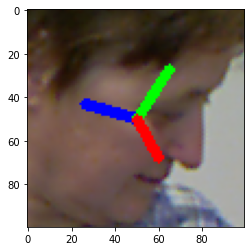

(100, 100, 3)
oPredictedAngles : [ 29.299904 -35.445335  15.932615]
oLabel : [43.7489, -61.5489, -13.947]


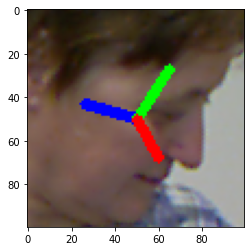

(100, 100, 3)
oPredictedAngles : [ 28.757305 -34.723602  12.592114]
oLabel : [41.2311, -62.4794, -9.62938]


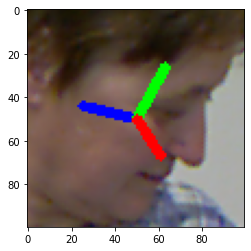

(100, 100, 3)
oPredictedAngles : [ 28.991028 -34.93516   13.92567 ]
oLabel : [43.881, -60.9905, -13.5321]


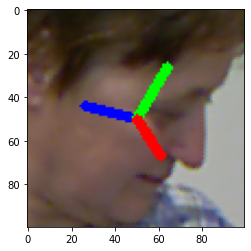

(100, 100, 3)
oPredictedAngles : [ 29.398817 -35.60631   16.765858]
oLabel : [43.6592, -60.6817, -14.6067]


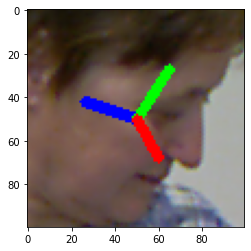

(100, 100, 3)
oPredictedAngles : [ 29.39712  -35.65944   17.170807]
oLabel : [43.3027, -60.6948, -15.1761]


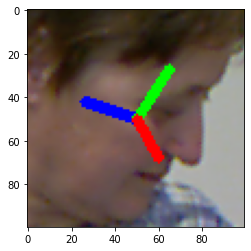

(100, 100, 3)
oPredictedAngles : [ 29.380676 -35.753647  17.195097]
oLabel : [43.0945, -61.8195, -13.2744]


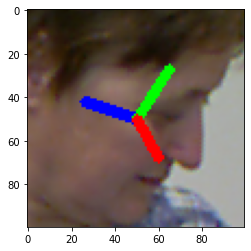

(100, 100, 3)
oPredictedAngles : [ 29.24349  -35.414402  15.716083]
oLabel : [42.0773, -61.1946, -12.7518]


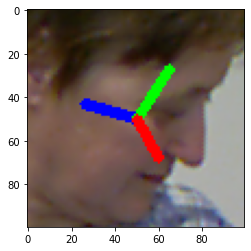

(100, 100, 3)
oPredictedAngles : [ 28.788786 -34.961674  13.993802]
oLabel : [40.5805, -61.9485, -11.2797]


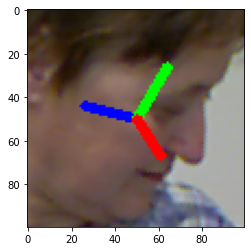

(100, 100, 3)
oPredictedAngles : [ 29.192087 -35.600964  16.915615]
oLabel : [44.3351, -61.5501, -14.7468]


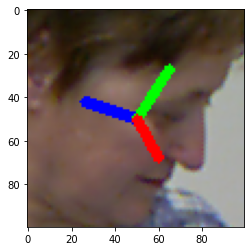

(100, 100, 3)
oPredictedAngles : [ 29.249691 -35.26326   15.391257]
oLabel : [42.4151, -61.8612, -13.2262]


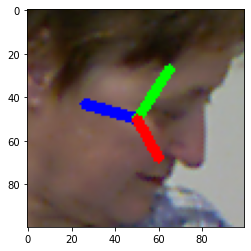

(100, 100, 3)
oPredictedAngles : [ 29.339241 -35.545086  16.441101]
oLabel : [42.7476, -61.8202, -13.4563]


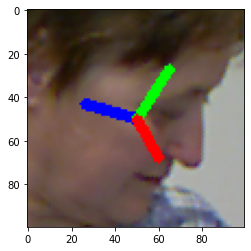

(100, 100, 3)
oPredictedAngles : [ 28.784462 -35.62461   16.307877]
oLabel : [41.5035, -62.0639, -12.8017]


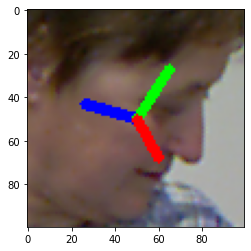

(100, 100, 3)
oPredictedAngles : [ 1.6396737   2.8547688  -0.43481192]
oLabel : [11.6965, 8.35662, -2.55783]


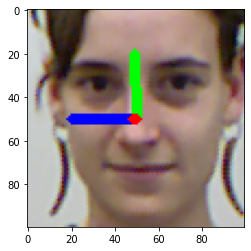

(100, 100, 3)
oPredictedAngles : [-1.361904   4.037406   1.1130626]
oLabel : [11.962, 8.47953, -2.73938]


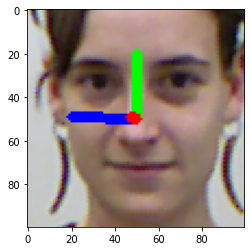

(100, 100, 3)
oPredictedAngles : [-1.2268165  3.9825716  1.0430361]
oLabel : [11.8995, 8.17153, -2.95306]


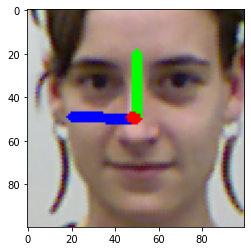

(100, 100, 3)
oPredictedAngles : [ 1.4902736   2.9143026  -0.35691702]
oLabel : [12.0779, 8.19722, -2.7565]


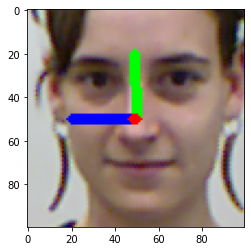

(100, 100, 3)
oPredictedAngles : [-1.372023   4.033893   1.1164231]
oLabel : [11.8486, 8.27098, -2.24821]


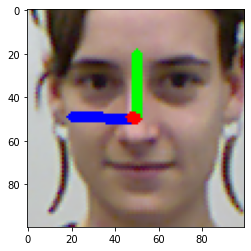

(100, 100, 3)
oPredictedAngles : [-1.2979497  4.0095315  1.0794342]
oLabel : [12.1069, 8.91726, -2.63107]


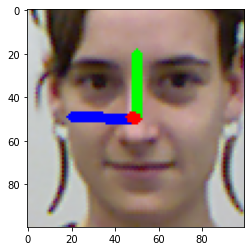

(100, 100, 3)
oPredictedAngles : [-1.3617401  4.000959   1.103975 ]
oLabel : [11.9105, 8.46777, -2.2133]


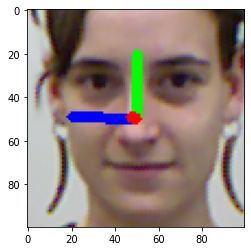

(100, 100, 3)
oPredictedAngles : [-1.3805231  4.0303645  1.1191005]
oLabel : [12.1392, 8.4395, -2.60589]


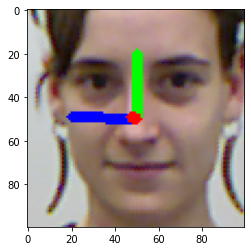

(100, 100, 3)
oPredictedAngles : [-1.3322388  4.00494    1.0926301]
oLabel : [12.0706, 8.82314, -2.23625]


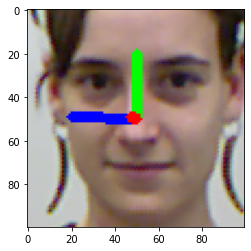

(100, 100, 3)
oPredictedAngles : [-1.3563546  4.031441   1.1092684]
oLabel : [12.0383, 8.69827, -2.46439]


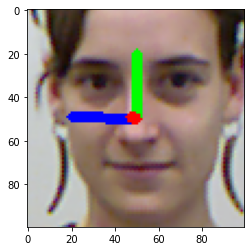

(100, 100, 3)
oPredictedAngles : [-1.4064267  4.051301   1.1351105]
oLabel : [12.0328, 8.73966, -1.55631]


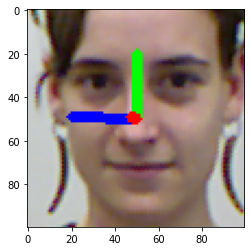

(100, 100, 3)
oPredictedAngles : [ 1.3544894   2.9681585  -0.28683928]
oLabel : [11.8236, 9.03356, -2.23823]


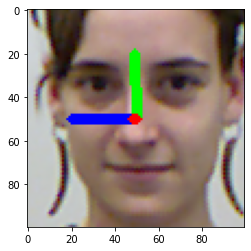

(100, 100, 3)
oPredictedAngles : [0.27856565 3.394902   0.2684414 ]
oLabel : [11.9757, 9.39681, -2.77263]


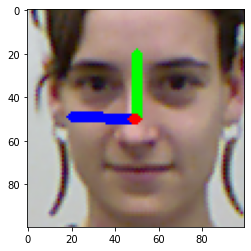

(100, 100, 3)
oPredictedAngles : [-1.4424491  4.0687256  1.1544775]
oLabel : [11.726, 9.18612, -2.81276]


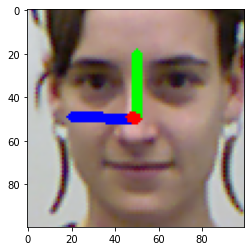

(100, 100, 3)
oPredictedAngles : [-1.4018657  4.0538836  1.1338434]
oLabel : [11.8804, 9.53447, -2.30309]


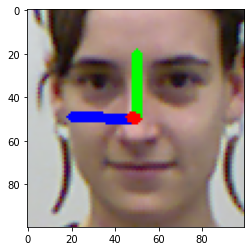

(100, 100, 3)
oPredictedAngles : [-1.3270957  4.0305     1.0968051]
oLabel : [11.8246, 9.64755, -2.53242]


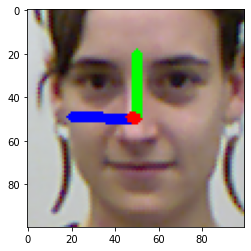

(100, 100, 3)
oPredictedAngles : [-0.6737864  3.772633   0.7599453]
oLabel : [11.7969, 10.2129, -2.66987]


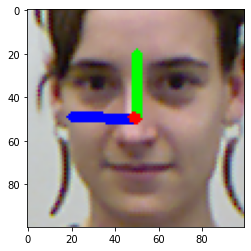

(100, 100, 3)
oPredictedAngles : [-0.489204   3.6994226  0.6646846]
oLabel : [11.4925, 10.8018, -3.12901]


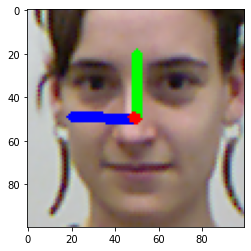

(100, 100, 3)
oPredictedAngles : [-0.9053913  3.8638673  0.8793199]
oLabel : [11.3368, 10.9669, -2.75086]


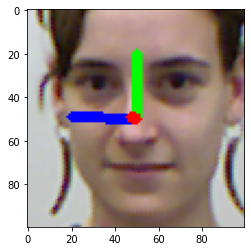

(100, 100, 3)
oPredictedAngles : [-1.0785929   3.9331913   0.96886706]
oLabel : [11.0777, 10.8466, -3.33217]


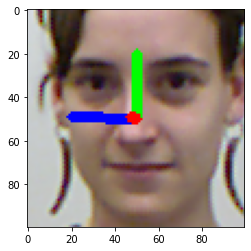

(100, 100, 3)
oPredictedAngles : [-1.1668526  3.9681978  1.0144176]
oLabel : [10.4157, 10.8668, -2.99746]


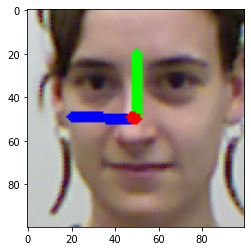

(100, 100, 3)
oPredictedAngles : [-1.1430904  3.958773   1.002154 ]
oLabel : [10.8067, 10.8941, -2.85851]


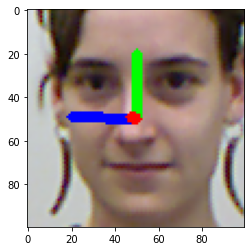

(100, 100, 3)
oPredictedAngles : [-1.1643066  3.9671881  1.0131028]
oLabel : [10.5365, 10.9104, -2.51722]


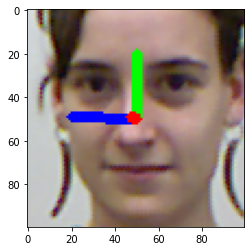

(100, 100, 3)
oPredictedAngles : [-0.98608994  3.896502    0.92112404]
oLabel : [10.5341, 11.2619, -3.05114]


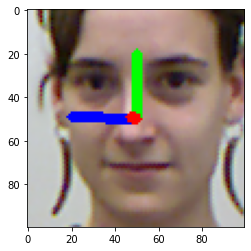

(100, 100, 3)
oPredictedAngles : [-1.3221558  4.0297956  1.0945665]
oLabel : [10.2676, 10.7867, -3.27257]


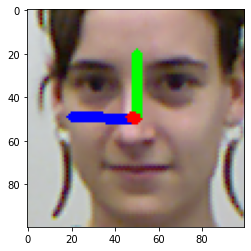

(100, 100, 3)
oPredictedAngles : [-1.2423825  3.9981554  1.0533975]
oLabel : [10.2454, 11.3591, -2.74533]


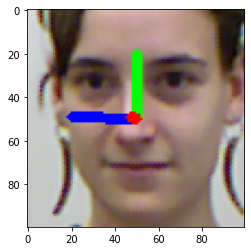

(100, 100, 3)
oPredictedAngles : [-1.2430792  3.9761996  1.0475338]
oLabel : [10.0234, 11.4963, -2.55118]


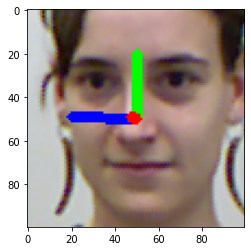

(100, 100, 3)
oPredictedAngles : [-1.3974587  4.0577803  1.1329658]
oLabel : [10.1235, 11.5642, -2.42253]


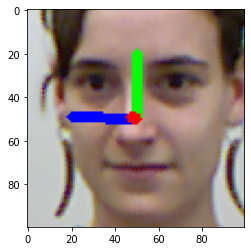

(100, 100, 3)
oPredictedAngles : [-1.4424354  4.0756197  1.1561782]
oLabel : [9.88585, 12.3325, -2.44506]


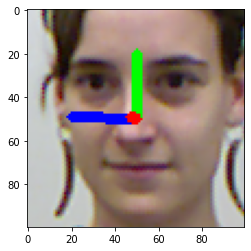

(100, 100, 3)
oPredictedAngles : [-1.5639342  4.047911   1.2000997]
oLabel : [9.6854, 12.5209, -1.63223]


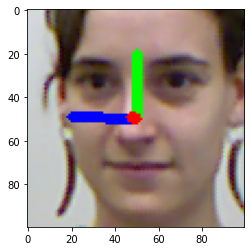

(100, 100, 3)
oPredictedAngles : [-1.4750769  4.0848036  1.1720926]
oLabel : [9.24606, 13.6794, -2.19773]


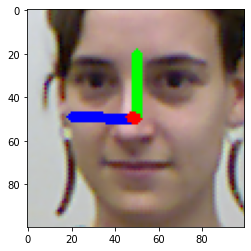

(100, 100, 3)
oPredictedAngles : [-1.4583327  4.0800433  1.1639168]
oLabel : [9.3102, 14.7726, -1.47829]


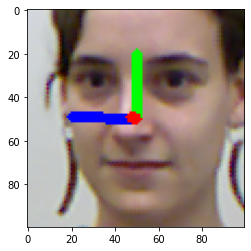

(100, 100, 3)
oPredictedAngles : [-1.4704425  4.086728   1.1706308]
oLabel : [8.91539, 16.1751, -1.02558]


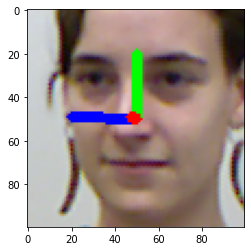

(100, 100, 3)
oPredictedAngles : [-1.4753808  4.087433   1.1728694]
oLabel : [8.22235, 17.7248, -0.673685]


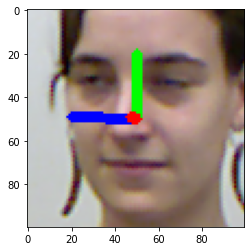

(100, 100, 3)
oPredictedAngles : [-1.4722902  4.088716   1.1718944]
oLabel : [7.33349, 19.2413, -1.54693]


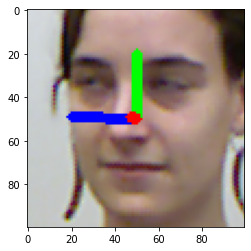

(100, 100, 3)
oPredictedAngles : [-1.4720801  4.092457   1.1699239]
oLabel : [6.42267, 20.9888, -1.21716]


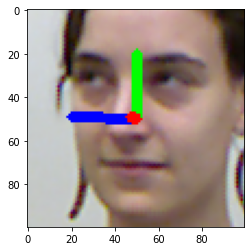

(100, 100, 3)
oPredictedAngles : [-1.4732054  4.0992956  1.1664644]
oLabel : [5.41171, 22.4085, -1.98072]


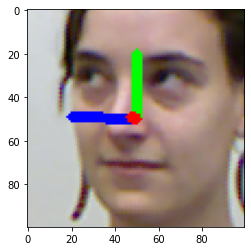

(100, 100, 3)
oPredictedAngles : [-1.6718733   5.306901    0.55587965]
oLabel : [4.13946, 23.8222, -2.11262]


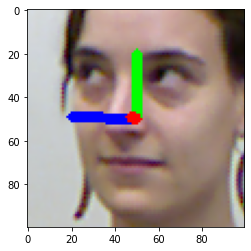

(100, 100, 3)
oPredictedAngles : [-1.8889334   6.6311398  -0.11428479]
oLabel : [2.93029, 25.0788, -1.34151]


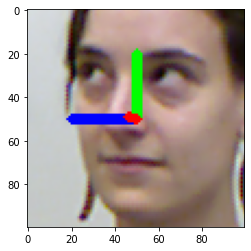

(100, 100, 3)
oPredictedAngles : [-2.2335591  8.721134  -1.1704198]
oLabel : [2.48379, 26.5275, -0.783838]


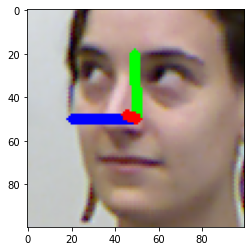

(100, 100, 3)
oPredictedAngles : [-2.2393715  8.756468  -1.1882842]
oLabel : [1.37697, 28.4478, -0.525565]


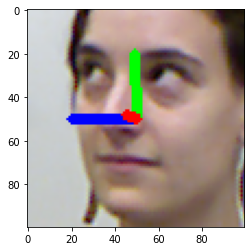

(100, 100, 3)
oPredictedAngles : [-2.2439084  8.760867  -1.1872033]
oLabel : [0.241271, 29.6315, -0.543231]


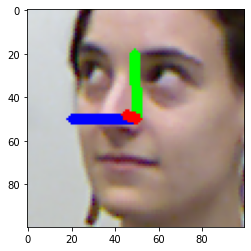

(100, 100, 3)
oPredictedAngles : [-2.4209726  8.890635  -1.1206124]
oLabel : [-0.294409, 30.679, -0.238771]


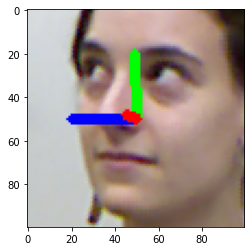

(100, 100, 3)
oPredictedAngles : [-2.567523   9.007325  -1.0653254]
oLabel : [-0.988157, 31.7239, 0.19045]


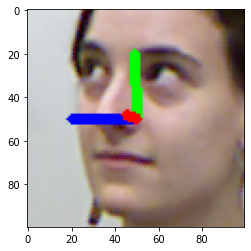

(100, 100, 3)
oPredictedAngles : [-3.545811    9.797687   -0.70026374]
oLabel : [-2.10443, 33.4681, 0.144621]


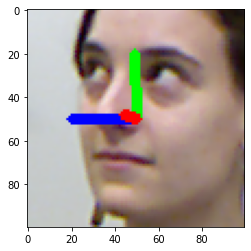

(100, 100, 3)
oPredictedAngles : [-4.504868  10.458208  -0.3253035]
oLabel : [-3.03434, 34.3271, 0.66785]


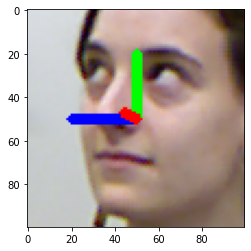

(100, 100, 3)
oPredictedAngles : [-5.626083   11.385894    0.08998738]
oLabel : [-3.75281, 35.228, 1.35274]


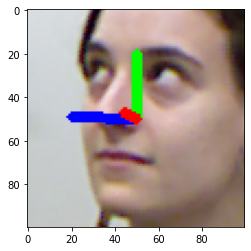

(100, 100, 3)
oPredictedAngles : [-5.8805747  13.12551    -0.03420595]
oLabel : [-5.19686, 35.5195, 1.58201]


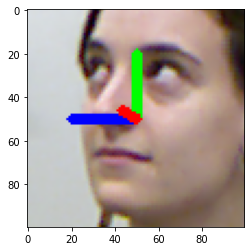

(100, 100, 3)
oPredictedAngles : [-5.8803973  11.704207    0.10429492]
oLabel : [-7.34228, 37.0378, -1.15263]


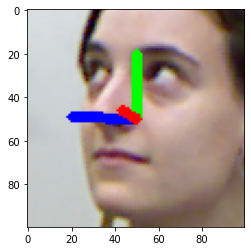

(100, 100, 3)
oPredictedAngles : [-5.989408   11.405978    0.04213849]
oLabel : [-8.65159, 37.6647, -0.55159]


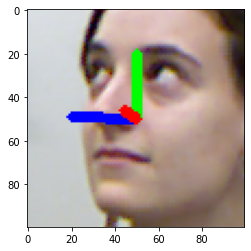

(100, 100, 3)
oPredictedAngles : [-6.245728   18.501911   -0.75065523]
oLabel : [-9.66424, 37.8815, -0.89258]


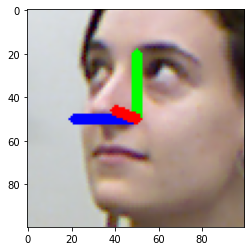

(100, 100, 3)
oPredictedAngles : [-8.379344  14.307744  -1.8851838]
oLabel : [-11.1087, 38.318, -1.39913]


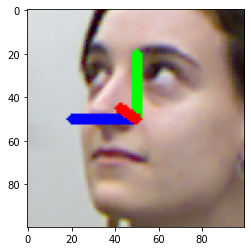

(100, 100, 3)
oPredictedAngles : [-7.6785927 17.177252  -1.7032685]
oLabel : [-11.7636, 38.2255, -0.964688]


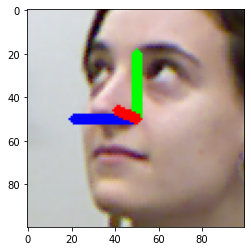

(100, 100, 3)
oPredictedAngles : [-7.203039  18.22545   -1.4250305]
oLabel : [-12.8079, 38.8917, -1.60944]


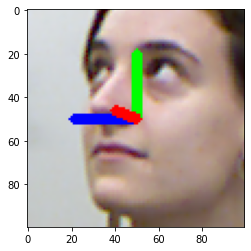

(100, 100, 3)
oPredictedAngles : [-7.5691986 18.113304  -1.6452032]
oLabel : [-14.4799, 38.9511, -2.70749]


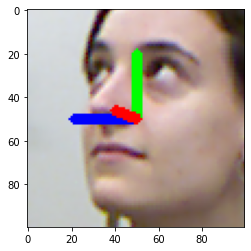

(100, 100, 3)
oPredictedAngles : [-6.7368803 18.38576   -1.0521551]
oLabel : [-15.0611, 39.1997, -2.76454]


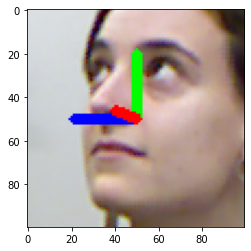

(100, 100, 3)
oPredictedAngles : [-7.314847  18.180103  -1.2846103]
oLabel : [-15.8145, 39.2985, -2.63826]


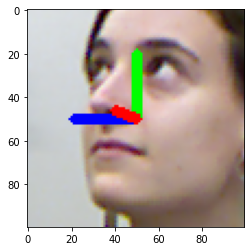

(100, 100, 3)
oPredictedAngles : [-6.9763803 18.28964   -1.0028206]
oLabel : [-16.5747, 39.2253, -3.32267]


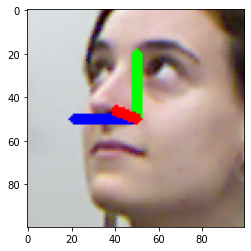

(100, 100, 3)
oPredictedAngles : [-8.979178  17.464375  -0.3369985]
oLabel : [-16.9893, 39.2567, -3.12792]


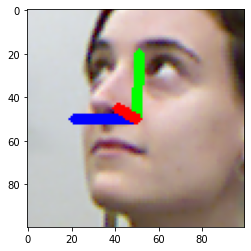

(100, 100, 3)
oPredictedAngles : [-9.178202   17.428204   -0.35330215]
oLabel : [-17.3192, 39.5272, -2.34578]


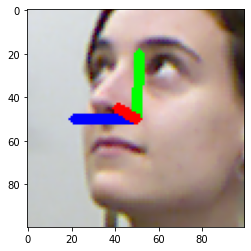

(100, 100, 3)
oPredictedAngles : [-11.734384   16.704817   -0.8420004]
oLabel : [-18.7105, 38.5885, -3.4708]


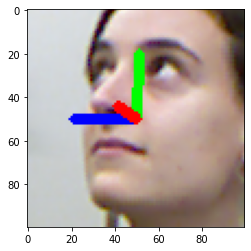

(100, 100, 3)
oPredictedAngles : [-10.805709   16.901608   -0.7078709]
oLabel : [-19.4225, 39.0247, -4.2533]


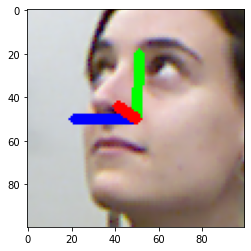

(100, 100, 3)
oPredictedAngles : [-16.235409   16.268799   -1.4676934]
oLabel : [-19.1876, 38.3511, -3.30094]


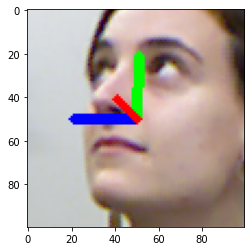

(100, 100, 3)
oPredictedAngles : [-18.972595  16.1021    -1.4743  ]
oLabel : [-19.5865, 38.0729, -3.12763]


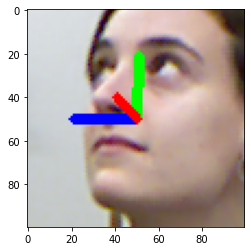

(100, 100, 3)
oPredictedAngles : [-14.8202715  16.516796   -1.313782 ]
oLabel : [-20.4668, 38.1249, -2.79896]


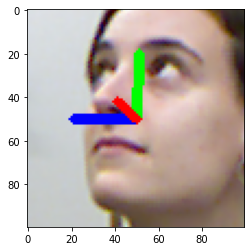

(100, 100, 3)
oPredictedAngles : [-14.911647   16.62564    -1.1057533]
oLabel : [-20.8269, 38.0629, -3.10293]


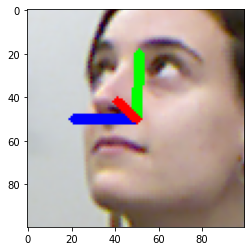

(100, 100, 3)
oPredictedAngles : [-19.084229   16.077757   -1.4237498]
oLabel : [-20.491, 37.4717, -3.8289]


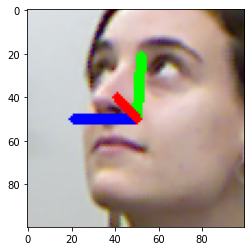

(100, 100, 3)
oPredictedAngles : [-20.885439   15.818952   -1.5626793]
oLabel : [-21.0675, 37.5372, -4.01836]


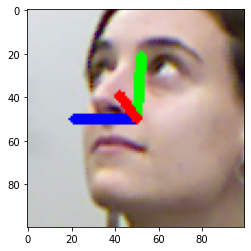

(100, 100, 3)
oPredictedAngles : [-21.637087  15.609579  -1.69985 ]
oLabel : [-21.3694, 37.5991, -5.03078]


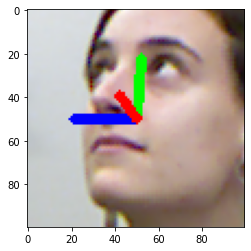

(100, 100, 3)
oPredictedAngles : [-21.641884  15.529331  -1.695921]
oLabel : [-21.8782, 37.1971, -4.68435]


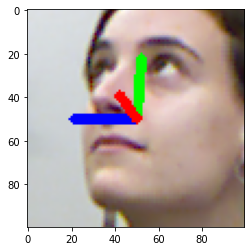

(100, 100, 3)
oPredictedAngles : [-22.271297   15.254963   -1.7442393]
oLabel : [-22.2109, 36.2335, -6.05346]


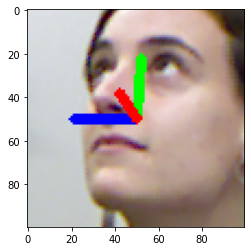

(100, 100, 3)
oPredictedAngles : [-22.287973   15.337434   -2.1730335]
oLabel : [-22.2707, 35.3382, -5.45783]


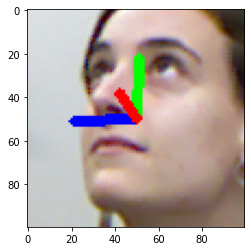

(100, 100, 3)
oPredictedAngles : [-22.008827   14.868174   -1.9833559]
oLabel : [-22.7532, 34.5661, -5.34937]


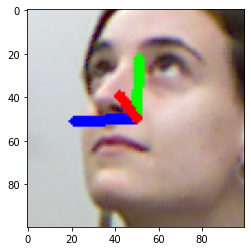

(100, 100, 3)
oPredictedAngles : [-22.300716   14.999679   -1.8470885]
oLabel : [-22.3423, 33.8518, -3.92106]


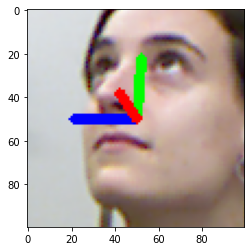

(100, 100, 3)
oPredictedAngles : [-22.32043    15.26558    -1.9809277]
oLabel : [-22.4249, 32.5969, -4.36799]


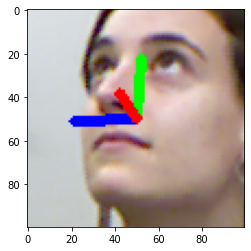

(100, 100, 3)
oPredictedAngles : [-22.309834   15.057945   -1.9363129]
oLabel : [-22.5165, 32.0762, -4.84037]


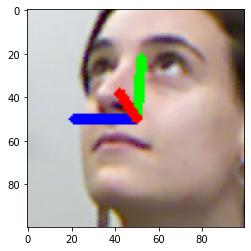

(100, 100, 3)
oPredictedAngles : [-22.325893   15.176528   -1.7532756]
oLabel : [-22.6792, 30.8013, -5.76684]


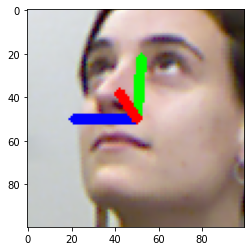

(100, 100, 3)
oPredictedAngles : [-22.087425    9.913249   -1.0952485]
oLabel : [-23.2907, 30.7144, -5.33689]


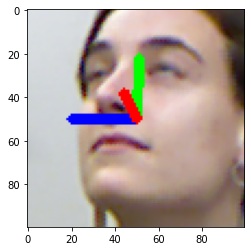

(100, 100, 3)
oPredictedAngles : [-22.2352     9.883977  -1.08424 ]
oLabel : [-22.9421, 29.9196, -5.50198]


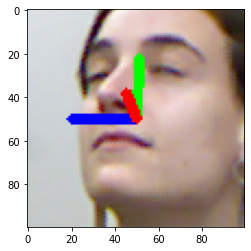

(100, 100, 3)
oPredictedAngles : [-21.902771     8.457656    -0.97332954]
oLabel : [-23.0413, 29.9449, -4.59951]


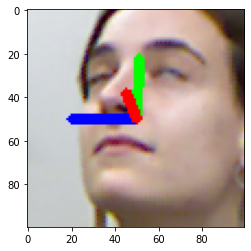

(100, 100, 3)
oPredictedAngles : [-22.029963     8.530408    -0.97795534]
oLabel : [-23.0057, 28.4086, -4.02214]


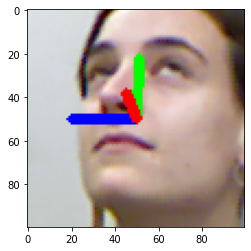

(100, 100, 3)
oPredictedAngles : [-21.993616    8.699687   -0.9973001]
oLabel : [-22.5933, 27.0552, -4.05446]


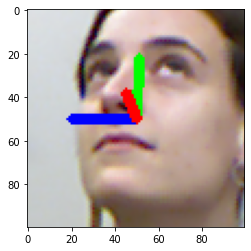

(100, 100, 3)
oPredictedAngles : [-21.980293     8.45292     -0.92045707]
oLabel : [-22.7286, 25.9755, -4.01123]


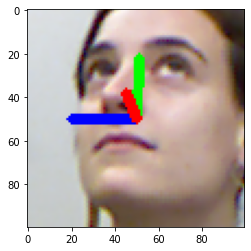

(100, 100, 3)
oPredictedAngles : [-21.98564      8.490013    -0.91361153]
oLabel : [-22.737, 24.5057, -4.2887]


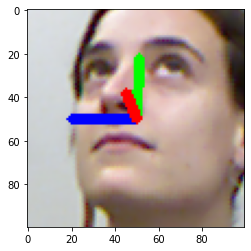

(100, 100, 3)
oPredictedAngles : [-21.991732    8.388932   -0.9065747]
oLabel : [-22.7925, 23.7789, -3.75114]


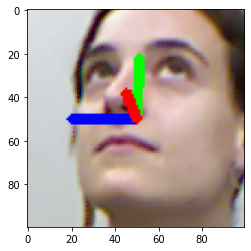

(100, 100, 3)
oPredictedAngles : [-22.00086     8.385799   -0.9152508]
oLabel : [-23.173, 23.1243, -3.40692]


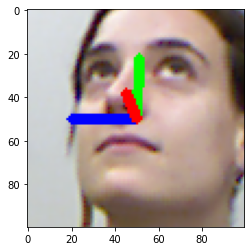

(100, 100, 3)
oPredictedAngles : [-22.52214      8.359137    -0.78811705]
oLabel : [-22.7632, 20.9999, -2.95907]


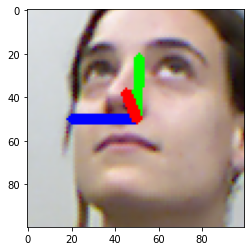

(100, 100, 3)
oPredictedAngles : [-23.962835     7.8471017    0.51892835]
oLabel : [-22.9135, 19.5738, -3.87899]


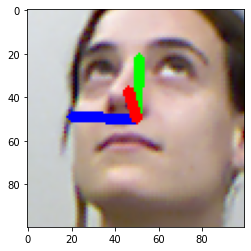

(100, 100, 3)
oPredictedAngles : [-28.930403    7.354232    1.7345467]
oLabel : [-22.9608, 17.4298, -2.80766]


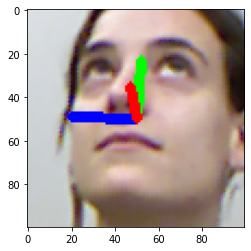

(100, 100, 3)
oPredictedAngles : [-30.478704    7.2113853   1.860053 ]
oLabel : [-22.7574, 17.0448, -1.59824]


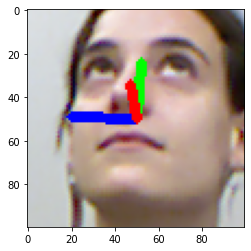

(100, 100, 3)
oPredictedAngles : [-30.461077    7.180931    1.8765087]
oLabel : [-22.655, 15.2903, -1.78281]


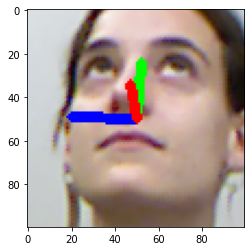

(100, 100, 3)
oPredictedAngles : [-30.500244    7.059449    1.9395666]
oLabel : [-22.6831, 14.7468, -1.43734]


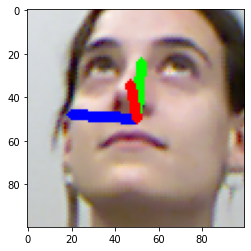

(100, 100, 3)
oPredictedAngles : [-30.604147    7.3778625   1.7799947]
oLabel : [-22.64, 13.1997, -0.442506]


KeyboardInterrupt: 

In [7]:
fourcc = cv2.VideoWriter_fourcc(*'XVID')
out = cv2.VideoWriter('output_prediction.avi', fourcc, 20.0, (100,100))
#load headpose model
oModel = load_hp_model(oModelPath)
for oFileName in oListTestImgFiles:
    #read image and groundtruth
    oImage = cv2.imread(oFileName)
    oImage = cv2.cvtColor(oImage, cv2.COLOR_BGR2RGB)
    print(oImage.shape)
    oImageRshape = np.reshape(oImage,(-1,100,100,3))
    #getlabel file name
    oImageName = oFileName.split("\\")[-1]
    oImageName = oImageName.split(".png")[0]
    oLabelPath = os.path.join(oTestFullImgPath,oImageName+"_angles.txt")
    oLabel = []
    with open(oLabelPath, 'r') as f:
        oLabel = json.loads(f.read())
    #do inference
    oPredictedAngles = headpose_inference(oModel,oImageRshape)
    #display prediction
    print("oPredictedAngles :",oPredictedAngles)
    print("oLabel :",oLabel)
    oGT = [oPredictedAngles[0] * np.pi/180,oPredictedAngles[1] * np.pi/180,oPredictedAngles[2] * np.pi/180]
    oDisplayImage = displayHeadpose(oImage,oGT,oOffset = 0)
    #display ground truth
    #oGT = [oLabel[0] * np.pi/180,oLabel[1] * np.pi/180,oLabel[2] * np.pi/180]
    #oDisplayImage = displayHeadpose(oDisplayImage,oGT,oOffset = 30)
    oImageSave = cv2.cvtColor(oDisplayImage, cv2.COLOR_RGB2BGR)
    cv2.imwrite(oOutDirPath + oImageName +".jpg", oImageSave)
    out.write(oDisplayImage)
    plt.imshow(oDisplayImage)
    plt.show()
out.release()


# Appendix